In [1]:
%matplotlib inline
import tensorflow as tf
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from preparation.data import Data
import h5py
import os
import shutil

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [2]:
def leakyReLU(x, alpha):
    return tf.maximum(alpha*x, x)

In [3]:
# Simple function to plot number images.
def plot_images(plt_num, images, dim):
    # Standard parameters for the plot.
    
    mpl.rcParams["figure.figsize"] = dim, dim
    fig = plt.figure()
    for i in range(0, plt_num):
        fig.add_subplot(1, 10, i+1)
        img = images[i, :, :, :]
        plt.imshow(img)
    plt.show()

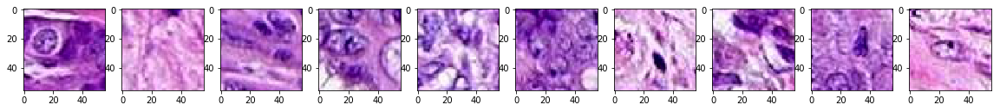

In [4]:
data = Data(dataset='nki', marker='he', patch_h=56, patch_w=56, n_channels=3, batch_size=10)
images, label = data.training.next_batch(10)

plot_images(plt_num=10, images=images, dim=20)

In [5]:
def model_inputs(image_width, image_height, image_channels, z_dim):
    real_images = tf.placeholder(dtype=tf.float32, shape=(None, image_width, image_height, image_channels), name='real_images')
    z_input = tf.placeholder(dtype=tf.float32, shape=(None, z_dim), name='z_input')
    learning_rate = tf.placeholder(dtype=tf.float32, name='learning_rate')
    return real_images, z_input, learning_rate

In [6]:
def discriminator(images, reuse, alpha, use_bn):
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Padding = 'Same' -> H_new = H_old // Stride
        
        # Input Shape = (None, 56, 56, 3)
        
        # Conv.
        net = tf.layers.conv2d(inputs=images, filters=64, kernel_size=(5,5), strides=(2, 2), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = leakyReLU(net, alpha)
        # Shape = (None, 28, 28, 64)
        
         # Conv.
        net = tf.layers.conv2d(inputs=images, filters=64, kernel_size=(5,5), strides=(1, 1), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = leakyReLU(net, alpha)
        # Shape = (None, 28, 28, 64)
        
        # Conv.
        net = tf.layers.conv2d(inputs=net, filters=128, kernel_size=(5,5), strides=(2, 2), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        if use_bn: net = tf.layers.batch_normalization(inputs=net, training=True)
        net = leakyReLU(net, alpha)
        # Shape = (None, 14, 14, 128)
        
        # Conv.
        net = tf.layers.conv2d(inputs=net, filters=128, kernel_size=(5,5), strides=(1, 1), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        if use_bn: net = tf.layers.batch_normalization(inputs=net, training=True)
        net = leakyReLU(net, alpha)
        # Shape = (None, 14, 14, 128)
        
        # Conv.
        net = tf.layers.conv2d(inputs=net, filters=256, kernel_size=(5,5), strides=(2, 2), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        if use_bn: net = tf.layers.batch_normalization(inputs=net, training=True)
        net = leakyReLU(net, alpha)
        # Shape = (None, 7, 7, 256)
        
        # Conv.
        net = tf.layers.conv2d(inputs=net, filters=256, kernel_size=(5,5), strides=(1, 1), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        if use_bn: net = tf.layers.batch_normalization(inputs=net, training=True)
        net = leakyReLU(net, alpha)
        # Shape = (None, 7, 7, 256)

        # Flatten.
        net = tf.layers.flatten(inputs=net)
        # Shape = (None, 7*7*256)

        # Dense.
        net = tf.layers.dense(inputs=net, units=1024, activation=None)
        if use_bn: net = tf.layers.batch_normalization(inputs=net, training=True)
        net = leakyReLU(net, alpha)
        # Shape = (None, 1024)
        
        # Dense
        logits = tf.layers.dense(inputs=net, units=1, activation=None)
        # Shape = (None, 1)
        output = tf.nn.sigmoid(x=logits)
        
        return output, logits

In [7]:
def generator(z_input, out_channel_dim, reuse, is_train, alpha):
    
    with tf.variable_scope('generator', reuse=reuse):
        # Doesn't work ReLU, tried.
        
        # Input Shape = (None, 100)
        
        # Dense.
        net = tf.layers.dense(inputs=z_input, units=1024, activation=None)
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 1024)
        
        # Dense.
        net = tf.layers.dense(net, 256*7*7, activation=None)
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 256*7*7)
        
        # Reshape
        net = tf.reshape(tensor=net, shape=(-1, 7, 7, 256))
        # Shape = (None, 7, 7, 256)
        
        # Conv.
        net = tf.layers.conv2d_transpose(inputs=net, filters=256, kernel_size=(5,5), strides=(2,2), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 14, 14, 256)
        
        # Conv.
        net = tf.layers.conv2d_transpose(inputs=net, filters=128, kernel_size=(5,5), strides=(1,1), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 14, 14, 128)
        
        # Conv.
        net = tf.layers.conv2d_transpose(inputs=net, filters=128, kernel_size=(5,5), strides=(2,2), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 28, 28, 128)
        
        # Conv.
        net = tf.layers.conv2d_transpose(inputs=net, filters=128, kernel_size=(5,5), strides=(1,1), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 28, 28, 128)
        
        # Conv.
        net = tf.layers.conv2d_transpose(inputs=net, filters=64, kernel_size=(5,5), strides=(2,2), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        net = tf.layers.batch_normalization(inputs=net, training=is_train)
        net = leakyReLU(net, alpha)
        # Shape = (None, 56, 56, 64)
        
        logits = tf.layers.conv2d_transpose(inputs=net, filters=out_channel_dim, kernel_size=(5,5), strides=(1,1), padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        # Shape = (None, 56, 56, 3)
        output = tf.nn.sigmoid(x=logits)
        
        return output

In [8]:
def show_generated(session, output_fake, n_images, z_input):
    z_dim = z_input.get_shape()[-1]
    sample_z = np.random.uniform(low=-1., high=1., size=(n_images, z_dim))
    feed_dict = {z_input:sample_z}
    gen_samples = session.run(output_fake, feed_dict=feed_dict)
    plot_images(plt_num=n_images, images=gen_samples, dim=20)    
    return gen_samples, sample_z

In [9]:
def save_loss(losses, data_out_path, dim):    
    mpl.rcParams["figure.figsize"] = dim, dim
    plt.rcParams.update({'font.size': 22})
    losses = np.array(losses)
    plt.plot(losses[:, 0], label='Discriminator', alpha=0.5)
    plt.plot(losses[:, 1], label='Generator', alpha=0.5)
    plt.title("Training Losses")
    plt.legend()
    plt.savefig('%s/training_loss.png' % data_out_path)

In [10]:
def setup_output(show_epochs, epochs, data, n_images, image_height, image_width, image_channels, z_dim, data_out_path):
    checkpoints_path = os.path.join(data_out_path, 'checkpoints')
    checkpoints = os.path.join(checkpoints_path, 'DCGAN.ckt')
    gen_images_path = os.path.join(data_out_path, 'images')
    gen_images = os.path.join(gen_images_path, 'gen_images.h5')
    latent_images = os.path.join(gen_images_path, 'latent_images.h5')
    if os.path.isdir(checkpoints_path):
         shutil.rmtree(checkpoints_path)
    if os.path.isdir(gen_images_path):
         shutil.rmtree(gen_images_path)
    os.makedirs(checkpoints_path)
    os.makedirs(gen_images_path)

    size_img = (epochs*data.training.iterations)//show_epochs
    img_db_shape = (size_img, n_images, image_height, image_width, image_channels)
    latent_db_shape = (size_img, n_images, z_dim)
    hdf5_gen = h5py.File(gen_images, mode='w')
    hdf5_latent = h5py.File(latent_images, mode='w')
    img_storage = hdf5_gen.create_dataset(name='generated_img', shape=img_db_shape, dtype=np.float32)
    latent_storage = hdf5_latent.create_dataset(name='generated_img', shape=latent_db_shape, dtype=np.float32)
    return img_storage, latent_storage, checkpoints

In [11]:
def loss(real_images, z_input, out_channel_dim, alpha, batch_size, gp_coeff, use_bn):
    
    # Generator.
    fake_images = generator(z_input, out_channel_dim=out_channel_dim, reuse=False, is_train=True, alpha=alpha)
    
    # Discriminator.
    output_fake, logits_fake = discriminator(fake_images, False, alpha, use_bn) 
    output_real, logits_real = discriminator(real_images, True, alpha, use_bn)
    
    # Calculating X hat.
    epsilon = tf.random.uniform(shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0, dtype=tf.float32, name='epsilon')
    x_gp = real_images*(1-epsilon) + fake_images*epsilon
    output_gp, logits_gp = discriminator(x_gp, True, alpha, use_bn)
    
    # Calculating Gradient Penalty.
    grad_gp = tf.gradients(logits_gp, x_gp)
    l2_grad_gp = tf.sqrt(tf.reduce_sum(tf.square(grad_gp), axis=[1, 2, 3]))
    grad_penalty= tf.reduce_sum(tf.square(l2_grad_gp-1.0))
    
    # Discriminator loss.
    loss_dis_real = tf.reduce_mean(logits_real)
    loss_dis_fake = tf.reduce_mean(logits_fake)
    loss_dis = (-loss_dis_real + loss_dis_fake) + (gp_coeff*grad_penalty)

    # Generator loss.
    # This is where we implement -log[D(G(z))] instead log[1-D(G(z))].
    # Recall the implementation of cross-entropy, sign already in. 
    loss_gen = -loss_dis_fake
    
    return loss_dis, loss_gen

In [12]:
def optimization(loss_dis, loss_gen, learning_rate, beta_1, beta_2):
    trainable_variables = tf.trainable_variables()
    generator_variables = [variable for variable in trainable_variables if variable.name.startswith('generator')]
    discriminator_variables = [variable for variable in trainable_variables if variable.name.startswith('discriminator')]
    
    # Handling Batch Normalization.
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        train_discriminator = tf.train.AdamOptimizer(learning_rate, beta_1, beta_2).minimize(loss_dis, var_list=discriminator_variables)
        train_generator = tf.train.AdamOptimizer(learning_rate, beta_1, beta_2).minimize(loss_gen, var_list=generator_variables)
        
    return train_generator, train_discriminator

In [13]:
def train(epochs, batch_size, z_dim, learning_rate, data, alpha, image_width, image_height, image_channels, data_out_path, beta_1, beta_2, n_critic, gp_coeff, use_bn):
    # Inputs.    
    real_images, z_input, learning_rate_input = model_inputs(image_width=image_width, image_height=image_height, image_channels=image_channels, z_dim=z_dim)
    # Loss.
    loss_dis, loss_gen = loss(real_images=real_images, z_input=z_input, out_channel_dim=image_channels, alpha=alpha, batch_size=batch_size, gp_coeff=gp_coeff, use_bn=use_bn)
    # Optimizer.s
    train_generator, train_discriminator = optimization(loss_dis=loss_dis, loss_gen=loss_gen, learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2)
    # Sampling generator.
    output_gen = generator(z_input=z_input, out_channel_dim=image_channels, reuse=True, is_train=False, alpha=alpha)

    global losses 
    global samples 
    
    run_epochs = 0    
    show_epochs = 100
    print_epochs = 10
    n_images = 10
        
    losses = list()
    samples = list()

    saver = tf.train.Saver()
    
    img_storage, latent_storage, checkpoints = setup_output(show_epochs, epochs, data, n_images, image_height, image_width, image_channels, z_dim, data_out_path)
    
    with tf.Session() as session:
        session.run(tf.global_variables_initializer())
        for epoch in range(1, epochs+1):
            for batch_images, batch_labels in data.training:
                z_batch = np.random.uniform(low=-1., high=1., size=(batch_size, z_dim))
                feed_dict = {z_input:z_batch, real_images:batch_images, learning_rate_input: learning_rate}
                
                # Update critic and clip gradients.
                session.run(train_discriminator, feed_dict=feed_dict)
                
                # Update generator after n_critic updates from discriminator.
                if run_epochs%n_critic :
                    session.run(train_generator, feed_dict=feed_dict)
               
                # Print losses and Generate samples.
                if run_epochs%print_epochs==0:
                    feed_dict = {z_input:z_batch, real_images:batch_images}
                    epoch_loss_dis = session.run(loss_dis, feed_dict=feed_dict)
                    epoch_loss_gen = session.run(loss_gen, feed_dict=feed_dict)
                    losses.append((epoch_loss_dis, epoch_loss_gen))
                    print('Epochs %s/%s: Generator Loss: %s. Discriminator Loss: %s' % (epoch, epochs, np.round(epoch_loss_gen, 4), np.round(epoch_loss_dis, 4)))
                if run_epochs%show_epochs == 0:
                    gen_samples, sample_z = show_generated(session=session, output_fake=output_gen, n_images=n_images, z_input=z_input)
                    img_storage[run_epochs//show_epochs] = gen_samples
                    latent_storage[run_epochs//show_epochs] = sample_z
                    saver.save(sess = session, save_path=checkpoints, global_step=run_epochs)
                
                run_epochs += 1
            data.training.reset()

Epochs 1/5: Generator Loss: -1.027. Discriminator Loss: -0.0446


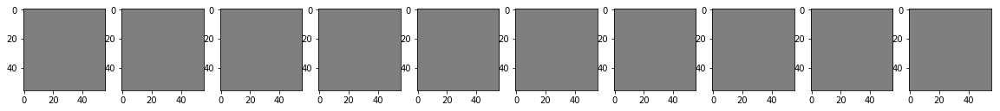

Epochs 1/5: Generator Loss: -9.2149. Discriminator Loss: -4.6464
Epochs 1/5: Generator Loss: -12.5414. Discriminator Loss: -3.2321
Epochs 1/5: Generator Loss: -5.1139. Discriminator Loss: -2.3712
Epochs 1/5: Generator Loss: -1.6679. Discriminator Loss: -2.7484
Epochs 1/5: Generator Loss: -5.6526. Discriminator Loss: -2.3514
Epochs 1/5: Generator Loss: 3.3217. Discriminator Loss: -2.5497
Epochs 1/5: Generator Loss: -2.2657. Discriminator Loss: -3.4008
Epochs 1/5: Generator Loss: 2.8706. Discriminator Loss: -2.9195
Epochs 1/5: Generator Loss: -2.6841. Discriminator Loss: -1.7938
Epochs 1/5: Generator Loss: 2.1975. Discriminator Loss: -2.0503


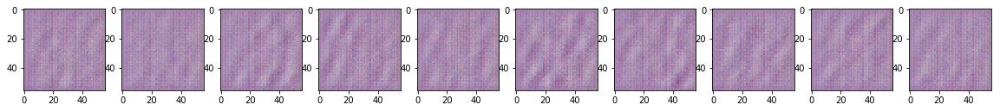

Epochs 1/5: Generator Loss: 2.8553. Discriminator Loss: -2.0585
Epochs 1/5: Generator Loss: 1.0857. Discriminator Loss: -1.2027
Epochs 1/5: Generator Loss: 0.5187. Discriminator Loss: -1.2832
Epochs 1/5: Generator Loss: 4.1943. Discriminator Loss: -1.1212
Epochs 1/5: Generator Loss: 0.6166. Discriminator Loss: -1.2687
Epochs 1/5: Generator Loss: -1.2899. Discriminator Loss: -1.1004
Epochs 1/5: Generator Loss: -2.9281. Discriminator Loss: -1.2191
Epochs 1/5: Generator Loss: -1.0454. Discriminator Loss: -1.2813
Epochs 1/5: Generator Loss: 0.4214. Discriminator Loss: -1.1634
Epochs 1/5: Generator Loss: 1.3525. Discriminator Loss: -1.0694


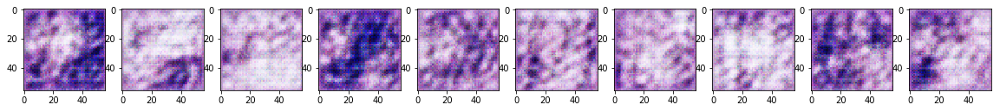

Epochs 1/5: Generator Loss: -2.3606. Discriminator Loss: -1.1347
Epochs 1/5: Generator Loss: -1.6734. Discriminator Loss: -1.0857
Epochs 1/5: Generator Loss: -1.3347. Discriminator Loss: -1.1802
Epochs 1/5: Generator Loss: 0.6728. Discriminator Loss: -0.8848
Epochs 1/5: Generator Loss: -3.0174. Discriminator Loss: -0.9437
Epochs 1/5: Generator Loss: 1.7413. Discriminator Loss: -0.865
Epochs 1/5: Generator Loss: -0.5737. Discriminator Loss: -0.9409
Epochs 1/5: Generator Loss: -5.4015. Discriminator Loss: -1.0398
Epochs 1/5: Generator Loss: -7.6029. Discriminator Loss: -0.9488
Epochs 1/5: Generator Loss: -4.3436. Discriminator Loss: -0.611


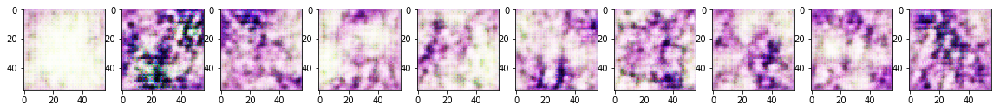

Epochs 1/5: Generator Loss: 1.971. Discriminator Loss: -0.938
Epochs 1/5: Generator Loss: 2.0956. Discriminator Loss: -0.6161
Epochs 1/5: Generator Loss: 1.2688. Discriminator Loss: -0.6726
Epochs 1/5: Generator Loss: -1.5708. Discriminator Loss: -0.7091
Epochs 1/5: Generator Loss: -5.0209. Discriminator Loss: -0.6958
Epochs 1/5: Generator Loss: 4.8413. Discriminator Loss: -0.7743
Epochs 1/5: Generator Loss: -1.0839. Discriminator Loss: -0.7083
Epochs 1/5: Generator Loss: -1.497. Discriminator Loss: -0.6048
Epochs 1/5: Generator Loss: -1.6059. Discriminator Loss: -0.6358
Epochs 1/5: Generator Loss: 1.7858. Discriminator Loss: -0.6223


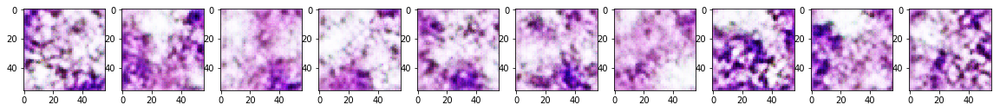

Epochs 1/5: Generator Loss: -3.5425. Discriminator Loss: -0.5693
Epochs 1/5: Generator Loss: -11.8935. Discriminator Loss: -0.6392
Epochs 1/5: Generator Loss: 6.3423. Discriminator Loss: -0.5392
Epochs 1/5: Generator Loss: -0.0889. Discriminator Loss: -0.5243
Epochs 1/5: Generator Loss: -5.0856. Discriminator Loss: -0.4412
Epochs 1/5: Generator Loss: 1.2305. Discriminator Loss: -0.4345
Epochs 1/5: Generator Loss: -0.2836. Discriminator Loss: -0.4737
Epochs 1/5: Generator Loss: 0.921. Discriminator Loss: -0.3832
Epochs 1/5: Generator Loss: -1.8498. Discriminator Loss: -0.443
Epochs 1/5: Generator Loss: -3.2475. Discriminator Loss: -0.372


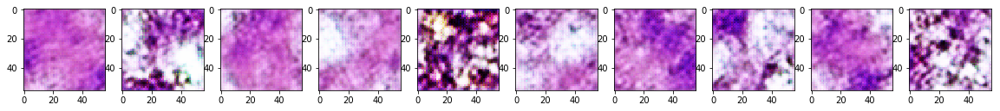

Epochs 1/5: Generator Loss: -1.2049. Discriminator Loss: -0.4958
Epochs 1/5: Generator Loss: -5.5091. Discriminator Loss: -0.462
Epochs 1/5: Generator Loss: 4.6379. Discriminator Loss: -0.4324
Epochs 1/5: Generator Loss: 2.6304. Discriminator Loss: -0.3077
Epochs 1/5: Generator Loss: -5.1158. Discriminator Loss: -0.4608
Epochs 1/5: Generator Loss: 1.214. Discriminator Loss: -0.4293
Epochs 1/5: Generator Loss: -1.7587. Discriminator Loss: -0.4154
Epochs 1/5: Generator Loss: 0.1501. Discriminator Loss: -0.3663
Epochs 1/5: Generator Loss: -2.5682. Discriminator Loss: -0.3092
Epochs 1/5: Generator Loss: -1.3361. Discriminator Loss: -0.3803


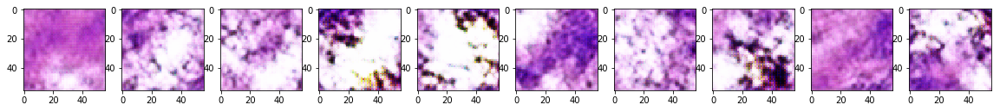

Epochs 1/5: Generator Loss: -0.1963. Discriminator Loss: -0.3465
Epochs 1/5: Generator Loss: -1.3853. Discriminator Loss: -0.344
Epochs 1/5: Generator Loss: 3.3731. Discriminator Loss: -0.4997
Epochs 1/5: Generator Loss: -3.7178. Discriminator Loss: -0.3929
Epochs 1/5: Generator Loss: -2.4882. Discriminator Loss: -0.5055
Epochs 1/5: Generator Loss: -0.3408. Discriminator Loss: -0.3511
Epochs 1/5: Generator Loss: 0.0819. Discriminator Loss: -0.377
Epochs 1/5: Generator Loss: -3.5767. Discriminator Loss: -0.2034
Epochs 1/5: Generator Loss: -0.7813. Discriminator Loss: -0.3473
Epochs 1/5: Generator Loss: -0.6716. Discriminator Loss: -0.4019


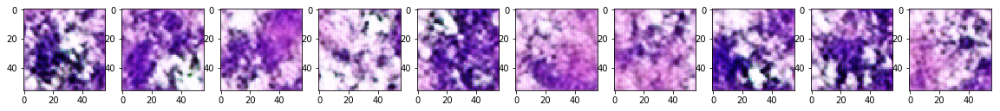

Epochs 1/5: Generator Loss: 0.4808. Discriminator Loss: -0.3548
Epochs 1/5: Generator Loss: -1.799. Discriminator Loss: -0.4022
Epochs 1/5: Generator Loss: 7.9234. Discriminator Loss: -0.4583
Epochs 1/5: Generator Loss: -2.8655. Discriminator Loss: -0.4159
Epochs 1/5: Generator Loss: -4.0725. Discriminator Loss: -0.4086
Epochs 1/5: Generator Loss: -0.4321. Discriminator Loss: -0.3493
Epochs 1/5: Generator Loss: -1.6245. Discriminator Loss: -0.3728
Epochs 1/5: Generator Loss: -4.7522. Discriminator Loss: -0.3629
Epochs 1/5: Generator Loss: -3.5882. Discriminator Loss: -0.3527
Epochs 1/5: Generator Loss: -0.9018. Discriminator Loss: -0.3265


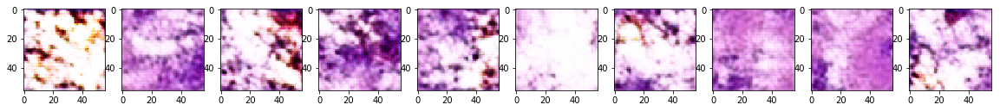

Epochs 1/5: Generator Loss: 0.7418. Discriminator Loss: -0.2985
Epochs 1/5: Generator Loss: -1.4556. Discriminator Loss: -0.3741
Epochs 1/5: Generator Loss: 0.4965. Discriminator Loss: -0.2535
Epochs 1/5: Generator Loss: 0.9996. Discriminator Loss: -0.262
Epochs 1/5: Generator Loss: -8.7826. Discriminator Loss: -0.4594
Epochs 1/5: Generator Loss: 5.8077. Discriminator Loss: -0.3569
Epochs 1/5: Generator Loss: -5.9298. Discriminator Loss: -0.2572
Epochs 1/5: Generator Loss: 3.0819. Discriminator Loss: -0.2091
Epochs 1/5: Generator Loss: -1.2185. Discriminator Loss: -0.2377
Epochs 1/5: Generator Loss: -2.1636. Discriminator Loss: -0.3889


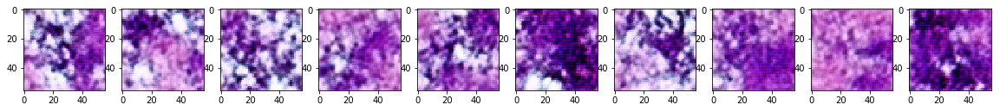

Epochs 1/5: Generator Loss: -3.3162. Discriminator Loss: -0.2454
Epochs 1/5: Generator Loss: 5.5444. Discriminator Loss: -0.3437
Epochs 1/5: Generator Loss: -1.7296. Discriminator Loss: -0.3142
Epochs 1/5: Generator Loss: -3.7232. Discriminator Loss: -0.1988
Epochs 1/5: Generator Loss: 2.9515. Discriminator Loss: -0.2918
Epochs 1/5: Generator Loss: -3.1861. Discriminator Loss: -0.2567
Epochs 1/5: Generator Loss: 0.6671. Discriminator Loss: -0.2993
Epochs 1/5: Generator Loss: -3.5396. Discriminator Loss: -0.3269
Epochs 1/5: Generator Loss: 1.4732. Discriminator Loss: -0.2409
Epochs 1/5: Generator Loss: -0.9062. Discriminator Loss: -0.3468


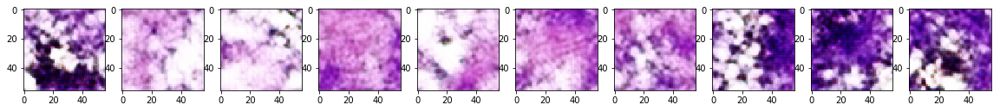

Epochs 1/5: Generator Loss: 1.5258. Discriminator Loss: -0.3334
Epochs 1/5: Generator Loss: -3.877. Discriminator Loss: -0.2548
Epochs 1/5: Generator Loss: 1.4979. Discriminator Loss: -0.4916
Epochs 1/5: Generator Loss: 1.7558. Discriminator Loss: -0.0835
Epochs 1/5: Generator Loss: -4.8952. Discriminator Loss: -0.3992
Epochs 1/5: Generator Loss: 1.595. Discriminator Loss: -0.035
Epochs 1/5: Generator Loss: -0.708. Discriminator Loss: -0.1648
Epochs 1/5: Generator Loss: 0.6441. Discriminator Loss: -0.1352
Epochs 1/5: Generator Loss: -4.43. Discriminator Loss: -0.2074
Epochs 1/5: Generator Loss: 2.7049. Discriminator Loss: -0.2252


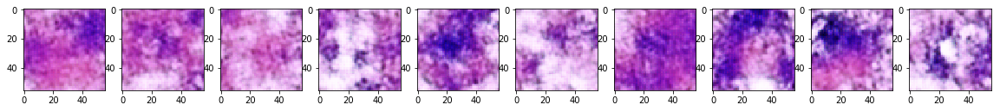

Epochs 1/5: Generator Loss: 1.199. Discriminator Loss: -0.2746
Epochs 1/5: Generator Loss: -5.1566. Discriminator Loss: -0.2934
Epochs 1/5: Generator Loss: 2.8346. Discriminator Loss: -0.2904
Epochs 1/5: Generator Loss: -2.8067. Discriminator Loss: -0.2939
Epochs 1/5: Generator Loss: -3.4861. Discriminator Loss: -0.3248
Epochs 1/5: Generator Loss: 4.3399. Discriminator Loss: -0.3134
Epochs 1/5: Generator Loss: -1.5315. Discriminator Loss: -0.3176
Epochs 1/5: Generator Loss: -1.6355. Discriminator Loss: -0.2597
Epochs 1/5: Generator Loss: -1.2113. Discriminator Loss: -0.2167
Epochs 1/5: Generator Loss: -7.4896. Discriminator Loss: -0.1551


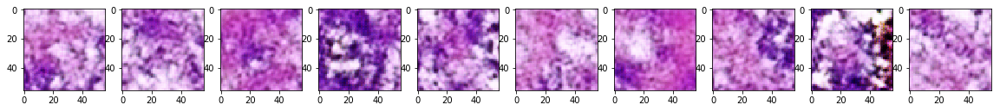

Epochs 1/5: Generator Loss: 7.1927. Discriminator Loss: -0.2468
Epochs 1/5: Generator Loss: -4.2979. Discriminator Loss: -0.2419
Epochs 1/5: Generator Loss: 3.3342. Discriminator Loss: -0.2631
Epochs 1/5: Generator Loss: -5.6108. Discriminator Loss: -0.2255
Epochs 1/5: Generator Loss: 0.0325. Discriminator Loss: -0.2016
Epochs 1/5: Generator Loss: -1.1921. Discriminator Loss: -0.173
Epochs 1/5: Generator Loss: -0.944. Discriminator Loss: -0.2283
Epochs 1/5: Generator Loss: -0.2224. Discriminator Loss: -0.2345
Epochs 1/5: Generator Loss: -3.2445. Discriminator Loss: -0.2847
Epochs 1/5: Generator Loss: -0.1045. Discriminator Loss: -0.2666


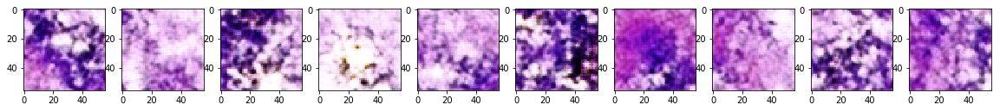

Epochs 1/5: Generator Loss: -6.7192. Discriminator Loss: -0.3517
Epochs 1/5: Generator Loss: -0.022. Discriminator Loss: -0.2162
Epochs 1/5: Generator Loss: 5.2015. Discriminator Loss: -0.2732
Epochs 1/5: Generator Loss: -6.1009. Discriminator Loss: -0.3528
Epochs 1/5: Generator Loss: -1.7943. Discriminator Loss: -0.169
Epochs 1/5: Generator Loss: 0.2124. Discriminator Loss: -0.2119
Epochs 1/5: Generator Loss: 0.0222. Discriminator Loss: -0.2794
Epochs 1/5: Generator Loss: -0.8738. Discriminator Loss: -0.3241
Epochs 1/5: Generator Loss: -5.4836. Discriminator Loss: -0.3915
Epochs 1/5: Generator Loss: -1.4779. Discriminator Loss: -0.2799


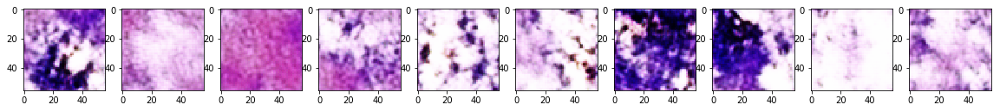

Epochs 1/5: Generator Loss: -2.291. Discriminator Loss: -0.3219
Epochs 1/5: Generator Loss: 0.8468. Discriminator Loss: -0.2312
Epochs 1/5: Generator Loss: 0.3586. Discriminator Loss: -0.2631
Epochs 1/5: Generator Loss: 5.9692. Discriminator Loss: -0.172
Epochs 1/5: Generator Loss: -4.8618. Discriminator Loss: -0.2599
Epochs 1/5: Generator Loss: -0.8799. Discriminator Loss: -0.3116
Epochs 1/5: Generator Loss: 0.0204. Discriminator Loss: -0.2974
Epochs 1/5: Generator Loss: -6.7505. Discriminator Loss: -0.3102
Epochs 1/5: Generator Loss: -3.4458. Discriminator Loss: -0.2746
Epochs 1/5: Generator Loss: 0.281. Discriminator Loss: -0.3461


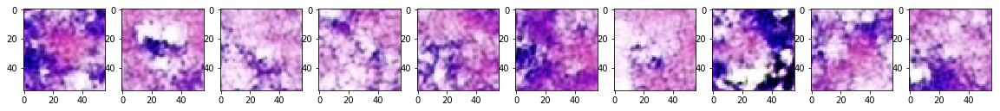

Epochs 1/5: Generator Loss: -3.6309. Discriminator Loss: -0.3087
Epochs 1/5: Generator Loss: -0.4381. Discriminator Loss: -0.2842
Epochs 1/5: Generator Loss: -6.9905. Discriminator Loss: -0.3295
Epochs 1/5: Generator Loss: 1.6275. Discriminator Loss: -0.2189
Epochs 1/5: Generator Loss: -4.7603. Discriminator Loss: -0.4103
Epochs 1/5: Generator Loss: 13.6899. Discriminator Loss: -0.385
Epochs 1/5: Generator Loss: -7.1392. Discriminator Loss: -0.271
Epochs 1/5: Generator Loss: -0.2883. Discriminator Loss: -0.2769
Epochs 1/5: Generator Loss: -6.0967. Discriminator Loss: -0.2337
Epochs 1/5: Generator Loss: -1.0118. Discriminator Loss: -0.2836


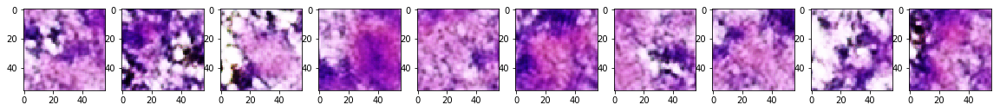

Epochs 1/5: Generator Loss: -0.4955. Discriminator Loss: -0.2866
Epochs 1/5: Generator Loss: 1.7311. Discriminator Loss: -0.2601
Epochs 1/5: Generator Loss: 2.1275. Discriminator Loss: -0.1739
Epochs 1/5: Generator Loss: -5.6431. Discriminator Loss: -0.2764
Epochs 1/5: Generator Loss: -3.8505. Discriminator Loss: -0.3527
Epochs 1/5: Generator Loss: 1.0089. Discriminator Loss: -0.2387
Epochs 1/5: Generator Loss: -5.0557. Discriminator Loss: -0.2799
Epochs 1/5: Generator Loss: 1.6799. Discriminator Loss: -0.2371
Epochs 1/5: Generator Loss: -4.2151. Discriminator Loss: -0.3604
Epochs 1/5: Generator Loss: -3.3793. Discriminator Loss: -0.2793


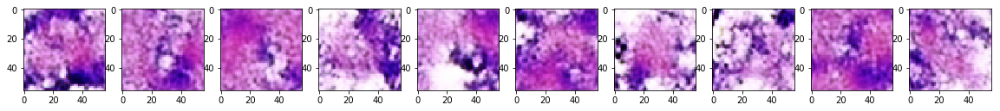

Epochs 1/5: Generator Loss: -2.2434. Discriminator Loss: -0.2532
Epochs 1/5: Generator Loss: 2.1229. Discriminator Loss: -0.251
Epochs 1/5: Generator Loss: -1.8226. Discriminator Loss: -0.2774
Epochs 1/5: Generator Loss: -0.382. Discriminator Loss: -0.2734
Epochs 1/5: Generator Loss: -1.9048. Discriminator Loss: -0.2531
Epochs 1/5: Generator Loss: -0.7163. Discriminator Loss: -0.2489
Epochs 1/5: Generator Loss: -0.1055. Discriminator Loss: -0.2862
Epochs 1/5: Generator Loss: 1.4925. Discriminator Loss: -0.2879
Epochs 1/5: Generator Loss: 1.413. Discriminator Loss: -0.2499
Epochs 1/5: Generator Loss: -0.6679. Discriminator Loss: -0.2863


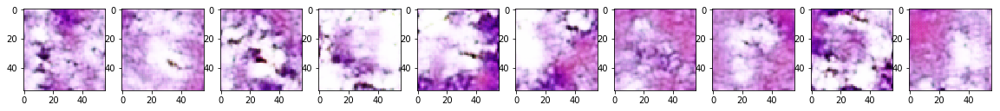

Epochs 1/5: Generator Loss: 6.2936. Discriminator Loss: -0.3488
Epochs 1/5: Generator Loss: -7.4435. Discriminator Loss: -0.2909
Epochs 1/5: Generator Loss: -5.6278. Discriminator Loss: -0.3406
Epochs 1/5: Generator Loss: -0.302. Discriminator Loss: -0.1427
Epochs 1/5: Generator Loss: 0.6544. Discriminator Loss: -0.1983
Epochs 1/5: Generator Loss: -4.4487. Discriminator Loss: -0.2744
Epochs 1/5: Generator Loss: 0.442. Discriminator Loss: -0.299
Epochs 1/5: Generator Loss: -0.5043. Discriminator Loss: -0.3188
Epochs 1/5: Generator Loss: -4.7842. Discriminator Loss: -0.2634
Epochs 1/5: Generator Loss: -10.7006. Discriminator Loss: -0.2833


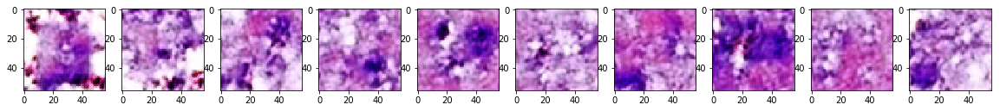

Epochs 1/5: Generator Loss: 1.5589. Discriminator Loss: -0.1703
Epochs 1/5: Generator Loss: 1.0417. Discriminator Loss: -0.306
Epochs 1/5: Generator Loss: -4.1361. Discriminator Loss: -0.2604
Epochs 1/5: Generator Loss: 2.7746. Discriminator Loss: -0.2626
Epochs 1/5: Generator Loss: -7.2184. Discriminator Loss: -0.2888
Epochs 1/5: Generator Loss: 3.657. Discriminator Loss: -0.1929
Epochs 1/5: Generator Loss: 1.6847. Discriminator Loss: -0.1599
Epochs 1/5: Generator Loss: -3.7476. Discriminator Loss: -0.2635
Epochs 1/5: Generator Loss: -0.6574. Discriminator Loss: -0.4067
Epochs 1/5: Generator Loss: 1.2348. Discriminator Loss: -0.4161


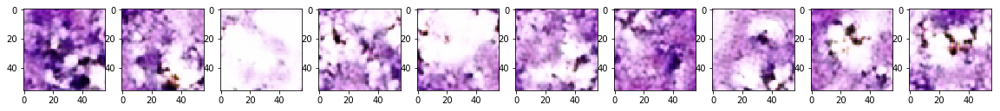

Epochs 1/5: Generator Loss: 3.3155. Discriminator Loss: -0.3541
Epochs 1/5: Generator Loss: 0.5551. Discriminator Loss: -0.3123
Epochs 1/5: Generator Loss: -0.7627. Discriminator Loss: -0.2115
Epochs 1/5: Generator Loss: -3.3748. Discriminator Loss: -0.3453
Epochs 1/5: Generator Loss: 0.4011. Discriminator Loss: -0.2868
Epochs 1/5: Generator Loss: -0.3677. Discriminator Loss: -0.16
Epochs 1/5: Generator Loss: -0.4575. Discriminator Loss: -0.2051
Epochs 1/5: Generator Loss: -2.186. Discriminator Loss: -0.1071
Epochs 1/5: Generator Loss: -1.4324. Discriminator Loss: -0.3073
Epochs 1/5: Generator Loss: -5.674. Discriminator Loss: -0.356


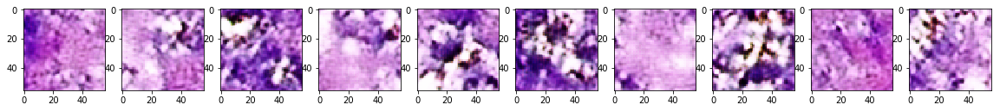

Epochs 1/5: Generator Loss: -6.0824. Discriminator Loss: -0.3572
Epochs 1/5: Generator Loss: -2.4238. Discriminator Loss: -0.3195
Epochs 1/5: Generator Loss: -3.0904. Discriminator Loss: -0.2564
Epochs 1/5: Generator Loss: -2.4213. Discriminator Loss: -0.2298
Epochs 1/5: Generator Loss: -0.0863. Discriminator Loss: -0.2607
Epochs 1/5: Generator Loss: -3.8631. Discriminator Loss: -0.4079
Epochs 1/5: Generator Loss: 2.5824. Discriminator Loss: -0.322
Epochs 1/5: Generator Loss: -4.9227. Discriminator Loss: -0.2729
Epochs 1/5: Generator Loss: 0.8989. Discriminator Loss: -0.2341
Epochs 1/5: Generator Loss: -3.2834. Discriminator Loss: -0.324


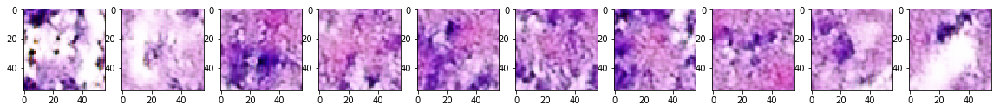

Epochs 1/5: Generator Loss: 1.7242. Discriminator Loss: -0.3092
Epochs 1/5: Generator Loss: 0.6629. Discriminator Loss: -0.2284
Epochs 1/5: Generator Loss: -5.1915. Discriminator Loss: -0.3188
Epochs 1/5: Generator Loss: -0.3465. Discriminator Loss: -0.2955
Epochs 1/5: Generator Loss: -2.4099. Discriminator Loss: -0.2506
Epochs 1/5: Generator Loss: 1.0757. Discriminator Loss: -0.3963
Epochs 1/5: Generator Loss: -0.0589. Discriminator Loss: -0.3138
Epochs 1/5: Generator Loss: -1.1686. Discriminator Loss: -0.2137
Epochs 1/5: Generator Loss: -5.0237. Discriminator Loss: -0.265
Epochs 1/5: Generator Loss: 0.9977. Discriminator Loss: -0.3166


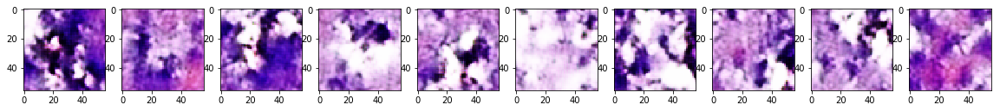

Epochs 1/5: Generator Loss: 10.1864. Discriminator Loss: -0.411
Epochs 1/5: Generator Loss: -5.9603. Discriminator Loss: -0.3529
Epochs 1/5: Generator Loss: -1.6131. Discriminator Loss: -0.2802
Epochs 1/5: Generator Loss: 2.7947. Discriminator Loss: -0.3401
Epochs 1/5: Generator Loss: -3.7562. Discriminator Loss: -0.2273
Epochs 1/5: Generator Loss: 1.1638. Discriminator Loss: -0.2306
Epochs 1/5: Generator Loss: -2.3641. Discriminator Loss: -0.1991
Epochs 1/5: Generator Loss: 2.7821. Discriminator Loss: -0.2405
Epochs 1/5: Generator Loss: -0.2945. Discriminator Loss: -0.2887
Epochs 1/5: Generator Loss: -3.3119. Discriminator Loss: -0.3396


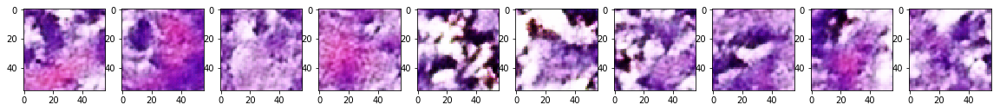

Epochs 1/5: Generator Loss: 4.9359. Discriminator Loss: -0.4058
Epochs 1/5: Generator Loss: -5.6423. Discriminator Loss: -0.2481
Epochs 1/5: Generator Loss: 3.1716. Discriminator Loss: -0.2846
Epochs 1/5: Generator Loss: -5.3334. Discriminator Loss: -0.381
Epochs 1/5: Generator Loss: 1.1701. Discriminator Loss: -0.3213
Epochs 1/5: Generator Loss: 0.0724. Discriminator Loss: -0.1913
Epochs 1/5: Generator Loss: -0.1555. Discriminator Loss: -0.3129
Epochs 1/5: Generator Loss: -4.8634. Discriminator Loss: -0.3531
Epochs 1/5: Generator Loss: -0.2627. Discriminator Loss: -0.2791
Epochs 1/5: Generator Loss: -1.4153. Discriminator Loss: -0.3167


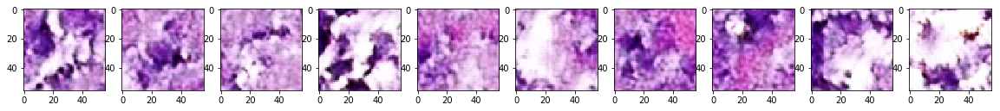

Epochs 1/5: Generator Loss: -0.8023. Discriminator Loss: -0.2923
Epochs 1/5: Generator Loss: -0.0227. Discriminator Loss: -0.1839
Epochs 1/5: Generator Loss: 1.3935. Discriminator Loss: -0.2414
Epochs 1/5: Generator Loss: -4.5139. Discriminator Loss: -0.3777
Epochs 1/5: Generator Loss: -1.9802. Discriminator Loss: -0.2973
Epochs 1/5: Generator Loss: 1.9249. Discriminator Loss: -0.2786
Epochs 1/5: Generator Loss: -1.2816. Discriminator Loss: -0.306
Epochs 1/5: Generator Loss: 1.8861. Discriminator Loss: -0.1943
Epochs 1/5: Generator Loss: 0.0958. Discriminator Loss: -0.1916
Epochs 1/5: Generator Loss: 0.3272. Discriminator Loss: -0.3256


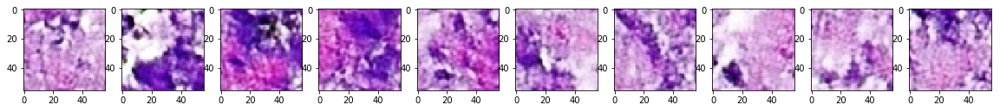

Epochs 1/5: Generator Loss: -3.0783. Discriminator Loss: -0.276
Epochs 1/5: Generator Loss: -3.3209. Discriminator Loss: -0.4119
Epochs 1/5: Generator Loss: -1.2562. Discriminator Loss: -0.286
Epochs 1/5: Generator Loss: -0.0897. Discriminator Loss: -0.338
Epochs 1/5: Generator Loss: -0.096. Discriminator Loss: -0.2443
Epochs 1/5: Generator Loss: 0.9209. Discriminator Loss: -0.3491
Epochs 1/5: Generator Loss: 3.0656. Discriminator Loss: -0.1615
Epochs 1/5: Generator Loss: -4.6941. Discriminator Loss: -0.2778
Epochs 1/5: Generator Loss: 1.0174. Discriminator Loss: -0.2802
Epochs 1/5: Generator Loss: 1.8498. Discriminator Loss: -0.3913


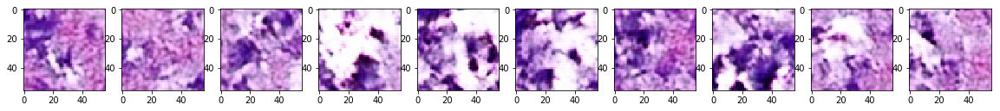

Epochs 1/5: Generator Loss: -1.9154. Discriminator Loss: -0.2595
Epochs 1/5: Generator Loss: 1.7554. Discriminator Loss: -0.3955
Epochs 1/5: Generator Loss: -2.2599. Discriminator Loss: -0.1232
Epochs 1/5: Generator Loss: 3.5153. Discriminator Loss: -0.2146
Epochs 1/5: Generator Loss: -4.5854. Discriminator Loss: -0.1298
Epochs 1/5: Generator Loss: 4.7295. Discriminator Loss: -0.1154
Epochs 1/5: Generator Loss: -6.7027. Discriminator Loss: -0.1276
Epochs 1/5: Generator Loss: 3.6869. Discriminator Loss: -0.2355
Epochs 1/5: Generator Loss: -3.9852. Discriminator Loss: -0.3178
Epochs 1/5: Generator Loss: -1.9696. Discriminator Loss: -0.2607


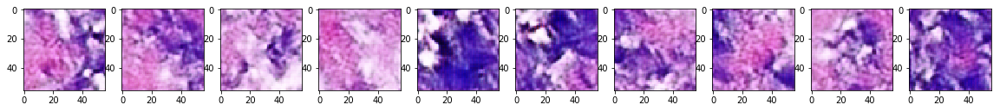

Epochs 1/5: Generator Loss: -0.6439. Discriminator Loss: -0.1875
Epochs 1/5: Generator Loss: -1.0451. Discriminator Loss: -0.2134
Epochs 1/5: Generator Loss: 2.0052. Discriminator Loss: -0.2927
Epochs 1/5: Generator Loss: -3.4616. Discriminator Loss: -0.3688
Epochs 1/5: Generator Loss: 3.3371. Discriminator Loss: -0.2637
Epochs 1/5: Generator Loss: -5.1596. Discriminator Loss: -0.1984
Epochs 1/5: Generator Loss: 6.6223. Discriminator Loss: -0.1685
Epochs 1/5: Generator Loss: 1.3263. Discriminator Loss: -0.3273
Epochs 1/5: Generator Loss: -2.2641. Discriminator Loss: -0.3144
Epochs 1/5: Generator Loss: 1.3258. Discriminator Loss: -0.1338


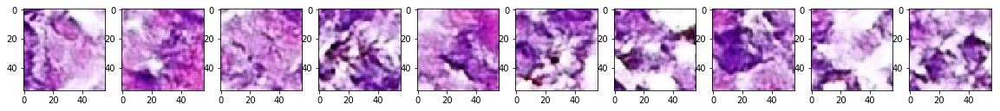

Epochs 1/5: Generator Loss: -3.7616. Discriminator Loss: -0.2598
Epochs 1/5: Generator Loss: 1.728. Discriminator Loss: -0.3277
Epochs 1/5: Generator Loss: 3.4975. Discriminator Loss: -0.2916
Epochs 1/5: Generator Loss: -0.0555. Discriminator Loss: -0.2887
Epochs 1/5: Generator Loss: 0.6722. Discriminator Loss: -0.2139
Epochs 1/5: Generator Loss: -0.0581. Discriminator Loss: -0.2462
Epochs 1/5: Generator Loss: -0.918. Discriminator Loss: -0.2782
Epochs 1/5: Generator Loss: 1.1801. Discriminator Loss: -0.2719
Epochs 1/5: Generator Loss: -1.3291. Discriminator Loss: -0.4881
Epochs 1/5: Generator Loss: 1.0369. Discriminator Loss: -0.2546


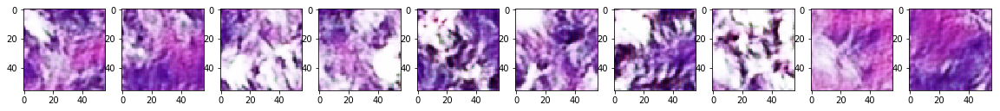

Epochs 1/5: Generator Loss: -2.9497. Discriminator Loss: -0.2205
Epochs 1/5: Generator Loss: 1.1117. Discriminator Loss: -0.3467
Epochs 1/5: Generator Loss: 1.4631. Discriminator Loss: -0.2612
Epochs 1/5: Generator Loss: -6.9318. Discriminator Loss: -0.2308
Epochs 1/5: Generator Loss: -1.5363. Discriminator Loss: -0.1892
Epochs 1/5: Generator Loss: -0.0568. Discriminator Loss: -0.1489
Epochs 1/5: Generator Loss: -0.5831. Discriminator Loss: -0.2921
Epochs 1/5: Generator Loss: 0.3918. Discriminator Loss: -0.1849
Epochs 1/5: Generator Loss: -2.5832. Discriminator Loss: -0.2893
Epochs 1/5: Generator Loss: -3.6281. Discriminator Loss: -0.4456


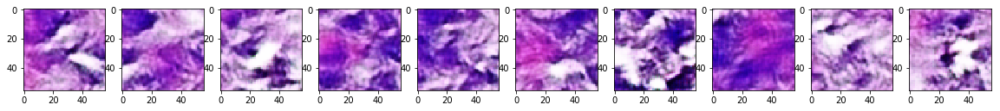

Epochs 1/5: Generator Loss: 0.2534. Discriminator Loss: -0.1983
Epochs 1/5: Generator Loss: 4.3466. Discriminator Loss: -0.4482
Epochs 1/5: Generator Loss: -5.2293. Discriminator Loss: -0.1629
Epochs 1/5: Generator Loss: -1.2942. Discriminator Loss: -0.2097
Epochs 1/5: Generator Loss: 1.4871. Discriminator Loss: -0.1432
Epochs 1/5: Generator Loss: 1.6667. Discriminator Loss: -0.3392
Epochs 1/5: Generator Loss: -1.6977. Discriminator Loss: -0.2845
Epochs 1/5: Generator Loss: 0.2555. Discriminator Loss: -0.2666
Epochs 1/5: Generator Loss: 4.0168. Discriminator Loss: -0.2341
Epochs 1/5: Generator Loss: -3.1741. Discriminator Loss: -0.2915


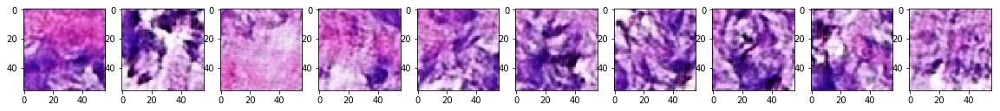

Epochs 1/5: Generator Loss: -0.452. Discriminator Loss: -0.2005
Epochs 1/5: Generator Loss: -1.6703. Discriminator Loss: -0.247
Epochs 1/5: Generator Loss: -2.5181. Discriminator Loss: -0.2582
Epochs 1/5: Generator Loss: 2.6063. Discriminator Loss: -0.3074
Epochs 1/5: Generator Loss: -3.2035. Discriminator Loss: -0.2528
Epochs 1/5: Generator Loss: 0.2743. Discriminator Loss: -0.1976
Epochs 1/5: Generator Loss: 2.1805. Discriminator Loss: -0.1679
Epochs 1/5: Generator Loss: -3.1801. Discriminator Loss: -0.3061
Epochs 1/5: Generator Loss: 3.44. Discriminator Loss: -0.3797
Epochs 1/5: Generator Loss: -3.7622. Discriminator Loss: -0.2169


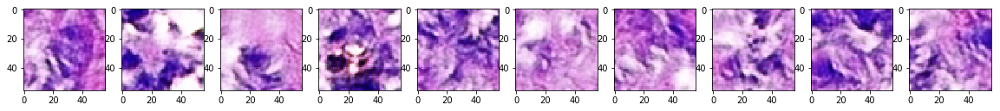

Epochs 1/5: Generator Loss: -2.7102. Discriminator Loss: -0.2806
Epochs 1/5: Generator Loss: -1.021. Discriminator Loss: -0.2901
Epochs 1/5: Generator Loss: 3.2905. Discriminator Loss: -0.2336
Epochs 1/5: Generator Loss: -2.9977. Discriminator Loss: -0.1945
Epochs 1/5: Generator Loss: 1.9532. Discriminator Loss: -0.1139
Epochs 1/5: Generator Loss: 0.3358. Discriminator Loss: -0.1252
Epochs 1/5: Generator Loss: -0.6377. Discriminator Loss: -0.3242
Epochs 1/5: Generator Loss: -0.0858. Discriminator Loss: -0.126
Epochs 1/5: Generator Loss: 5.2226. Discriminator Loss: -0.25
Epochs 1/5: Generator Loss: -0.2352. Discriminator Loss: -0.2793


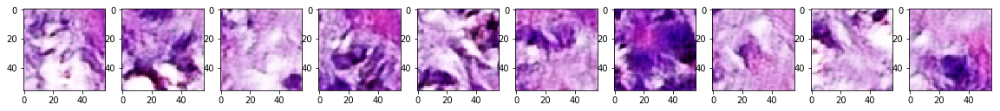

Epochs 1/5: Generator Loss: -1.6949. Discriminator Loss: -0.3432
Epochs 1/5: Generator Loss: -2.2767. Discriminator Loss: -0.1718
Epochs 1/5: Generator Loss: 0.8137. Discriminator Loss: -0.2776
Epochs 1/5: Generator Loss: 4.3508. Discriminator Loss: -0.3517
Epochs 1/5: Generator Loss: -1.3237. Discriminator Loss: -0.306
Epochs 1/5: Generator Loss: 0.2675. Discriminator Loss: -0.456
Epochs 1/5: Generator Loss: 1.8089. Discriminator Loss: -0.3373
Epochs 1/5: Generator Loss: -3.4698. Discriminator Loss: -0.2569
Epochs 1/5: Generator Loss: -1.3101. Discriminator Loss: -0.2839
Epochs 1/5: Generator Loss: 1.954. Discriminator Loss: -0.2343


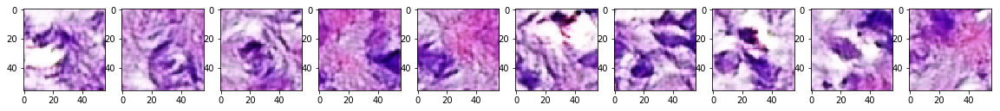

Epochs 1/5: Generator Loss: -1.6556. Discriminator Loss: -0.3705
Epochs 1/5: Generator Loss: -4.1013. Discriminator Loss: -0.1456
Epochs 1/5: Generator Loss: -0.2199. Discriminator Loss: -0.1869
Epochs 1/5: Generator Loss: -5.3961. Discriminator Loss: -0.3129
Epochs 1/5: Generator Loss: 3.2685. Discriminator Loss: -0.3324
Epochs 1/5: Generator Loss: -2.9072. Discriminator Loss: -0.4375
Epochs 1/5: Generator Loss: -1.2246. Discriminator Loss: -0.1743
Epochs 1/5: Generator Loss: -3.9775. Discriminator Loss: -0.2274
Epochs 1/5: Generator Loss: 2.676. Discriminator Loss: -0.2759
Epochs 1/5: Generator Loss: 0.1745. Discriminator Loss: -0.156


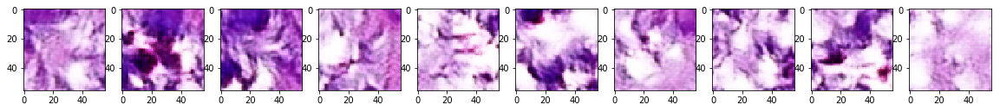

Epochs 1/5: Generator Loss: -2.2148. Discriminator Loss: -0.3464
Epochs 1/5: Generator Loss: 1.4261. Discriminator Loss: -0.2312
Epochs 1/5: Generator Loss: -0.8178. Discriminator Loss: -0.2865
Epochs 1/5: Generator Loss: -1.2964. Discriminator Loss: -0.0388
Epochs 1/5: Generator Loss: -0.525. Discriminator Loss: -0.1475
Epochs 1/5: Generator Loss: -0.1456. Discriminator Loss: -0.0869
Epochs 1/5: Generator Loss: 4.0491. Discriminator Loss: -0.1553
Epochs 1/5: Generator Loss: -2.3366. Discriminator Loss: -0.1938
Epochs 1/5: Generator Loss: 2.6603. Discriminator Loss: -0.1794
Epochs 1/5: Generator Loss: 1.2206. Discriminator Loss: -0.3149


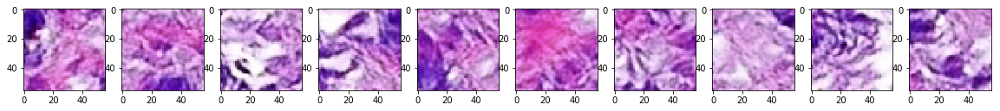

Epochs 1/5: Generator Loss: 4.4925. Discriminator Loss: -0.2588
Epochs 1/5: Generator Loss: -7.9581. Discriminator Loss: -0.1934
Epochs 1/5: Generator Loss: 4.9351. Discriminator Loss: -0.3811
Epochs 1/5: Generator Loss: -10.4155. Discriminator Loss: -0.3372
Epochs 1/5: Generator Loss: 0.5713. Discriminator Loss: -0.2239
Epochs 1/5: Generator Loss: -2.123. Discriminator Loss: -0.1771
Epochs 1/5: Generator Loss: 4.3498. Discriminator Loss: -0.2708
Epochs 1/5: Generator Loss: -3.6076. Discriminator Loss: -0.1934
Epochs 1/5: Generator Loss: -2.3061. Discriminator Loss: -0.1636
Epochs 1/5: Generator Loss: 1.1787. Discriminator Loss: -0.3455


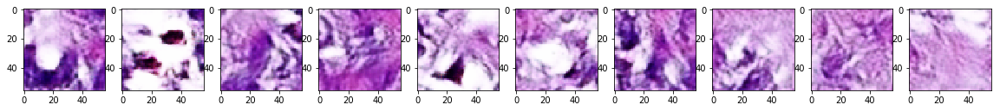

Epochs 1/5: Generator Loss: -0.9576. Discriminator Loss: -0.1164
Epochs 1/5: Generator Loss: -0.9784. Discriminator Loss: -0.211
Epochs 1/5: Generator Loss: -1.4226. Discriminator Loss: -0.2626
Epochs 1/5: Generator Loss: 3.2413. Discriminator Loss: -0.1995
Epochs 1/5: Generator Loss: -4.8291. Discriminator Loss: -0.3077
Epochs 1/5: Generator Loss: 2.5291. Discriminator Loss: -0.2825
Epochs 1/5: Generator Loss: 2.9733. Discriminator Loss: -0.0347
Epochs 1/5: Generator Loss: -3.8047. Discriminator Loss: -0.1267
Epochs 1/5: Generator Loss: 3.5955. Discriminator Loss: -0.26
Epochs 1/5: Generator Loss: -2.7165. Discriminator Loss: -0.2691


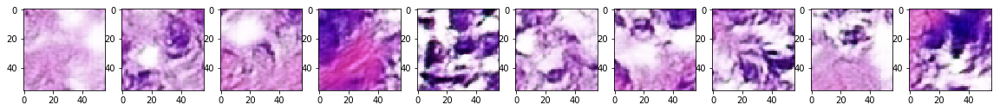

Epochs 1/5: Generator Loss: 0.6337. Discriminator Loss: -0.1516
Epochs 1/5: Generator Loss: -0.9339. Discriminator Loss: -0.1061
Epochs 1/5: Generator Loss: -0.8875. Discriminator Loss: -0.1666
Epochs 1/5: Generator Loss: -3.0109. Discriminator Loss: -0.3492
Epochs 1/5: Generator Loss: 2.4221. Discriminator Loss: -0.1068
Epochs 1/5: Generator Loss: -1.7347. Discriminator Loss: -0.0443
Epochs 1/5: Generator Loss: 1.0198. Discriminator Loss: -0.294
Epochs 1/5: Generator Loss: -1.7784. Discriminator Loss: -0.1454
Epochs 1/5: Generator Loss: 3.8933. Discriminator Loss: -0.226
Epochs 1/5: Generator Loss: -5.2655. Discriminator Loss: -0.271


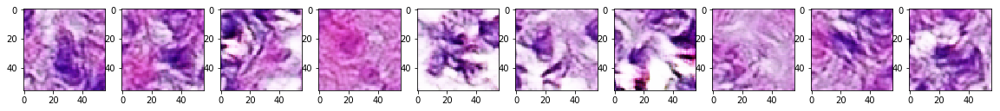

Epochs 1/5: Generator Loss: 3.335. Discriminator Loss: -0.3802
Epochs 1/5: Generator Loss: -6.1896. Discriminator Loss: -0.266
Epochs 1/5: Generator Loss: -2.0694. Discriminator Loss: -0.129
Epochs 1/5: Generator Loss: -1.4677. Discriminator Loss: -0.2016
Epochs 1/5: Generator Loss: -2.1475. Discriminator Loss: -0.1983
Epochs 1/5: Generator Loss: -0.1232. Discriminator Loss: -0.2536
Epochs 1/5: Generator Loss: 1.1642. Discriminator Loss: -0.2286
Epochs 1/5: Generator Loss: -1.8466. Discriminator Loss: -0.32
Epochs 1/5: Generator Loss: 8.6314. Discriminator Loss: -0.1599
Epochs 1/5: Generator Loss: 0.3207. Discriminator Loss: -0.1865


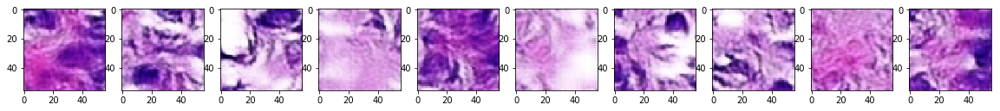

Epochs 1/5: Generator Loss: -3.3266. Discriminator Loss: -0.2918
Epochs 1/5: Generator Loss: 0.4412. Discriminator Loss: -0.2212
Epochs 1/5: Generator Loss: -4.7138. Discriminator Loss: -0.2897
Epochs 1/5: Generator Loss: 1.5758. Discriminator Loss: -0.3621
Epochs 1/5: Generator Loss: -2.0863. Discriminator Loss: -0.2267
Epochs 1/5: Generator Loss: -1.5289. Discriminator Loss: -0.2308
Epochs 1/5: Generator Loss: 1.2914. Discriminator Loss: -0.372
Epochs 1/5: Generator Loss: -2.9343. Discriminator Loss: -0.2862
Epochs 1/5: Generator Loss: -3.8723. Discriminator Loss: -0.2337
Epochs 1/5: Generator Loss: 2.9096. Discriminator Loss: -0.3707


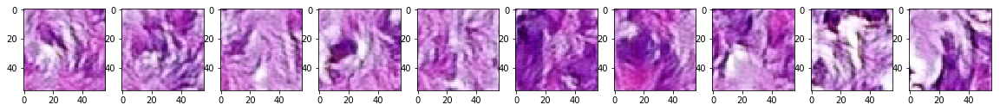

Epochs 1/5: Generator Loss: -4.381. Discriminator Loss: -0.3538
Epochs 1/5: Generator Loss: -1.126. Discriminator Loss: -0.3449
Epochs 1/5: Generator Loss: 3.1008. Discriminator Loss: -0.2542
Epochs 1/5: Generator Loss: -4.2339. Discriminator Loss: -0.2378
Epochs 1/5: Generator Loss: -6.0218. Discriminator Loss: -0.2484
Epochs 1/5: Generator Loss: 3.5979. Discriminator Loss: -0.3127
Epochs 1/5: Generator Loss: -0.2996. Discriminator Loss: -0.2248
Epochs 1/5: Generator Loss: -5.7807. Discriminator Loss: -0.1572
Epochs 1/5: Generator Loss: 2.3774. Discriminator Loss: -0.1602
Epochs 1/5: Generator Loss: 0.2943. Discriminator Loss: -0.2483


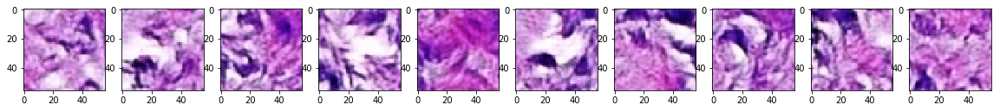

Epochs 1/5: Generator Loss: -4.0475. Discriminator Loss: -0.2014
Epochs 1/5: Generator Loss: 8.0704. Discriminator Loss: -0.3611
Epochs 1/5: Generator Loss: 1.7285. Discriminator Loss: -0.1578
Epochs 1/5: Generator Loss: -8.2003. Discriminator Loss: -0.2316
Epochs 1/5: Generator Loss: -2.7771. Discriminator Loss: -0.3153
Epochs 1/5: Generator Loss: 3.0218. Discriminator Loss: -0.4475
Epochs 1/5: Generator Loss: -1.8757. Discriminator Loss: -0.3669
Epochs 1/5: Generator Loss: -1.7232. Discriminator Loss: -0.1924
Epochs 1/5: Generator Loss: -1.5213. Discriminator Loss: -0.0956
Epochs 1/5: Generator Loss: -1.6709. Discriminator Loss: -0.1933


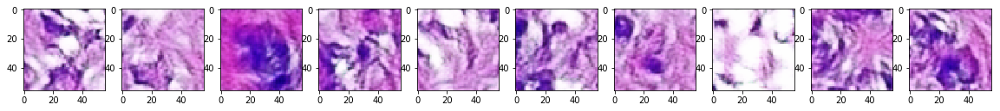

Epochs 1/5: Generator Loss: 1.0089. Discriminator Loss: -0.1631
Epochs 1/5: Generator Loss: -0.9314. Discriminator Loss: -0.1192
Epochs 1/5: Generator Loss: -4.7187. Discriminator Loss: -0.1763
Epochs 1/5: Generator Loss: 0.1893. Discriminator Loss: 0.0903
Epochs 1/5: Generator Loss: 0.5236. Discriminator Loss: -0.0197
Epochs 1/5: Generator Loss: -1.8559. Discriminator Loss: -0.2067
Epochs 1/5: Generator Loss: -9.3622. Discriminator Loss: -0.1033
Epochs 1/5: Generator Loss: 0.6227. Discriminator Loss: -0.1228
Epochs 1/5: Generator Loss: 1.7278. Discriminator Loss: -0.1778
Epochs 1/5: Generator Loss: -8.2618. Discriminator Loss: -0.2603


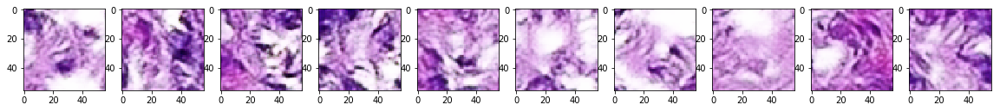

Epochs 1/5: Generator Loss: 4.8394. Discriminator Loss: -0.1291
Epochs 1/5: Generator Loss: 0.7343. Discriminator Loss: -0.0027
Epochs 1/5: Generator Loss: 0.2872. Discriminator Loss: 0.0066
Epochs 1/5: Generator Loss: -3.156. Discriminator Loss: -0.1403
Epochs 1/5: Generator Loss: 3.1807. Discriminator Loss: -0.1032
Epochs 1/5: Generator Loss: -2.7113. Discriminator Loss: -0.1169
Epochs 1/5: Generator Loss: 0.5127. Discriminator Loss: -0.1613
Epochs 1/5: Generator Loss: -4.1226. Discriminator Loss: -0.0752
Epochs 1/5: Generator Loss: 6.4024. Discriminator Loss: -0.1975
Epochs 1/5: Generator Loss: -6.428. Discriminator Loss: -0.165


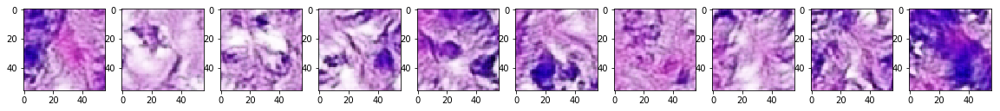

Epochs 1/5: Generator Loss: -8.3853. Discriminator Loss: -0.3154
Epochs 1/5: Generator Loss: -5.2803. Discriminator Loss: -0.2104
Epochs 1/5: Generator Loss: 4.1359. Discriminator Loss: -0.2211
Epochs 1/5: Generator Loss: 0.4847. Discriminator Loss: -0.0769
Epochs 1/5: Generator Loss: 2.5918. Discriminator Loss: -0.1201
Epochs 1/5: Generator Loss: -7.4568. Discriminator Loss: -0.1855
Epochs 1/5: Generator Loss: 0.5459. Discriminator Loss: -0.2212
Epochs 1/5: Generator Loss: -2.3219. Discriminator Loss: -0.1228
Epochs 1/5: Generator Loss: 3.7822. Discriminator Loss: -0.1572
Epochs 1/5: Generator Loss: -6.0516. Discriminator Loss: -0.2727


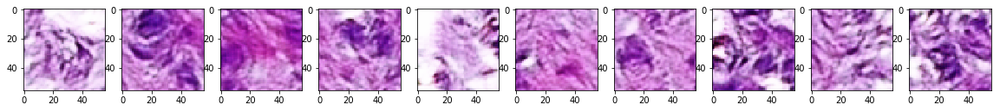

Epochs 1/5: Generator Loss: -1.8612. Discriminator Loss: -0.0824
Epochs 1/5: Generator Loss: 5.8104. Discriminator Loss: -0.1171
Epochs 1/5: Generator Loss: -6.5792. Discriminator Loss: -0.087
Epochs 1/5: Generator Loss: 11.4869. Discriminator Loss: -0.2883
Epochs 1/5: Generator Loss: -8.1749. Discriminator Loss: -0.2078
Epochs 1/5: Generator Loss: 5.2055. Discriminator Loss: -0.1598
Epochs 1/5: Generator Loss: -3.219. Discriminator Loss: -0.187
Epochs 1/5: Generator Loss: -1.6783. Discriminator Loss: -0.148
Epochs 1/5: Generator Loss: 4.1662. Discriminator Loss: -0.0826
Epochs 1/5: Generator Loss: 3.5432. Discriminator Loss: -0.055


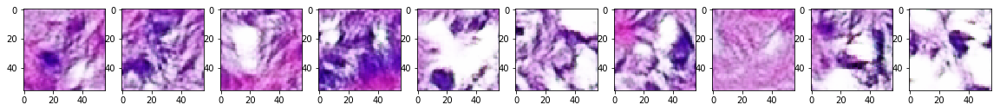

Epochs 1/5: Generator Loss: -0.9066. Discriminator Loss: -0.3295
Epochs 1/5: Generator Loss: -2.6049. Discriminator Loss: -0.1089
Epochs 1/5: Generator Loss: -2.4116. Discriminator Loss: -0.1415
Epochs 1/5: Generator Loss: 0.1889. Discriminator Loss: -0.1892
Epochs 1/5: Generator Loss: 0.0582. Discriminator Loss: -0.271
Epochs 1/5: Generator Loss: -7.0285. Discriminator Loss: -0.044
Epochs 1/5: Generator Loss: 3.2168. Discriminator Loss: -0.1701
Epochs 1/5: Generator Loss: -6.7943. Discriminator Loss: -0.1843
Epochs 1/5: Generator Loss: 2.0545. Discriminator Loss: -0.1738
Epochs 1/5: Generator Loss: -1.4759. Discriminator Loss: -0.2618


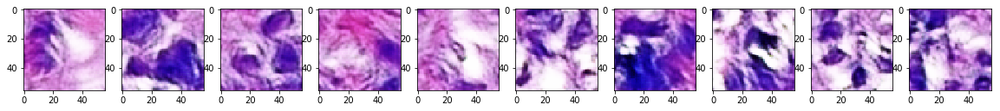

Epochs 1/5: Generator Loss: 4.2732. Discriminator Loss: -0.1828
Epochs 1/5: Generator Loss: -3.8167. Discriminator Loss: -0.2349
Epochs 1/5: Generator Loss: -3.206. Discriminator Loss: -0.0819
Epochs 1/5: Generator Loss: 2.3602. Discriminator Loss: -0.2956
Epochs 1/5: Generator Loss: -2.2612. Discriminator Loss: -0.1474
Epochs 1/5: Generator Loss: 5.3155. Discriminator Loss: -0.0869
Epochs 1/5: Generator Loss: -1.484. Discriminator Loss: -0.2634
Epochs 1/5: Generator Loss: -0.966. Discriminator Loss: -0.0988
Epochs 1/5: Generator Loss: 1.3832. Discriminator Loss: -0.1691
Epochs 1/5: Generator Loss: -3.786. Discriminator Loss: -0.1077


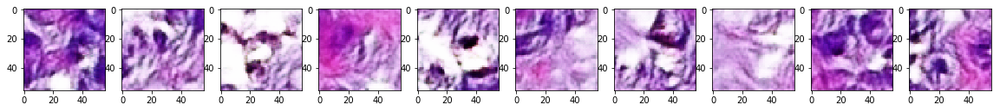

Epochs 1/5: Generator Loss: 0.6172. Discriminator Loss: -0.0943
Epochs 1/5: Generator Loss: -2.3047. Discriminator Loss: -0.2327
Epochs 1/5: Generator Loss: 1.2776. Discriminator Loss: -0.1339
Epochs 1/5: Generator Loss: 0.7194. Discriminator Loss: -0.1697
Epochs 1/5: Generator Loss: -2.8866. Discriminator Loss: -0.1124
Epochs 1/5: Generator Loss: 3.0922. Discriminator Loss: -0.2001
Epochs 1/5: Generator Loss: 3.2401. Discriminator Loss: -0.2254
Epochs 1/5: Generator Loss: 0.6768. Discriminator Loss: -0.3028
Epochs 1/5: Generator Loss: -3.1933. Discriminator Loss: -0.2531
Epochs 1/5: Generator Loss: 8.8779. Discriminator Loss: -0.2543


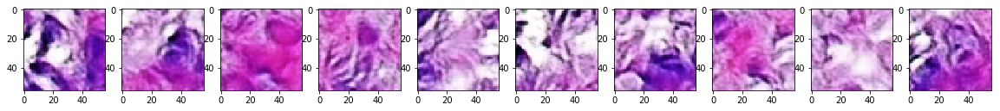

Epochs 1/5: Generator Loss: -0.7021. Discriminator Loss: -0.0783
Epochs 1/5: Generator Loss: -3.8226. Discriminator Loss: -0.1514
Epochs 1/5: Generator Loss: 2.7048. Discriminator Loss: -0.257
Epochs 1/5: Generator Loss: -3.9845. Discriminator Loss: -0.0688
Epochs 1/5: Generator Loss: 1.4431. Discriminator Loss: -0.1827
Epochs 1/5: Generator Loss: -0.1862. Discriminator Loss: -0.3112
Epochs 1/5: Generator Loss: -1.7109. Discriminator Loss: -0.2167
Epochs 1/5: Generator Loss: -4.1286. Discriminator Loss: -0.247
Epochs 1/5: Generator Loss: 4.4947. Discriminator Loss: -0.1233
Epochs 1/5: Generator Loss: -4.7985. Discriminator Loss: -0.2342


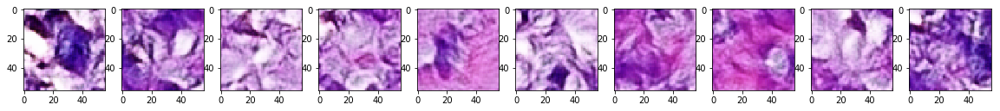

Epochs 1/5: Generator Loss: 3.0109. Discriminator Loss: -0.14
Epochs 1/5: Generator Loss: 1.3281. Discriminator Loss: -0.1438
Epochs 1/5: Generator Loss: -12.0957. Discriminator Loss: -0.2455
Epochs 1/5: Generator Loss: 12.4613. Discriminator Loss: -0.2341
Epochs 1/5: Generator Loss: -6.2463. Discriminator Loss: -0.1292
Epochs 1/5: Generator Loss: 3.372. Discriminator Loss: -0.0814
Epochs 1/5: Generator Loss: -6.9539. Discriminator Loss: -0.3083
Epochs 1/5: Generator Loss: -2.075. Discriminator Loss: -0.0922
Epochs 1/5: Generator Loss: 7.5912. Discriminator Loss: -0.225
Epochs 1/5: Generator Loss: -1.7372. Discriminator Loss: -0.2131


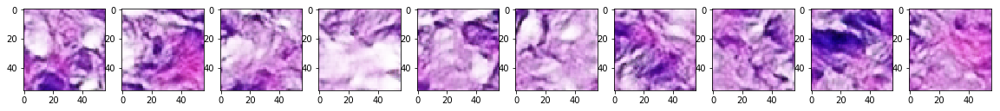

Epochs 1/5: Generator Loss: 3.0468. Discriminator Loss: -0.1988
Epochs 1/5: Generator Loss: 0.9529. Discriminator Loss: -0.139
Epochs 1/5: Generator Loss: -2.7076. Discriminator Loss: -0.1588
Epochs 1/5: Generator Loss: 1.3344. Discriminator Loss: -0.1639
Epochs 1/5: Generator Loss: -3.8896. Discriminator Loss: -0.0582
Epochs 1/5: Generator Loss: 4.7947. Discriminator Loss: -0.2062
Epochs 1/5: Generator Loss: -7.8392. Discriminator Loss: -0.3138
Epochs 1/5: Generator Loss: 4.3033. Discriminator Loss: -0.109
Epochs 1/5: Generator Loss: -3.7391. Discriminator Loss: -0.2194
Epochs 1/5: Generator Loss: 4.0449. Discriminator Loss: -0.2113


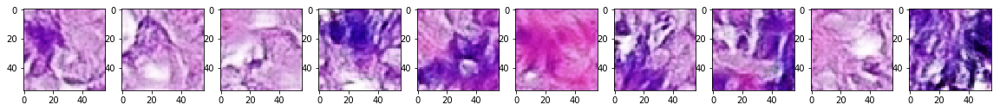

Epochs 1/5: Generator Loss: -3.7552. Discriminator Loss: -0.1897
Epochs 1/5: Generator Loss: 0.5716. Discriminator Loss: -0.3035
Epochs 1/5: Generator Loss: 3.8743. Discriminator Loss: -0.1136
Epochs 1/5: Generator Loss: -1.3706. Discriminator Loss: -0.165
Epochs 1/5: Generator Loss: 2.8194. Discriminator Loss: -0.2181
Epochs 1/5: Generator Loss: -3.5413. Discriminator Loss: -0.1317
Epochs 1/5: Generator Loss: 1.3556. Discriminator Loss: -0.1035
Epochs 1/5: Generator Loss: -4.5994. Discriminator Loss: -0.1706
Epochs 1/5: Generator Loss: -3.7333. Discriminator Loss: -0.2177
Epochs 1/5: Generator Loss: 5.2186. Discriminator Loss: -0.2827


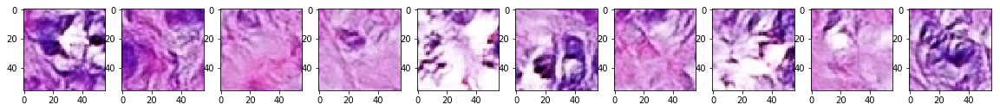

Epochs 1/5: Generator Loss: -1.9519. Discriminator Loss: -0.2025
Epochs 1/5: Generator Loss: 2.547. Discriminator Loss: -0.1936
Epochs 1/5: Generator Loss: -1.7612. Discriminator Loss: -0.2515
Epochs 1/5: Generator Loss: 0.208. Discriminator Loss: -0.1576
Epochs 1/5: Generator Loss: -0.8836. Discriminator Loss: -0.1298
Epochs 1/5: Generator Loss: 2.6912. Discriminator Loss: -0.1557
Epochs 1/5: Generator Loss: 2.735. Discriminator Loss: -0.2992
Epochs 1/5: Generator Loss: -1.2276. Discriminator Loss: -0.2443
Epochs 1/5: Generator Loss: -2.1178. Discriminator Loss: -0.1554
Epochs 1/5: Generator Loss: 1.3615. Discriminator Loss: -0.1649


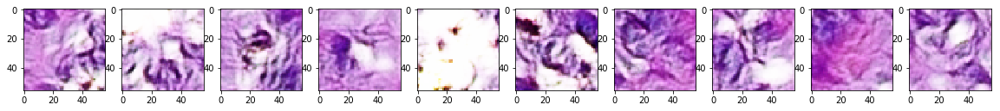

Epochs 1/5: Generator Loss: -4.8798. Discriminator Loss: 0.0002
Epochs 1/5: Generator Loss: -5.1193. Discriminator Loss: -0.1804
Epochs 1/5: Generator Loss: -6.4975. Discriminator Loss: -0.3226
Epochs 1/5: Generator Loss: 8.0272. Discriminator Loss: -0.1579
Epochs 1/5: Generator Loss: 4.5954. Discriminator Loss: -0.2981
Epochs 1/5: Generator Loss: -7.6721. Discriminator Loss: -0.339
Epochs 1/5: Generator Loss: 3.3028. Discriminator Loss: -0.302
Epochs 1/5: Generator Loss: 2.5484. Discriminator Loss: -0.1945
Epochs 1/5: Generator Loss: -4.3564. Discriminator Loss: -0.043
Epochs 1/5: Generator Loss: 6.3403. Discriminator Loss: -0.2877


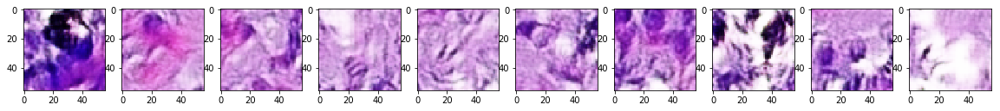

Epochs 1/5: Generator Loss: -4.5284. Discriminator Loss: -0.1155
Epochs 1/5: Generator Loss: -1.5383. Discriminator Loss: -0.0762
Epochs 1/5: Generator Loss: 11.7718. Discriminator Loss: -0.2344
Epochs 1/5: Generator Loss: -6.8365. Discriminator Loss: -0.1785
Epochs 1/5: Generator Loss: -5.1503. Discriminator Loss: -0.2918
Epochs 1/5: Generator Loss: 2.2901. Discriminator Loss: -0.3123
Epochs 1/5: Generator Loss: -0.6475. Discriminator Loss: -0.1573
Epochs 1/5: Generator Loss: 5.876. Discriminator Loss: -0.1773
Epochs 1/5: Generator Loss: -11.01. Discriminator Loss: -0.2823
Epochs 1/5: Generator Loss: 1.087. Discriminator Loss: -0.1328


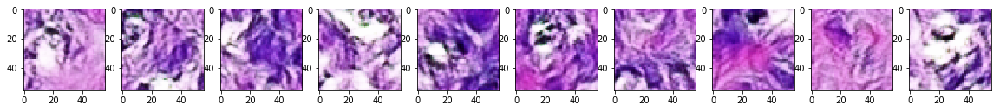

Epochs 1/5: Generator Loss: 2.0073. Discriminator Loss: -0.1521
Epochs 1/5: Generator Loss: -7.0523. Discriminator Loss: -0.2038
Epochs 1/5: Generator Loss: 3.3038. Discriminator Loss: -0.3094
Epochs 1/5: Generator Loss: -3.1515. Discriminator Loss: -0.0967
Epochs 1/5: Generator Loss: 4.5056. Discriminator Loss: -0.1723
Epochs 1/5: Generator Loss: -0.563. Discriminator Loss: -0.2498
Epochs 1/5: Generator Loss: -6.1246. Discriminator Loss: -0.0874
Epochs 1/5: Generator Loss: 1.5846. Discriminator Loss: -0.1801
Epochs 1/5: Generator Loss: 2.2251. Discriminator Loss: -0.2006
Epochs 1/5: Generator Loss: -1.002. Discriminator Loss: -0.1414


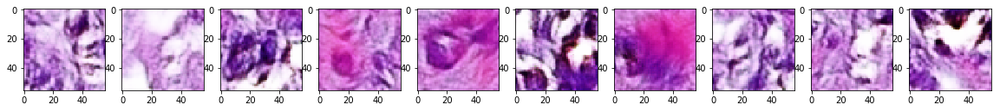

Epochs 1/5: Generator Loss: 1.3792. Discriminator Loss: -0.103
Epochs 1/5: Generator Loss: -1.5787. Discriminator Loss: -0.1531
Epochs 1/5: Generator Loss: -0.1472. Discriminator Loss: -0.1201
Epochs 1/5: Generator Loss: -2.4937. Discriminator Loss: -0.1312
Epochs 1/5: Generator Loss: -0.3735. Discriminator Loss: -0.0665
Epochs 1/5: Generator Loss: 1.8818. Discriminator Loss: -0.2418
Epochs 1/5: Generator Loss: -1.1259. Discriminator Loss: -0.1491
Epochs 1/5: Generator Loss: -2.0782. Discriminator Loss: -0.2838
Epochs 1/5: Generator Loss: 1.1262. Discriminator Loss: -0.1732
Epochs 1/5: Generator Loss: 2.423. Discriminator Loss: -0.1892


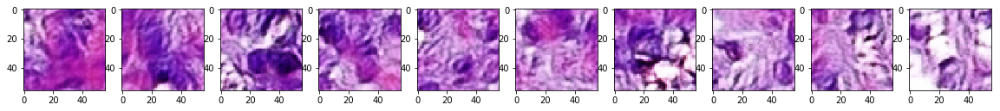

Epochs 1/5: Generator Loss: -3.5355. Discriminator Loss: -0.1412
Epochs 1/5: Generator Loss: -6.4353. Discriminator Loss: -0.1732
Epochs 1/5: Generator Loss: 6.271. Discriminator Loss: -0.1979
Epochs 1/5: Generator Loss: -2.7774. Discriminator Loss: -0.2222
Epochs 1/5: Generator Loss: 0.7628. Discriminator Loss: -0.108
Epochs 1/5: Generator Loss: -7.7858. Discriminator Loss: -0.1732
Epochs 1/5: Generator Loss: 2.0233. Discriminator Loss: -0.1779
Epochs 1/5: Generator Loss: 5.5976. Discriminator Loss: -0.3946
Epochs 1/5: Generator Loss: -4.587. Discriminator Loss: -0.1862
Epochs 1/5: Generator Loss: 7.0819. Discriminator Loss: -0.1802


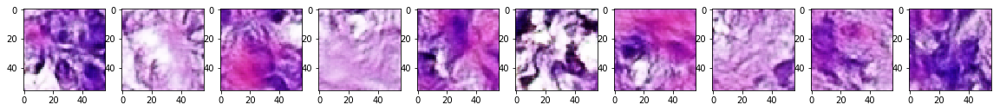

Epochs 1/5: Generator Loss: 0.5917. Discriminator Loss: -0.0754
Epochs 1/5: Generator Loss: -3.4963. Discriminator Loss: -0.1674
Epochs 1/5: Generator Loss: 1.3529. Discriminator Loss: -0.1874
Epochs 1/5: Generator Loss: -2.7678. Discriminator Loss: -0.1435
Epochs 1/5: Generator Loss: -0.5187. Discriminator Loss: -0.0725
Epochs 1/5: Generator Loss: -0.2611. Discriminator Loss: -0.1932
Epochs 1/5: Generator Loss: -0.9523. Discriminator Loss: -0.062
Epochs 1/5: Generator Loss: -3.3731. Discriminator Loss: -0.1765
Epochs 1/5: Generator Loss: 3.4998. Discriminator Loss: -0.0342
Epochs 1/5: Generator Loss: -1.0152. Discriminator Loss: -0.0624


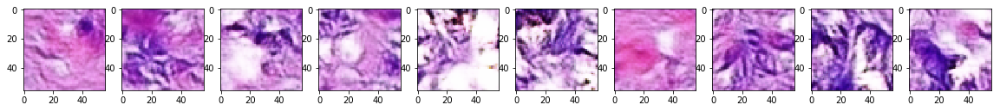

Epochs 1/5: Generator Loss: 4.2716. Discriminator Loss: -0.1299
Epochs 1/5: Generator Loss: -1.5965. Discriminator Loss: -0.0998
Epochs 1/5: Generator Loss: 2.9846. Discriminator Loss: -0.1168
Epochs 1/5: Generator Loss: -0.6475. Discriminator Loss: -0.1738
Epochs 1/5: Generator Loss: -4.6989. Discriminator Loss: -0.2158
Epochs 1/5: Generator Loss: 1.3531. Discriminator Loss: -0.1978
Epochs 1/5: Generator Loss: 3.5907. Discriminator Loss: -0.233
Epochs 1/5: Generator Loss: -2.8857. Discriminator Loss: -0.2488
Epochs 1/5: Generator Loss: -5.5601. Discriminator Loss: -0.2384
Epochs 1/5: Generator Loss: 0.4081. Discriminator Loss: -0.0499


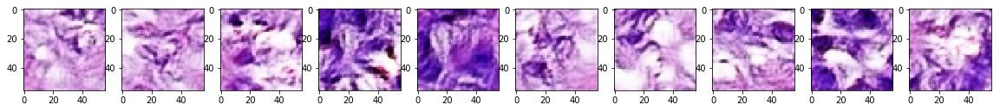

Epochs 1/5: Generator Loss: 0.7588. Discriminator Loss: -0.102
Epochs 1/5: Generator Loss: -1.7671. Discriminator Loss: -0.0717
Epochs 1/5: Generator Loss: -5.9808. Discriminator Loss: -0.0474
Epochs 1/5: Generator Loss: 8.7847. Discriminator Loss: -0.2017
Epochs 1/5: Generator Loss: -4.7472. Discriminator Loss: -0.1477
Epochs 1/5: Generator Loss: -1.3106. Discriminator Loss: -0.0695
Epochs 1/5: Generator Loss: 4.0231. Discriminator Loss: -0.2303
Epochs 1/5: Generator Loss: -7.9528. Discriminator Loss: -0.1893
Epochs 1/5: Generator Loss: 1.4032. Discriminator Loss: -0.1026
Epochs 1/5: Generator Loss: 5.2454. Discriminator Loss: -0.2213


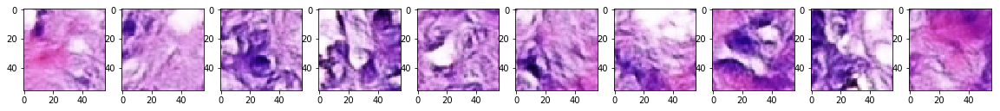

Epochs 1/5: Generator Loss: -6.3898. Discriminator Loss: -0.1997
Epochs 1/5: Generator Loss: -2.8052. Discriminator Loss: -0.1773
Epochs 1/5: Generator Loss: 7.2462. Discriminator Loss: -0.171
Epochs 1/5: Generator Loss: -1.2439. Discriminator Loss: -0.2079
Epochs 1/5: Generator Loss: 2.0959. Discriminator Loss: -0.0812
Epochs 1/5: Generator Loss: 1.0786. Discriminator Loss: 0.0522
Epochs 1/5: Generator Loss: 3.8514. Discriminator Loss: -0.3129
Epochs 1/5: Generator Loss: 0.2265. Discriminator Loss: -0.1053
Epochs 1/5: Generator Loss: 7.4427. Discriminator Loss: -0.1653
Epochs 1/5: Generator Loss: 2.4591. Discriminator Loss: -0.1322


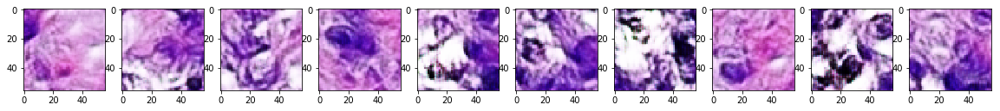

Epochs 1/5: Generator Loss: -3.1558. Discriminator Loss: -0.0627
Epochs 1/5: Generator Loss: 4.3345. Discriminator Loss: -0.2593
Epochs 1/5: Generator Loss: 1.6015. Discriminator Loss: 0.0103
Epochs 1/5: Generator Loss: 1.7444. Discriminator Loss: -0.2056
Epochs 1/5: Generator Loss: -2.7812. Discriminator Loss: -0.1521
Epochs 1/5: Generator Loss: -4.2217. Discriminator Loss: -0.1816
Epochs 1/5: Generator Loss: 10.8066. Discriminator Loss: -0.0691
Epochs 1/5: Generator Loss: -0.2484. Discriminator Loss: -0.1238
Epochs 1/5: Generator Loss: -2.5413. Discriminator Loss: -0.0299
Epochs 1/5: Generator Loss: 1.029. Discriminator Loss: -0.1767


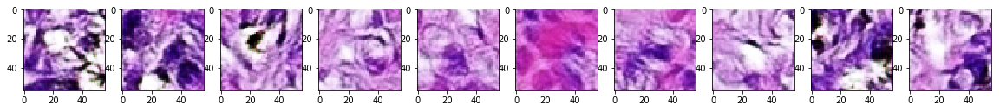

Epochs 1/5: Generator Loss: 1.8003. Discriminator Loss: -0.1764
Epochs 1/5: Generator Loss: -0.6495. Discriminator Loss: -0.1018
Epochs 1/5: Generator Loss: 2.2026. Discriminator Loss: -0.2681
Epochs 1/5: Generator Loss: -1.3022. Discriminator Loss: -0.0451
Epochs 1/5: Generator Loss: 1.3565. Discriminator Loss: -0.1533
Epochs 1/5: Generator Loss: -7.9252. Discriminator Loss: -0.0946
Epochs 1/5: Generator Loss: -2.6438. Discriminator Loss: -0.0396
Epochs 1/5: Generator Loss: 4.1278. Discriminator Loss: -0.051
Epochs 1/5: Generator Loss: -5.0596. Discriminator Loss: -0.182
Epochs 1/5: Generator Loss: -0.1324. Discriminator Loss: -0.1247


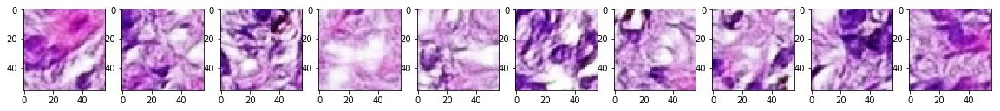

Epochs 1/5: Generator Loss: 3.9983. Discriminator Loss: -0.0847
Epochs 1/5: Generator Loss: -0.1756. Discriminator Loss: -0.105
Epochs 1/5: Generator Loss: -3.1094. Discriminator Loss: -0.2572
Epochs 1/5: Generator Loss: 0.5893. Discriminator Loss: -0.1104
Epochs 1/5: Generator Loss: -3.9538. Discriminator Loss: -0.1527
Epochs 1/5: Generator Loss: -0.6823. Discriminator Loss: -0.1724
Epochs 1/5: Generator Loss: -4.4989. Discriminator Loss: -0.33
Epochs 1/5: Generator Loss: 5.7375. Discriminator Loss: -0.0481
Epochs 1/5: Generator Loss: 3.3868. Discriminator Loss: -0.2199
Epochs 1/5: Generator Loss: -2.1364. Discriminator Loss: -0.0673


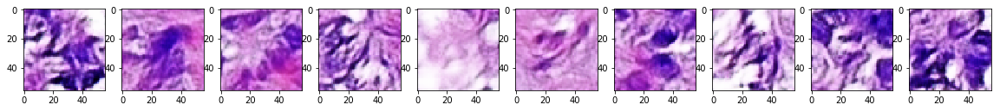

Epochs 1/5: Generator Loss: 0.7245. Discriminator Loss: -0.0827
Epochs 1/5: Generator Loss: -0.9151. Discriminator Loss: -0.2174
Epochs 1/5: Generator Loss: 1.9188. Discriminator Loss: -0.1443
Epochs 1/5: Generator Loss: 2.1394. Discriminator Loss: -0.3375
Epochs 1/5: Generator Loss: 0.0845. Discriminator Loss: -0.3191
Epochs 1/5: Generator Loss: -6.4244. Discriminator Loss: -0.1989
Epochs 1/5: Generator Loss: -0.4834. Discriminator Loss: -0.1827
Epochs 1/5: Generator Loss: 2.4473. Discriminator Loss: -0.0966
Epochs 1/5: Generator Loss: 4.9027. Discriminator Loss: -0.1778
Epochs 1/5: Generator Loss: -6.9329. Discriminator Loss: -0.2687


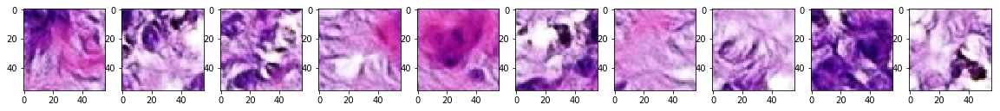

Epochs 1/5: Generator Loss: -3.788. Discriminator Loss: -0.3393
Epochs 1/5: Generator Loss: 5.1171. Discriminator Loss: -0.2468
Epochs 1/5: Generator Loss: 1.4235. Discriminator Loss: -0.1887
Epochs 1/5: Generator Loss: -2.5057. Discriminator Loss: -0.1365
Epochs 1/5: Generator Loss: -5.4706. Discriminator Loss: -0.1973
Epochs 1/5: Generator Loss: 0.3103. Discriminator Loss: -0.2564
Epochs 1/5: Generator Loss: 4.7865. Discriminator Loss: -0.0937
Epochs 1/5: Generator Loss: -1.2568. Discriminator Loss: -0.1205
Epochs 1/5: Generator Loss: -5.8445. Discriminator Loss: -0.2687
Epochs 1/5: Generator Loss: 1.3819. Discriminator Loss: -0.2313


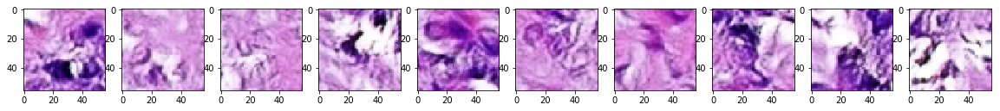

Epochs 1/5: Generator Loss: 0.0143. Discriminator Loss: -0.1495
Epochs 1/5: Generator Loss: 2.8158. Discriminator Loss: -0.1708
Epochs 1/5: Generator Loss: -2.7995. Discriminator Loss: -0.3021
Epochs 1/5: Generator Loss: 2.6803. Discriminator Loss: -0.1576
Epochs 1/5: Generator Loss: -5.2404. Discriminator Loss: -0.2394
Epochs 1/5: Generator Loss: 4.7653. Discriminator Loss: -0.1509
Epochs 1/5: Generator Loss: -0.0651. Discriminator Loss: -0.1245
Epochs 1/5: Generator Loss: 1.4998. Discriminator Loss: -0.1535
Epochs 1/5: Generator Loss: 3.6895. Discriminator Loss: -0.2156
Epochs 1/5: Generator Loss: -5.2025. Discriminator Loss: -0.2005


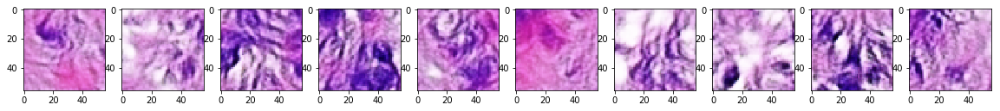

Epochs 1/5: Generator Loss: -1.5049. Discriminator Loss: -0.1101
Epochs 1/5: Generator Loss: -0.0412. Discriminator Loss: -0.2739
Epochs 1/5: Generator Loss: -1.8644. Discriminator Loss: -0.0336
Epochs 1/5: Generator Loss: -0.1301. Discriminator Loss: -0.1577
Epochs 1/5: Generator Loss: 2.0146. Discriminator Loss: -0.1362
Epochs 1/5: Generator Loss: -0.2675. Discriminator Loss: -0.1114
Epochs 1/5: Generator Loss: -2.5134. Discriminator Loss: 0.0109
Epochs 1/5: Generator Loss: -0.6864. Discriminator Loss: -0.1951
Epochs 1/5: Generator Loss: -1.0213. Discriminator Loss: -0.0846
Epochs 1/5: Generator Loss: -3.5782. Discriminator Loss: -0.0453


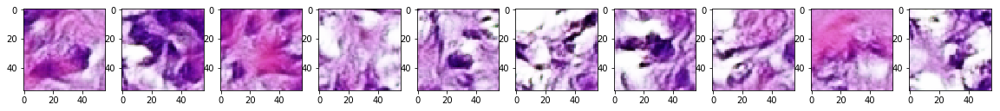

Epochs 1/5: Generator Loss: -1.6253. Discriminator Loss: 0.0145
Epochs 1/5: Generator Loss: 2.5945. Discriminator Loss: 0.1545
Epochs 1/5: Generator Loss: 1.073. Discriminator Loss: -0.229
Epochs 1/5: Generator Loss: -4.2462. Discriminator Loss: -0.2196
Epochs 1/5: Generator Loss: -1.1824. Discriminator Loss: -0.1231
Epochs 1/5: Generator Loss: 1.2886. Discriminator Loss: -0.1499
Epochs 1/5: Generator Loss: 4.9019. Discriminator Loss: -0.1823
Epochs 1/5: Generator Loss: -3.1711. Discriminator Loss: -0.171
Epochs 1/5: Generator Loss: -3.7624. Discriminator Loss: -0.1567
Epochs 1/5: Generator Loss: 2.2866. Discriminator Loss: -0.1506


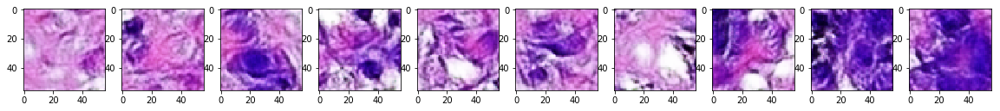

Epochs 1/5: Generator Loss: -7.7053. Discriminator Loss: -0.1682
Epochs 1/5: Generator Loss: -3.9237. Discriminator Loss: -0.2687
Epochs 1/5: Generator Loss: 0.8263. Discriminator Loss: -0.3752
Epochs 1/5: Generator Loss: 6.7131. Discriminator Loss: -0.1814
Epochs 1/5: Generator Loss: -3.2501. Discriminator Loss: -0.1589
Epochs 1/5: Generator Loss: -5.9378. Discriminator Loss: -0.2242
Epochs 1/5: Generator Loss: -1.4242. Discriminator Loss: -0.0692
Epochs 1/5: Generator Loss: -5.8771. Discriminator Loss: -0.0765
Epochs 1/5: Generator Loss: 1.2487. Discriminator Loss: -0.066
Epochs 1/5: Generator Loss: 5.8208. Discriminator Loss: -0.1063


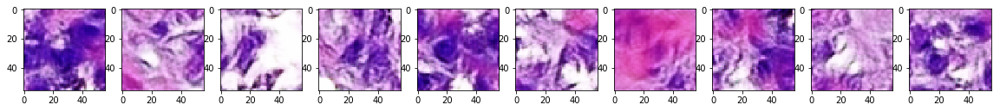

Epochs 1/5: Generator Loss: 1.4988. Discriminator Loss: -0.2031
Epochs 1/5: Generator Loss: -8.0615. Discriminator Loss: -0.1224
Epochs 1/5: Generator Loss: 11.2308. Discriminator Loss: -0.2164
Epochs 1/5: Generator Loss: -0.7674. Discriminator Loss: -0.0212
Epochs 1/5: Generator Loss: -7.0768. Discriminator Loss: -0.1392
Epochs 1/5: Generator Loss: 0.2983. Discriminator Loss: -0.075
Epochs 1/5: Generator Loss: -5.7825. Discriminator Loss: -0.1343
Epochs 1/5: Generator Loss: 3.7387. Discriminator Loss: -0.1826
Epochs 1/5: Generator Loss: -2.117. Discriminator Loss: -0.1168
Epochs 1/5: Generator Loss: -1.3351. Discriminator Loss: -0.1267


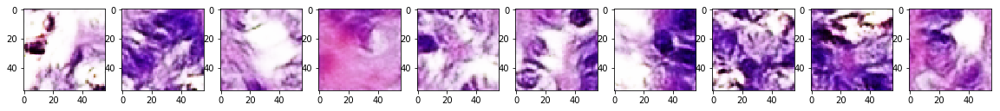

Epochs 1/5: Generator Loss: 4.3634. Discriminator Loss: -0.0707
Epochs 1/5: Generator Loss: -5.2773. Discriminator Loss: -0.2633
Epochs 1/5: Generator Loss: 1.1711. Discriminator Loss: -0.0711
Epochs 1/5: Generator Loss: -2.1712. Discriminator Loss: -0.0432
Epochs 1/5: Generator Loss: -1.921. Discriminator Loss: -0.1674
Epochs 1/5: Generator Loss: 5.8696. Discriminator Loss: -0.0355
Epochs 1/5: Generator Loss: -5.3105. Discriminator Loss: -0.2859
Epochs 1/5: Generator Loss: -0.0031. Discriminator Loss: -0.2761
Epochs 1/5: Generator Loss: 2.612. Discriminator Loss: -0.2104
Epochs 1/5: Generator Loss: -5.7451. Discriminator Loss: -0.3537


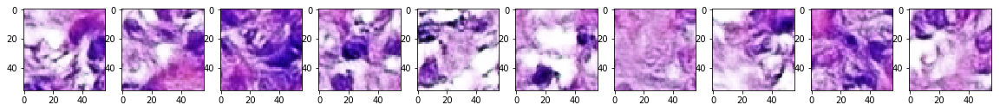

Epochs 1/5: Generator Loss: -2.8944. Discriminator Loss: -0.2436
Epochs 1/5: Generator Loss: 5.6899. Discriminator Loss: -0.1644
Epochs 1/5: Generator Loss: -2.3426. Discriminator Loss: -0.2563
Epochs 1/5: Generator Loss: -1.1034. Discriminator Loss: -0.168
Epochs 1/5: Generator Loss: 4.8298. Discriminator Loss: -0.1389
Epochs 1/5: Generator Loss: -2.5023. Discriminator Loss: -0.0056
Epochs 1/5: Generator Loss: -5.1974. Discriminator Loss: -0.1376
Epochs 1/5: Generator Loss: -2.958. Discriminator Loss: -0.1837
Epochs 1/5: Generator Loss: 4.7411. Discriminator Loss: -0.1277
Epochs 1/5: Generator Loss: -8.1629. Discriminator Loss: -0.1381


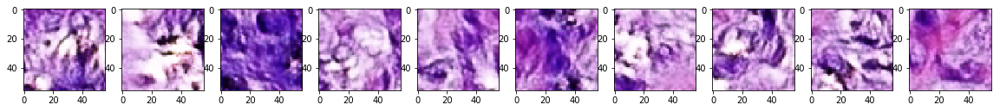

Epochs 1/5: Generator Loss: -0.4391. Discriminator Loss: -0.1063
Epochs 1/5: Generator Loss: 4.1853. Discriminator Loss: -0.0619
Epochs 1/5: Generator Loss: 2.786. Discriminator Loss: -0.1803
Epochs 1/5: Generator Loss: 6.547. Discriminator Loss: -0.1364
Epochs 1/5: Generator Loss: -8.0041. Discriminator Loss: -0.2982
Epochs 1/5: Generator Loss: -2.5941. Discriminator Loss: -0.1154
Epochs 1/5: Generator Loss: -1.3797. Discriminator Loss: -0.1788
Epochs 1/5: Generator Loss: 1.6928. Discriminator Loss: -0.1226
Epochs 1/5: Generator Loss: -4.0619. Discriminator Loss: -0.2378
Epochs 1/5: Generator Loss: -0.5398. Discriminator Loss: -0.1443


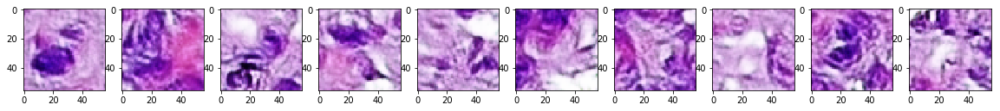

Epochs 1/5: Generator Loss: 3.2315. Discriminator Loss: -0.1222
Epochs 1/5: Generator Loss: -3.335. Discriminator Loss: -0.2363
Epochs 1/5: Generator Loss: -4.8774. Discriminator Loss: -0.1663
Epochs 1/5: Generator Loss: 4.1202. Discriminator Loss: -0.1757
Epochs 1/5: Generator Loss: 2.8003. Discriminator Loss: -0.2073
Epochs 1/5: Generator Loss: -6.5418. Discriminator Loss: -0.2294
Epochs 1/5: Generator Loss: 3.2168. Discriminator Loss: -0.0681
Epochs 1/5: Generator Loss: -5.3229. Discriminator Loss: -0.1935
Epochs 1/5: Generator Loss: -1.2243. Discriminator Loss: -0.14
Epochs 1/5: Generator Loss: 4.2567. Discriminator Loss: -0.1489


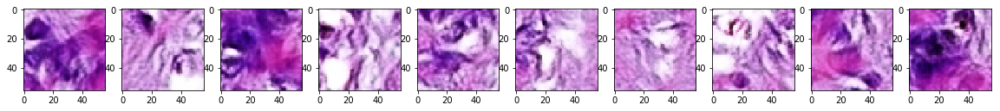

Epochs 1/5: Generator Loss: -3.2727. Discriminator Loss: -0.1596
Epochs 1/5: Generator Loss: -1.1041. Discriminator Loss: -0.2239
Epochs 1/5: Generator Loss: 16.8566. Discriminator Loss: -0.4295
Epochs 1/5: Generator Loss: -2.4722. Discriminator Loss: -0.2447
Epochs 1/5: Generator Loss: -1.5187. Discriminator Loss: -0.2021
Epochs 1/5: Generator Loss: -3.2952. Discriminator Loss: -0.0804
Epochs 1/5: Generator Loss: 10.4587. Discriminator Loss: -0.1663
Epochs 1/5: Generator Loss: 1.0971. Discriminator Loss: -0.1087
Epochs 1/5: Generator Loss: -1.7704. Discriminator Loss: -0.1508
Epochs 1/5: Generator Loss: -2.5399. Discriminator Loss: -0.2449


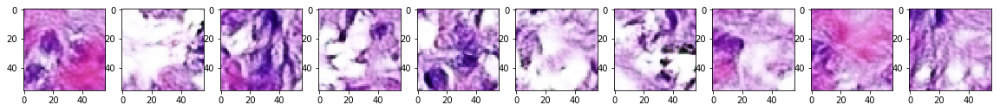

Epochs 1/5: Generator Loss: -1.9929. Discriminator Loss: -0.0846
Epochs 1/5: Generator Loss: -2.6488. Discriminator Loss: -0.0444
Epochs 1/5: Generator Loss: -0.638. Discriminator Loss: -0.185
Epochs 1/5: Generator Loss: 5.3591. Discriminator Loss: -0.0952
Epochs 1/5: Generator Loss: -0.8375. Discriminator Loss: -0.1486
Epochs 1/5: Generator Loss: -4.2108. Discriminator Loss: -0.2681
Epochs 1/5: Generator Loss: 3.3584. Discriminator Loss: -0.1315
Epochs 1/5: Generator Loss: 2.4731. Discriminator Loss: -0.1318
Epochs 1/5: Generator Loss: 0.3078. Discriminator Loss: -0.1846
Epochs 1/5: Generator Loss: -0.2964. Discriminator Loss: -0.1687


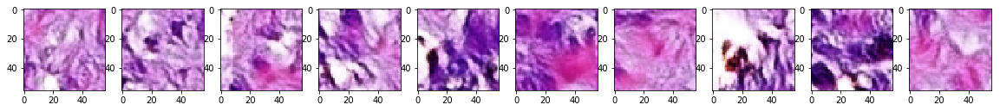

Epochs 1/5: Generator Loss: 1.1641. Discriminator Loss: -0.2399
Epochs 1/5: Generator Loss: -7.9571. Discriminator Loss: -0.0386
Epochs 1/5: Generator Loss: 14.9132. Discriminator Loss: -0.2397
Epochs 1/5: Generator Loss: 3.365. Discriminator Loss: -0.0919
Epochs 1/5: Generator Loss: -6.2198. Discriminator Loss: -0.1613
Epochs 1/5: Generator Loss: -4.9506. Discriminator Loss: -0.1555
Epochs 1/5: Generator Loss: 1.9211. Discriminator Loss: -0.1483
Epochs 1/5: Generator Loss: 3.0674. Discriminator Loss: -0.2328
Epochs 1/5: Generator Loss: -4.3797. Discriminator Loss: -0.1909
Epochs 1/5: Generator Loss: -2.77. Discriminator Loss: -0.2342


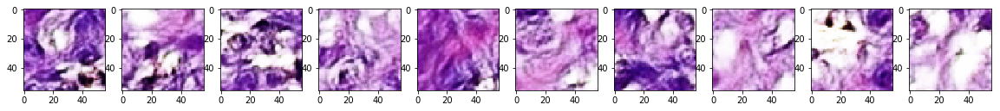

Epochs 1/5: Generator Loss: 2.3553. Discriminator Loss: -0.0438
Epochs 1/5: Generator Loss: -0.5768. Discriminator Loss: -0.0195
Epochs 1/5: Generator Loss: -6.5139. Discriminator Loss: -0.2131
Epochs 1/5: Generator Loss: 2.4323. Discriminator Loss: -0.1218
Epochs 1/5: Generator Loss: 6.2865. Discriminator Loss: -0.1014
Epochs 1/5: Generator Loss: 0.7438. Discriminator Loss: -0.2493
Epochs 1/5: Generator Loss: 2.0492. Discriminator Loss: -0.197
Epochs 1/5: Generator Loss: -3.5786. Discriminator Loss: -0.1126
Epochs 1/5: Generator Loss: -2.331. Discriminator Loss: -0.0359
Epochs 1/5: Generator Loss: 1.8788. Discriminator Loss: -0.0814


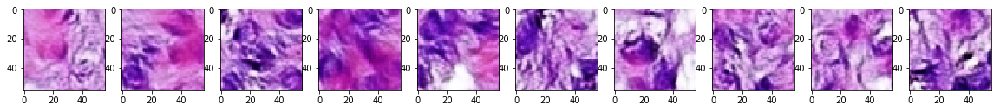

Epochs 1/5: Generator Loss: -0.8286. Discriminator Loss: -0.1732
Epochs 1/5: Generator Loss: -2.4203. Discriminator Loss: -0.3063
Epochs 1/5: Generator Loss: 4.3923. Discriminator Loss: -0.1796
Epochs 1/5: Generator Loss: 3.289. Discriminator Loss: -0.1483
Epochs 1/5: Generator Loss: -1.9468. Discriminator Loss: -0.2102
Epochs 1/5: Generator Loss: 2.2558. Discriminator Loss: -0.2262
Epochs 1/5: Generator Loss: -2.9011. Discriminator Loss: -0.105
Epochs 1/5: Generator Loss: 0.3292. Discriminator Loss: -0.1565
Epochs 1/5: Generator Loss: -2.0423. Discriminator Loss: -0.0811
Epochs 1/5: Generator Loss: 3.1049. Discriminator Loss: -0.1688


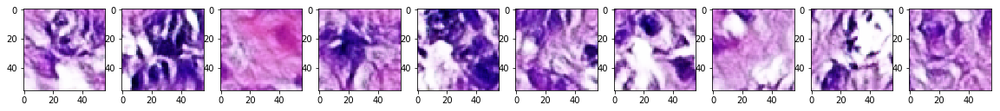

Epochs 1/5: Generator Loss: -7.0422. Discriminator Loss: -0.174
Epochs 1/5: Generator Loss: 2.2218. Discriminator Loss: -0.1928
Epochs 1/5: Generator Loss: -4.8205. Discriminator Loss: -0.0986
Epochs 1/5: Generator Loss: -1.8511. Discriminator Loss: -0.0779
Epochs 1/5: Generator Loss: -2.0205. Discriminator Loss: -0.2698
Epochs 1/5: Generator Loss: 1.117. Discriminator Loss: -0.1184
Epochs 1/5: Generator Loss: -5.6683. Discriminator Loss: -0.1538
Epochs 1/5: Generator Loss: -3.6227. Discriminator Loss: -0.2796
Epochs 1/5: Generator Loss: 1.185. Discriminator Loss: -0.3919
Epochs 1/5: Generator Loss: 6.3153. Discriminator Loss: -0.1632


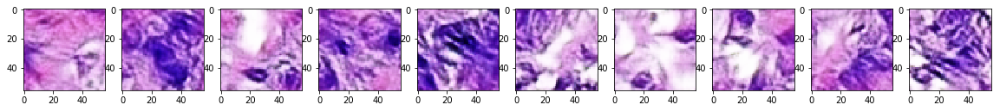

Epochs 1/5: Generator Loss: -4.4332. Discriminator Loss: -0.2482
Epochs 1/5: Generator Loss: -1.58. Discriminator Loss: -0.1736
Epochs 1/5: Generator Loss: -1.6142. Discriminator Loss: -0.2015
Epochs 1/5: Generator Loss: 2.2929. Discriminator Loss: -0.1214
Epochs 1/5: Generator Loss: 0.8834. Discriminator Loss: -0.2158
Epochs 1/5: Generator Loss: -2.4675. Discriminator Loss: -0.2156
Epochs 1/5: Generator Loss: -6.574. Discriminator Loss: -0.2334
Epochs 1/5: Generator Loss: -2.7122. Discriminator Loss: -0.0744
Epochs 1/5: Generator Loss: -1.8672. Discriminator Loss: -0.1287
Epochs 1/5: Generator Loss: -0.2671. Discriminator Loss: -0.1039


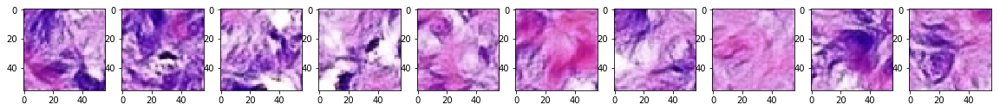

Epochs 1/5: Generator Loss: -4.2217. Discriminator Loss: -0.2195
Epochs 1/5: Generator Loss: -2.5475. Discriminator Loss: -0.1941
Epochs 1/5: Generator Loss: 0.6172. Discriminator Loss: -0.09
Epochs 1/5: Generator Loss: 1.1384. Discriminator Loss: -0.1748
Epochs 1/5: Generator Loss: 0.4359. Discriminator Loss: -0.1822
Epochs 1/5: Generator Loss: 4.1368. Discriminator Loss: -0.1624
Epochs 1/5: Generator Loss: -3.6119. Discriminator Loss: -0.0585
Epochs 1/5: Generator Loss: -1.1881. Discriminator Loss: -0.2895
Epochs 1/5: Generator Loss: -2.1207. Discriminator Loss: -0.121
Epochs 1/5: Generator Loss: 5.991. Discriminator Loss: -0.0044


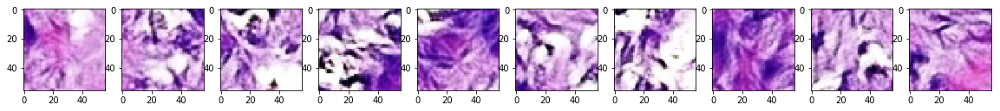

Epochs 1/5: Generator Loss: -2.7325. Discriminator Loss: -0.185
Epochs 1/5: Generator Loss: 7.1965. Discriminator Loss: -0.1778
Epochs 1/5: Generator Loss: -17.0138. Discriminator Loss: -0.079
Epochs 1/5: Generator Loss: -2.4699. Discriminator Loss: -0.082
Epochs 1/5: Generator Loss: 5.3522. Discriminator Loss: -0.1405
Epochs 1/5: Generator Loss: -7.7366. Discriminator Loss: -0.1629
Epochs 1/5: Generator Loss: -3.532. Discriminator Loss: -0.1568
Epochs 1/5: Generator Loss: -2.2136. Discriminator Loss: -0.1044
Epochs 1/5: Generator Loss: 3.302. Discriminator Loss: -0.2016
Epochs 1/5: Generator Loss: -1.4465. Discriminator Loss: -0.1982


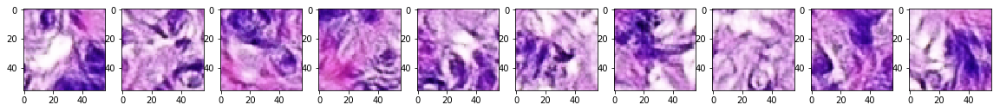

Epochs 1/5: Generator Loss: 2.4721. Discriminator Loss: -0.1027
Epochs 1/5: Generator Loss: 13.6792. Discriminator Loss: -0.3325
Epochs 1/5: Generator Loss: -5.6785. Discriminator Loss: -0.2057
Epochs 1/5: Generator Loss: 1.7075. Discriminator Loss: -0.2412
Epochs 1/5: Generator Loss: 1.4055. Discriminator Loss: -0.131
Epochs 1/5: Generator Loss: -1.0352. Discriminator Loss: -0.1367
Epochs 1/5: Generator Loss: 3.0646. Discriminator Loss: -0.2119
Epochs 1/5: Generator Loss: -0.2343. Discriminator Loss: -0.1856
Epochs 1/5: Generator Loss: -2.9004. Discriminator Loss: -0.1023
Epochs 1/5: Generator Loss: -4.0121. Discriminator Loss: -0.0038


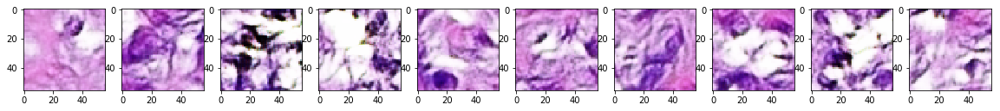

Epochs 1/5: Generator Loss: 8.4692. Discriminator Loss: -0.2594
Epochs 1/5: Generator Loss: 1.4974. Discriminator Loss: -0.0331
Epochs 1/5: Generator Loss: -2.9677. Discriminator Loss: -0.0725
Epochs 1/5: Generator Loss: 5.9278. Discriminator Loss: -0.1782
Epochs 1/5: Generator Loss: 1.8017. Discriminator Loss: -0.1805
Epochs 1/5: Generator Loss: -10.6479. Discriminator Loss: -0.1443
Epochs 1/5: Generator Loss: 1.0585. Discriminator Loss: -0.2091
Epochs 1/5: Generator Loss: 2.6528. Discriminator Loss: -0.218
Epochs 1/5: Generator Loss: -3.9542. Discriminator Loss: -0.0776
Epochs 1/5: Generator Loss: 1.7515. Discriminator Loss: -0.127


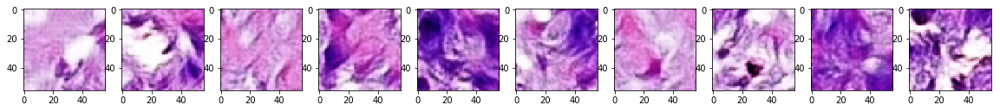

Epochs 1/5: Generator Loss: -2.3236. Discriminator Loss: -0.1108
Epochs 1/5: Generator Loss: -4.6101. Discriminator Loss: -0.121
Epochs 1/5: Generator Loss: 8.0088. Discriminator Loss: -0.019
Epochs 1/5: Generator Loss: -6.5633. Discriminator Loss: -0.0443
Epochs 1/5: Generator Loss: 1.4286. Discriminator Loss: -0.1048
Epochs 1/5: Generator Loss: 1.1035. Discriminator Loss: -0.0177
Epochs 1/5: Generator Loss: -2.0232. Discriminator Loss: -0.1107
Epochs 1/5: Generator Loss: -6.3831. Discriminator Loss: -0.2045
Epochs 1/5: Generator Loss: 5.6566. Discriminator Loss: -0.1474
Epochs 1/5: Generator Loss: 0.9038. Discriminator Loss: -0.1906


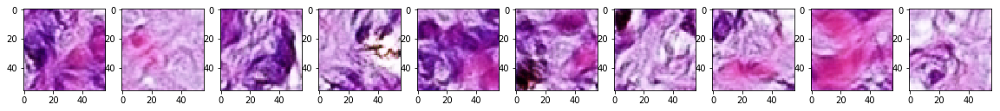

Epochs 1/5: Generator Loss: -5.0206. Discriminator Loss: -0.0027
Epochs 1/5: Generator Loss: 14.0037. Discriminator Loss: -0.1476
Epochs 1/5: Generator Loss: -1.6757. Discriminator Loss: -0.1132
Epochs 1/5: Generator Loss: -5.2082. Discriminator Loss: -0.2187
Epochs 1/5: Generator Loss: 2.1151. Discriminator Loss: -0.0415
Epochs 1/5: Generator Loss: -1.5006. Discriminator Loss: -0.1653
Epochs 1/5: Generator Loss: -1.6316. Discriminator Loss: -0.0774
Epochs 1/5: Generator Loss: -1.667. Discriminator Loss: -0.1843
Epochs 1/5: Generator Loss: 4.6761. Discriminator Loss: -0.0921
Epochs 1/5: Generator Loss: -3.0376. Discriminator Loss: -0.1771


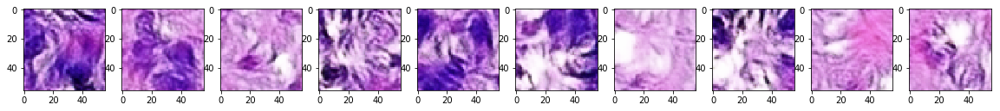

Epochs 1/5: Generator Loss: 2.6094. Discriminator Loss: -0.1752
Epochs 1/5: Generator Loss: 3.8135. Discriminator Loss: -0.0479
Epochs 1/5: Generator Loss: -2.3286. Discriminator Loss: -0.2214
Epochs 1/5: Generator Loss: 0.9063. Discriminator Loss: -0.1184
Epochs 1/5: Generator Loss: -2.645. Discriminator Loss: -0.0897
Epochs 1/5: Generator Loss: -1.6. Discriminator Loss: -0.085
Epochs 1/5: Generator Loss: -0.3136. Discriminator Loss: -0.1178
Epochs 1/5: Generator Loss: -2.8953. Discriminator Loss: 0.0594
Epochs 1/5: Generator Loss: 3.8683. Discriminator Loss: -0.0461
Epochs 1/5: Generator Loss: -6.6167. Discriminator Loss: -0.0502


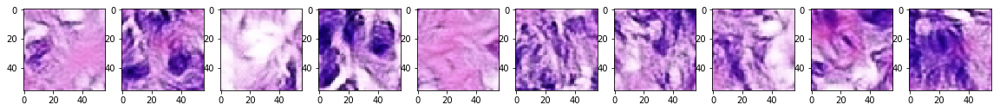

Epochs 1/5: Generator Loss: -5.8402. Discriminator Loss: -0.2615
Epochs 1/5: Generator Loss: 5.5901. Discriminator Loss: -0.1866
Epochs 1/5: Generator Loss: 2.7139. Discriminator Loss: -0.1709
Epochs 1/5: Generator Loss: -3.5423. Discriminator Loss: -0.0683
Epochs 1/5: Generator Loss: -1.2484. Discriminator Loss: -0.1365
Epochs 1/5: Generator Loss: 4.0721. Discriminator Loss: -0.1153
Epochs 1/5: Generator Loss: -3.8047. Discriminator Loss: -0.2007
Epochs 1/5: Generator Loss: -0.0143. Discriminator Loss: -0.2077
Epochs 1/5: Generator Loss: -8.4401. Discriminator Loss: -0.1798
Epochs 1/5: Generator Loss: 9.9852. Discriminator Loss: -0.1751


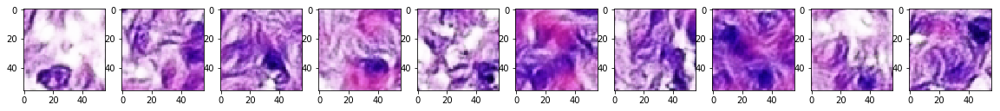

Epochs 1/5: Generator Loss: -1.5269. Discriminator Loss: -0.1693
Epochs 1/5: Generator Loss: -7.9054. Discriminator Loss: -0.1934
Epochs 1/5: Generator Loss: 0.2102. Discriminator Loss: -0.0764
Epochs 1/5: Generator Loss: 3.2905. Discriminator Loss: -0.1364
Epochs 1/5: Generator Loss: -0.225. Discriminator Loss: -0.0504
Epochs 1/5: Generator Loss: -1.7864. Discriminator Loss: -0.1161
Epochs 1/5: Generator Loss: -0.657. Discriminator Loss: -0.1051
Epochs 1/5: Generator Loss: 8.315. Discriminator Loss: -0.183
Epochs 1/5: Generator Loss: -1.1193. Discriminator Loss: -0.0968
Epochs 1/5: Generator Loss: -1.3092. Discriminator Loss: -0.103


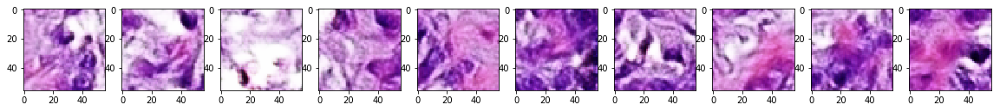

Epochs 1/5: Generator Loss: 2.4823. Discriminator Loss: -0.1979
Epochs 1/5: Generator Loss: -1.8632. Discriminator Loss: -0.201
Epochs 1/5: Generator Loss: -3.8607. Discriminator Loss: -0.1238
Epochs 1/5: Generator Loss: 5.0909. Discriminator Loss: -0.0978
Epochs 1/5: Generator Loss: 2.2794. Discriminator Loss: -0.3258
Epochs 1/5: Generator Loss: 10.2924. Discriminator Loss: -0.2875
Epochs 1/5: Generator Loss: -9.9212. Discriminator Loss: -0.091
Epochs 1/5: Generator Loss: -0.131. Discriminator Loss: -0.2039
Epochs 1/5: Generator Loss: 2.178. Discriminator Loss: -0.1856
Epochs 1/5: Generator Loss: 2.5823. Discriminator Loss: -0.1366


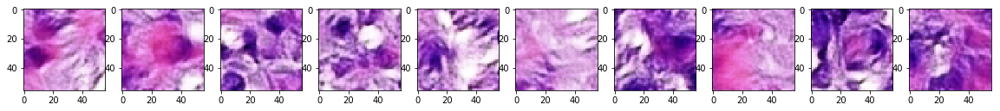

Epochs 1/5: Generator Loss: -4.9701. Discriminator Loss: -0.1608
Epochs 1/5: Generator Loss: -5.0728. Discriminator Loss: -0.1883
Epochs 1/5: Generator Loss: 2.0328. Discriminator Loss: -0.0452
Epochs 1/5: Generator Loss: 4.9139. Discriminator Loss: 0.0177
Epochs 1/5: Generator Loss: -1.2973. Discriminator Loss: -0.1144
Epochs 1/5: Generator Loss: -5.7894. Discriminator Loss: -0.2277
Epochs 1/5: Generator Loss: 1.2382. Discriminator Loss: -0.2761
Epochs 1/5: Generator Loss: 4.8212. Discriminator Loss: -0.1707
Epochs 1/5: Generator Loss: -1.1214. Discriminator Loss: -0.2364
Epochs 1/5: Generator Loss: 1.6608. Discriminator Loss: -0.0844


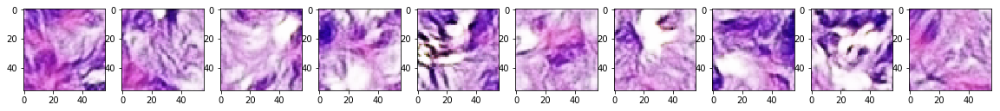

Epochs 1/5: Generator Loss: 4.8736. Discriminator Loss: -0.1606
Epochs 1/5: Generator Loss: -5.1805. Discriminator Loss: -0.2094
Epochs 1/5: Generator Loss: -0.6815. Discriminator Loss: -0.1164
Epochs 1/5: Generator Loss: 3.1108. Discriminator Loss: -0.1544
Epochs 1/5: Generator Loss: -0.6725. Discriminator Loss: -0.1712
Epochs 1/5: Generator Loss: -2.4576. Discriminator Loss: -0.0789
Epochs 1/5: Generator Loss: -1.4632. Discriminator Loss: -0.1362
Epochs 1/5: Generator Loss: 2.5407. Discriminator Loss: -0.0579
Epochs 1/5: Generator Loss: -0.466. Discriminator Loss: -0.1808
Epochs 1/5: Generator Loss: 0.3391. Discriminator Loss: -0.1548


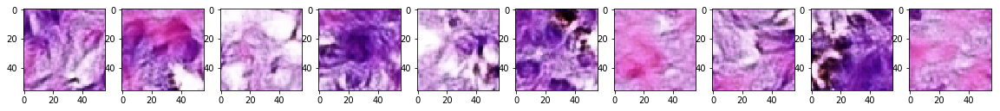

Epochs 1/5: Generator Loss: 5.4688. Discriminator Loss: -0.0978
Epochs 1/5: Generator Loss: -7.2455. Discriminator Loss: -0.122
Epochs 1/5: Generator Loss: -2.0168. Discriminator Loss: -0.0974
Epochs 1/5: Generator Loss: 3.5955. Discriminator Loss: -0.0985
Epochs 1/5: Generator Loss: -3.686. Discriminator Loss: -0.1117
Epochs 1/5: Generator Loss: 5.1059. Discriminator Loss: -0.1818
Epochs 1/5: Generator Loss: 2.076. Discriminator Loss: -0.0082
Epochs 1/5: Generator Loss: -4.3682. Discriminator Loss: -0.3814
Epochs 1/5: Generator Loss: -14.7574. Discriminator Loss: -0.275
Epochs 1/5: Generator Loss: 11.8811. Discriminator Loss: -0.109


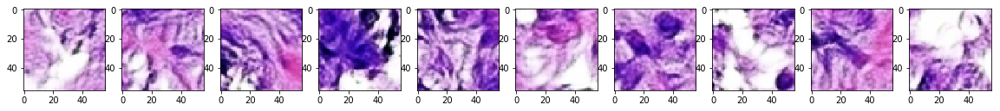

Epochs 1/5: Generator Loss: -4.0646. Discriminator Loss: -0.154
Epochs 1/5: Generator Loss: -6.6743. Discriminator Loss: -0.2235
Epochs 1/5: Generator Loss: -3.8401. Discriminator Loss: -0.1127
Epochs 1/5: Generator Loss: 1.004. Discriminator Loss: -0.1293
Epochs 1/5: Generator Loss: 1.2127. Discriminator Loss: -0.08
Epochs 1/5: Generator Loss: -0.6787. Discriminator Loss: -0.1266
Epochs 1/5: Generator Loss: -12.5696. Discriminator Loss: -0.1635
Epochs 1/5: Generator Loss: 0.2339. Discriminator Loss: 0.0039
Epochs 1/5: Generator Loss: 5.3551. Discriminator Loss: -0.2407
Epochs 1/5: Generator Loss: -3.9197. Discriminator Loss: -0.1856


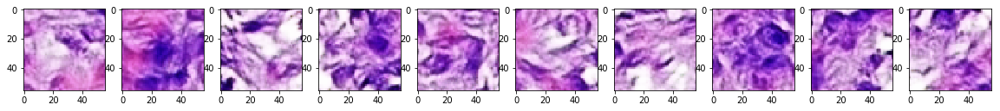

Epochs 1/5: Generator Loss: -4.2626. Discriminator Loss: -0.0391
Epochs 1/5: Generator Loss: 3.1698. Discriminator Loss: -0.1593
Epochs 1/5: Generator Loss: -1.89. Discriminator Loss: -0.2132
Epochs 1/5: Generator Loss: -1.6994. Discriminator Loss: -0.2508
Epochs 1/5: Generator Loss: -3.7169. Discriminator Loss: -0.1156
Epochs 1/5: Generator Loss: 0.7261. Discriminator Loss: -0.1416
Epochs 1/5: Generator Loss: 3.9548. Discriminator Loss: -0.0135
Epochs 1/5: Generator Loss: -2.314. Discriminator Loss: -0.1312
Epochs 1/5: Generator Loss: -5.1102. Discriminator Loss: -0.0945
Epochs 1/5: Generator Loss: 6.0178. Discriminator Loss: -0.1285


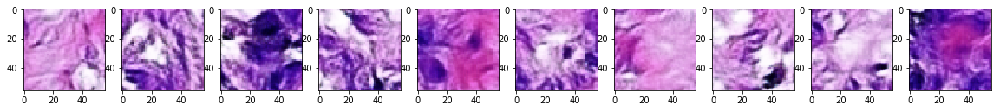

Epochs 1/5: Generator Loss: -3.5155. Discriminator Loss: -0.2494
Epochs 1/5: Generator Loss: 5.2279. Discriminator Loss: -0.1511
Epochs 1/5: Generator Loss: -6.12. Discriminator Loss: -0.1638
Epochs 1/5: Generator Loss: -2.5494. Discriminator Loss: -0.2192
Epochs 1/5: Generator Loss: 7.0182. Discriminator Loss: -0.0824
Epochs 1/5: Generator Loss: 6.9602. Discriminator Loss: -0.255
Epochs 1/5: Generator Loss: -21.0105. Discriminator Loss: -0.2413
Epochs 1/5: Generator Loss: 2.2735. Discriminator Loss: -0.0829
Epochs 1/5: Generator Loss: 1.3995. Discriminator Loss: -0.3093
Epochs 1/5: Generator Loss: -4.8037. Discriminator Loss: -0.036


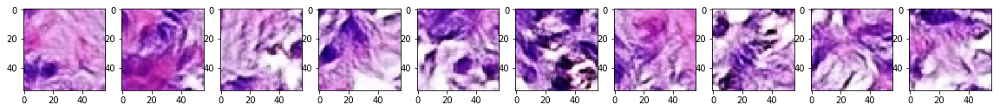

Epochs 1/5: Generator Loss: -0.9901. Discriminator Loss: -0.1168
Epochs 1/5: Generator Loss: 3.2025. Discriminator Loss: -0.073
Epochs 1/5: Generator Loss: -5.0435. Discriminator Loss: -0.1466
Epochs 1/5: Generator Loss: -5.1207. Discriminator Loss: -0.1186
Epochs 1/5: Generator Loss: 9.5251. Discriminator Loss: -0.0755
Epochs 1/5: Generator Loss: 0.2373. Discriminator Loss: -0.0413
Epochs 1/5: Generator Loss: -5.4835. Discriminator Loss: -0.1749
Epochs 1/5: Generator Loss: 0.3623. Discriminator Loss: -0.1689
Epochs 1/5: Generator Loss: 2.7089. Discriminator Loss: -0.1333
Epochs 1/5: Generator Loss: 3.7591. Discriminator Loss: -0.2751


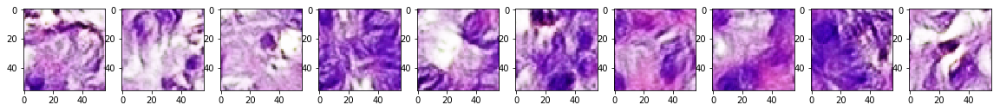

Epochs 1/5: Generator Loss: -4.2962. Discriminator Loss: -0.1862
Epochs 1/5: Generator Loss: -3.4801. Discriminator Loss: -0.2433
Epochs 1/5: Generator Loss: 3.7659. Discriminator Loss: -0.153
Epochs 1/5: Generator Loss: 2.7072. Discriminator Loss: -0.0744
Epochs 1/5: Generator Loss: 0.381. Discriminator Loss: -0.1983
Epochs 1/5: Generator Loss: -2.0993. Discriminator Loss: -0.1216
Epochs 1/5: Generator Loss: -2.3089. Discriminator Loss: -0.2055
Epochs 1/5: Generator Loss: 3.4191. Discriminator Loss: -0.1479
Epochs 1/5: Generator Loss: -7.0016. Discriminator Loss: -0.1594
Epochs 1/5: Generator Loss: 4.0336. Discriminator Loss: -0.1206


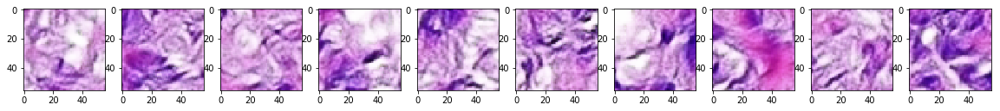

Epochs 1/5: Generator Loss: -6.539. Discriminator Loss: -0.1585
Epochs 1/5: Generator Loss: 0.1113. Discriminator Loss: -0.173
Epochs 1/5: Generator Loss: 5.1746. Discriminator Loss: -0.1805
Epochs 1/5: Generator Loss: -0.548. Discriminator Loss: -0.1765
Epochs 1/5: Generator Loss: -2.2672. Discriminator Loss: -0.1554
Epochs 1/5: Generator Loss: 0.3616. Discriminator Loss: -0.0763
Epochs 1/5: Generator Loss: 1.7573. Discriminator Loss: -0.2053
Epochs 1/5: Generator Loss: 1.3671. Discriminator Loss: -0.1228
Epochs 1/5: Generator Loss: -12.642. Discriminator Loss: -0.3189
Epochs 1/5: Generator Loss: 4.9831. Discriminator Loss: -0.283


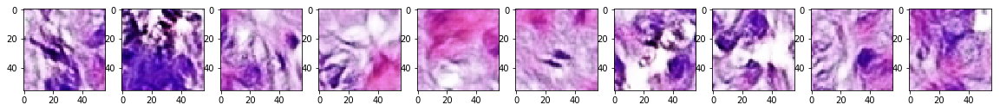

Epochs 1/5: Generator Loss: 2.4121. Discriminator Loss: -0.2715
Epochs 1/5: Generator Loss: 3.5867. Discriminator Loss: -0.1674
Epochs 1/5: Generator Loss: -6.6. Discriminator Loss: -0.1508
Epochs 1/5: Generator Loss: -0.15. Discriminator Loss: -0.1207
Epochs 1/5: Generator Loss: 8.4483. Discriminator Loss: 0.047
Epochs 1/5: Generator Loss: -5.2974. Discriminator Loss: -0.1428
Epochs 1/5: Generator Loss: -11.2166. Discriminator Loss: -0.1535
Epochs 1/5: Generator Loss: 4.7057. Discriminator Loss: -0.1355
Epochs 1/5: Generator Loss: 5.8141. Discriminator Loss: -0.1076
Epochs 1/5: Generator Loss: -13.6214. Discriminator Loss: -0.2505


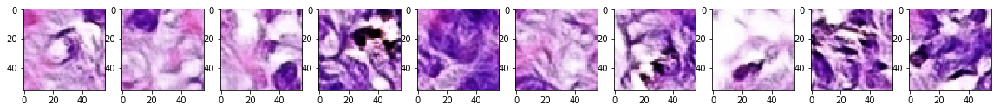

Epochs 1/5: Generator Loss: 1.642. Discriminator Loss: -0.0938
Epochs 1/5: Generator Loss: -1.3811. Discriminator Loss: -0.1321
Epochs 1/5: Generator Loss: -0.6147. Discriminator Loss: -0.1115
Epochs 1/5: Generator Loss: -6.086. Discriminator Loss: -0.0641
Epochs 1/5: Generator Loss: 9.5919. Discriminator Loss: -0.1609
Epochs 1/5: Generator Loss: -4.1857. Discriminator Loss: -0.0697
Epochs 1/5: Generator Loss: -2.3824. Discriminator Loss: -0.071
Epochs 1/5: Generator Loss: 4.7458. Discriminator Loss: -0.2098
Epochs 1/5: Generator Loss: -2.3635. Discriminator Loss: -0.1787
Epochs 1/5: Generator Loss: -3.9861. Discriminator Loss: -0.0989


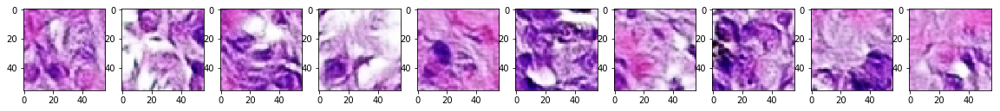

Epochs 1/5: Generator Loss: -0.008. Discriminator Loss: -0.1019
Epochs 1/5: Generator Loss: 3.135. Discriminator Loss: -0.1911
Epochs 1/5: Generator Loss: -11.9527. Discriminator Loss: -0.2036
Epochs 1/5: Generator Loss: 8.2274. Discriminator Loss: -0.2635
Epochs 1/5: Generator Loss: -2.4266. Discriminator Loss: -0.1477
Epochs 1/5: Generator Loss: -2.3177. Discriminator Loss: -0.1957
Epochs 1/5: Generator Loss: 6.2866. Discriminator Loss: -0.1223
Epochs 1/5: Generator Loss: -0.4341. Discriminator Loss: -0.1148
Epochs 1/5: Generator Loss: -4.8915. Discriminator Loss: -0.2091
Epochs 1/5: Generator Loss: 1.328. Discriminator Loss: -0.2506


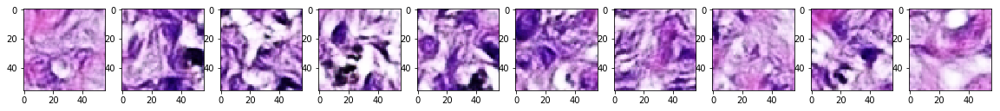

Epochs 1/5: Generator Loss: -0.3441. Discriminator Loss: -0.1912
Epochs 1/5: Generator Loss: 1.3301. Discriminator Loss: -0.1195
Epochs 1/5: Generator Loss: -3.3692. Discriminator Loss: -0.1985
Epochs 1/5: Generator Loss: -5.0295. Discriminator Loss: -0.0565
Epochs 1/5: Generator Loss: 3.2149. Discriminator Loss: -0.1517
Epochs 1/5: Generator Loss: 5.1343. Discriminator Loss: -0.2838
Epochs 1/5: Generator Loss: 6.7788. Discriminator Loss: -0.265
Epochs 1/5: Generator Loss: -8.1502. Discriminator Loss: -0.171
Epochs 1/5: Generator Loss: 0.4322. Discriminator Loss: -0.1149
Epochs 1/5: Generator Loss: 4.4124. Discriminator Loss: -0.1844


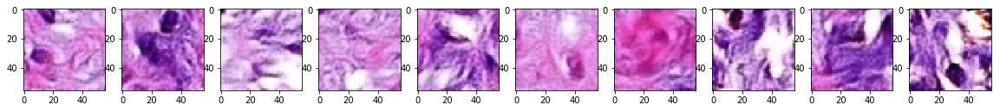

Epochs 1/5: Generator Loss: 1.065. Discriminator Loss: -0.1816
Epochs 1/5: Generator Loss: -0.263. Discriminator Loss: -0.0743
Epochs 1/5: Generator Loss: 2.3161. Discriminator Loss: -0.2698
Epochs 1/5: Generator Loss: 8.0607. Discriminator Loss: -0.0478
Epochs 1/5: Generator Loss: -1.5098. Discriminator Loss: -0.1222
Epochs 1/5: Generator Loss: 1.7268. Discriminator Loss: -0.0996
Epochs 1/5: Generator Loss: -0.0042. Discriminator Loss: -0.0513
Epochs 1/5: Generator Loss: -11.5653. Discriminator Loss: -0.2499
Epochs 1/5: Generator Loss: 1.8011. Discriminator Loss: -0.1512
Epochs 1/5: Generator Loss: 1.0759. Discriminator Loss: -0.2377


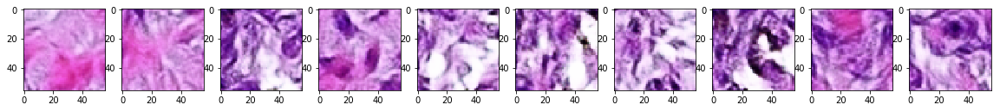

Epochs 1/5: Generator Loss: 4.4822. Discriminator Loss: -0.109
Epochs 1/5: Generator Loss: -11.0411. Discriminator Loss: -0.1731
Epochs 1/5: Generator Loss: 2.9045. Discriminator Loss: -0.0982
Epochs 1/5: Generator Loss: 2.6872. Discriminator Loss: -0.1729
Epochs 1/5: Generator Loss: -2.7454. Discriminator Loss: -0.1942
Epochs 1/5: Generator Loss: -3.4928. Discriminator Loss: -0.1359
Epochs 1/5: Generator Loss: 4.6431. Discriminator Loss: -0.2028
Epochs 1/5: Generator Loss: 1.1611. Discriminator Loss: -0.1868
Epochs 1/5: Generator Loss: -6.6364. Discriminator Loss: -0.1024
Epochs 1/5: Generator Loss: 2.7035. Discriminator Loss: -0.0447


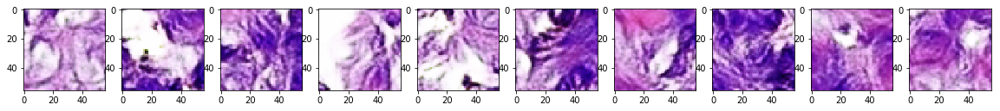

Epochs 1/5: Generator Loss: -3.2955. Discriminator Loss: -0.2408
Epochs 1/5: Generator Loss: -4.008. Discriminator Loss: -0.2345
Epochs 1/5: Generator Loss: 3.6864. Discriminator Loss: -0.2437
Epochs 1/5: Generator Loss: 3.461. Discriminator Loss: -0.2158
Epochs 1/5: Generator Loss: -4.0595. Discriminator Loss: -0.1642
Epochs 1/5: Generator Loss: 2.6472. Discriminator Loss: -0.2399
Epochs 1/5: Generator Loss: -6.036. Discriminator Loss: -0.1804
Epochs 1/5: Generator Loss: 4.8456. Discriminator Loss: -0.051
Epochs 1/5: Generator Loss: 3.1801. Discriminator Loss: -0.1261
Epochs 1/5: Generator Loss: -8.9809. Discriminator Loss: -0.16


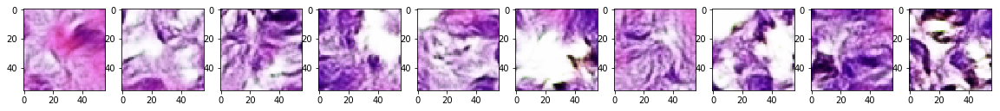

Epochs 1/5: Generator Loss: 0.3392. Discriminator Loss: -0.2267
Epochs 1/5: Generator Loss: 2.8323. Discriminator Loss: 0.0164
Epochs 1/5: Generator Loss: -2.792. Discriminator Loss: -0.081
Epochs 1/5: Generator Loss: -0.946. Discriminator Loss: -0.1222
Epochs 1/5: Generator Loss: 7.049. Discriminator Loss: -0.2008
Epochs 1/5: Generator Loss: 2.0896. Discriminator Loss: -0.1905
Epochs 1/5: Generator Loss: -5.9815. Discriminator Loss: -0.0576
Epochs 1/5: Generator Loss: -1.9196. Discriminator Loss: -0.2189
Epochs 1/5: Generator Loss: 5.6743. Discriminator Loss: 0.0187
Epochs 1/5: Generator Loss: -0.2419. Discriminator Loss: -0.126


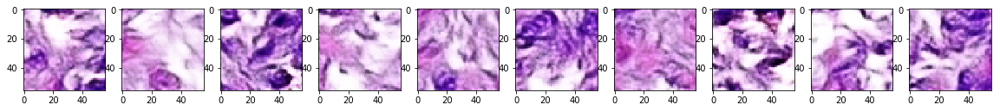

Epochs 1/5: Generator Loss: -3.6159. Discriminator Loss: -0.2746
Epochs 1/5: Generator Loss: -0.7364. Discriminator Loss: -0.1753
Epochs 1/5: Generator Loss: -3.4983. Discriminator Loss: -0.2002
Epochs 1/5: Generator Loss: 1.7949. Discriminator Loss: -0.0496
Epochs 1/5: Generator Loss: 4.9865. Discriminator Loss: -0.1077
Epochs 1/5: Generator Loss: -6.4227. Discriminator Loss: -0.2579
Epochs 1/5: Generator Loss: -3.4396. Discriminator Loss: -0.0327
Epochs 1/5: Generator Loss: 3.1112. Discriminator Loss: 0.0024
Epochs 1/5: Generator Loss: -5.444. Discriminator Loss: -0.1337
Epochs 1/5: Generator Loss: 7.4272. Discriminator Loss: -0.2004


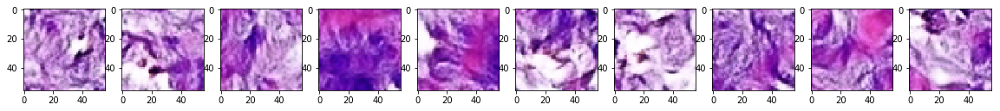

Epochs 1/5: Generator Loss: 1.9392. Discriminator Loss: -0.1597
Epochs 1/5: Generator Loss: 1.1158. Discriminator Loss: -0.1451
Epochs 1/5: Generator Loss: -2.0471. Discriminator Loss: -0.1443
Epochs 1/5: Generator Loss: -1.9958. Discriminator Loss: -0.0217
Epochs 1/5: Generator Loss: 0.4874. Discriminator Loss: -0.0462
Epochs 1/5: Generator Loss: 2.3747. Discriminator Loss: -0.0755
Epochs 1/5: Generator Loss: 2.674. Discriminator Loss: -0.2856
Epochs 1/5: Generator Loss: -14.7094. Discriminator Loss: -0.1302
Epochs 1/5: Generator Loss: -1.612. Discriminator Loss: -0.2059
Epochs 1/5: Generator Loss: 4.4312. Discriminator Loss: -0.1132


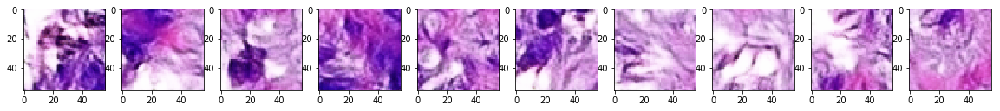

Epochs 1/5: Generator Loss: -6.0323. Discriminator Loss: -0.1344
Epochs 1/5: Generator Loss: -2.3226. Discriminator Loss: -0.1355
Epochs 1/5: Generator Loss: -0.3076. Discriminator Loss: -0.2129
Epochs 1/5: Generator Loss: 0.0092. Discriminator Loss: -0.1138
Epochs 1/5: Generator Loss: -3.7892. Discriminator Loss: -0.2565
Epochs 1/5: Generator Loss: 0.1453. Discriminator Loss: -0.1659
Epochs 1/5: Generator Loss: -5.5007. Discriminator Loss: -0.1804
Epochs 1/5: Generator Loss: 6.7204. Discriminator Loss: -0.2123
Epochs 1/5: Generator Loss: -5.6499. Discriminator Loss: -0.135
Epochs 1/5: Generator Loss: -2.3164. Discriminator Loss: -0.1327


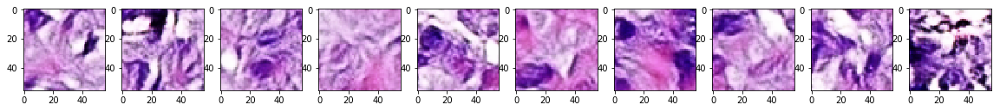

Epochs 1/5: Generator Loss: 9.1659. Discriminator Loss: -0.2018
Epochs 1/5: Generator Loss: -2.219. Discriminator Loss: -0.1852
Epochs 1/5: Generator Loss: 0.3033. Discriminator Loss: -0.1281
Epochs 1/5: Generator Loss: -3.0045. Discriminator Loss: -0.1645
Epochs 1/5: Generator Loss: -2.0867. Discriminator Loss: -0.1357
Epochs 1/5: Generator Loss: 2.1295. Discriminator Loss: -0.1799
Epochs 1/5: Generator Loss: 2.0235. Discriminator Loss: -0.1544
Epochs 1/5: Generator Loss: -3.6381. Discriminator Loss: -0.0741
Epochs 1/5: Generator Loss: 9.4623. Discriminator Loss: -0.0482
Epochs 1/5: Generator Loss: 4.5669. Discriminator Loss: -0.2212


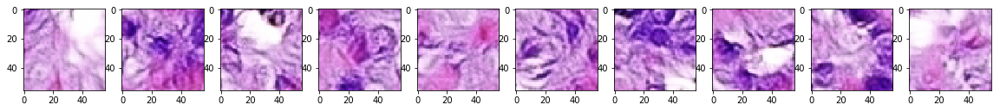

Epochs 1/5: Generator Loss: -3.5239. Discriminator Loss: -0.2234
Epochs 1/5: Generator Loss: -3.6244. Discriminator Loss: -0.0963
Epochs 1/5: Generator Loss: 4.9689. Discriminator Loss: -0.1777
Epochs 1/5: Generator Loss: 1.1254. Discriminator Loss: -0.2479
Epochs 1/5: Generator Loss: -0.4827. Discriminator Loss: -0.1301
Epochs 1/5: Generator Loss: -1.7247. Discriminator Loss: -0.1105
Epochs 1/5: Generator Loss: -4.9707. Discriminator Loss: -0.111
Epochs 1/5: Generator Loss: 5.6174. Discriminator Loss: -0.1281
Epochs 1/5: Generator Loss: 1.9973. Discriminator Loss: -0.1598
Epochs 1/5: Generator Loss: -4.9342. Discriminator Loss: -0.1993


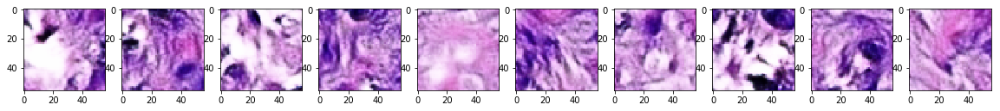

Epochs 1/5: Generator Loss: -1.3681. Discriminator Loss: -0.1284
Epochs 1/5: Generator Loss: 1.8441. Discriminator Loss: -0.1495
Epochs 1/5: Generator Loss: -11.8471. Discriminator Loss: -0.2364
Epochs 1/5: Generator Loss: 2.9373. Discriminator Loss: -0.1623
Epochs 1/5: Generator Loss: 0.1615. Discriminator Loss: -0.1853
Epochs 1/5: Generator Loss: 3.0278. Discriminator Loss: -0.182
Epochs 1/5: Generator Loss: -2.1003. Discriminator Loss: -0.152
Epochs 1/5: Generator Loss: -6.572. Discriminator Loss: -0.1573
Epochs 1/5: Generator Loss: 4.4171. Discriminator Loss: -0.0928
Epochs 1/5: Generator Loss: 5.0098. Discriminator Loss: -0.2173


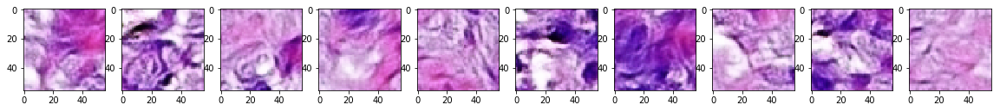

Epochs 1/5: Generator Loss: -3.0567. Discriminator Loss: -0.2384
Epochs 1/5: Generator Loss: -6.2914. Discriminator Loss: -0.1749
Epochs 1/5: Generator Loss: 0.7384. Discriminator Loss: -0.309
Epochs 1/5: Generator Loss: 6.3968. Discriminator Loss: -0.0985
Epochs 1/5: Generator Loss: -5.9912. Discriminator Loss: -0.0956
Epochs 1/5: Generator Loss: -2.2824. Discriminator Loss: -0.0828
Epochs 1/5: Generator Loss: 0.8778. Discriminator Loss: -0.2366
Epochs 1/5: Generator Loss: 4.6976. Discriminator Loss: -0.0673
Epochs 1/5: Generator Loss: -6.0497. Discriminator Loss: 0.0274
Epochs 1/5: Generator Loss: -4.7312. Discriminator Loss: -0.2053


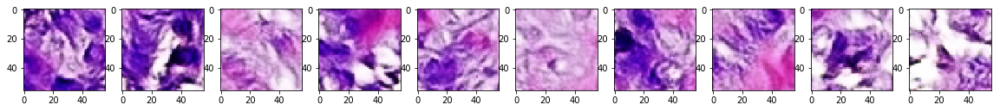

Epochs 1/5: Generator Loss: -3.6233. Discriminator Loss: -0.1393
Epochs 1/5: Generator Loss: 12.8528. Discriminator Loss: -0.0265
Epochs 1/5: Generator Loss: 2.0885. Discriminator Loss: -0.0938
Epochs 1/5: Generator Loss: -4.1118. Discriminator Loss: -0.3016
Epochs 1/5: Generator Loss: 15.2198. Discriminator Loss: -0.1955
Epochs 1/5: Generator Loss: -18.7696. Discriminator Loss: -0.007
Epochs 1/5: Generator Loss: -3.0948. Discriminator Loss: -0.0409
Epochs 1/5: Generator Loss: 0.6792. Discriminator Loss: -0.0864
Epochs 1/5: Generator Loss: 0.6818. Discriminator Loss: -0.2037
Epochs 1/5: Generator Loss: -4.6394. Discriminator Loss: -0.1997


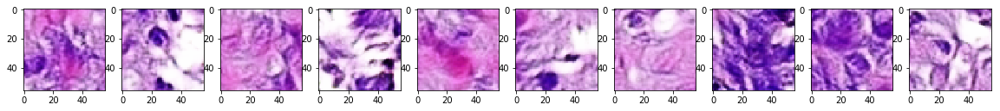

Epochs 1/5: Generator Loss: 0.2454. Discriminator Loss: -0.0253
Epochs 1/5: Generator Loss: 6.3933. Discriminator Loss: -0.1509
Epochs 1/5: Generator Loss: -1.8319. Discriminator Loss: -0.2228
Epochs 1/5: Generator Loss: 0.5627. Discriminator Loss: -0.2799
Epochs 1/5: Generator Loss: 7.9647. Discriminator Loss: -0.1836
Epochs 1/5: Generator Loss: -2.1391. Discriminator Loss: -0.2161
Epochs 1/5: Generator Loss: -6.1891. Discriminator Loss: -0.1014
Epochs 1/5: Generator Loss: 6.8915. Discriminator Loss: -0.1904
Epochs 1/5: Generator Loss: 4.1786. Discriminator Loss: -0.1848
Epochs 1/5: Generator Loss: -4.9954. Discriminator Loss: -0.1782


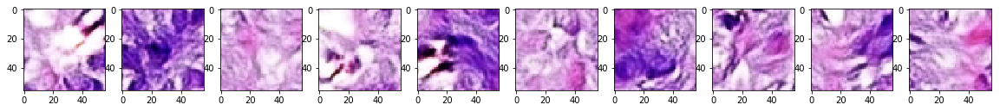

Epochs 1/5: Generator Loss: -1.8537. Discriminator Loss: -0.3
Epochs 1/5: Generator Loss: 3.712. Discriminator Loss: -0.2113
Epochs 1/5: Generator Loss: -3.2068. Discriminator Loss: -0.0882
Epochs 1/5: Generator Loss: -0.8007. Discriminator Loss: -0.1075
Epochs 1/5: Generator Loss: -0.259. Discriminator Loss: -0.158
Epochs 1/5: Generator Loss: -6.8066. Discriminator Loss: -0.1665
Epochs 1/5: Generator Loss: 1.8852. Discriminator Loss: -0.1065
Epochs 1/5: Generator Loss: 1.9588. Discriminator Loss: -0.0342
Epochs 1/5: Generator Loss: -6.0469. Discriminator Loss: -0.1753
Epochs 1/5: Generator Loss: -3.979. Discriminator Loss: -0.1496


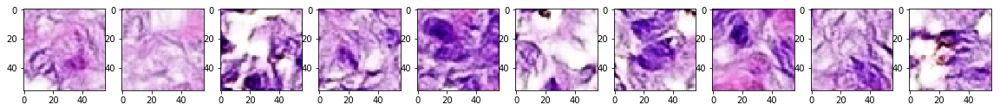

Epochs 1/5: Generator Loss: -0.2927. Discriminator Loss: -0.0918
Epochs 1/5: Generator Loss: 3.4975. Discriminator Loss: -0.2582
Epochs 1/5: Generator Loss: 0.1598. Discriminator Loss: -0.0981
Epochs 1/5: Generator Loss: -1.5732. Discriminator Loss: -0.1627
Epochs 1/5: Generator Loss: 0.8892. Discriminator Loss: -0.0816
Epochs 1/5: Generator Loss: -2.6624. Discriminator Loss: -0.1739
Epochs 1/5: Generator Loss: 5.5838. Discriminator Loss: -0.0995
Epochs 1/5: Generator Loss: -14.2648. Discriminator Loss: -0.0774
Epochs 1/5: Generator Loss: 14.0216. Discriminator Loss: -0.1448
Epochs 1/5: Generator Loss: 2.145. Discriminator Loss: -0.1838


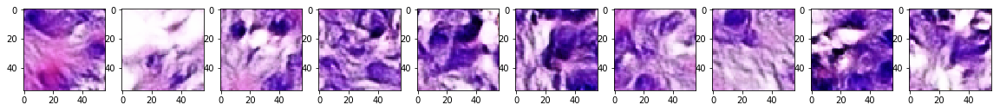

Epochs 1/5: Generator Loss: -6.6113. Discriminator Loss: -0.1198
Epochs 1/5: Generator Loss: -1.944. Discriminator Loss: -0.1602
Epochs 1/5: Generator Loss: 10.7346. Discriminator Loss: -0.2713
Epochs 1/5: Generator Loss: 1.4003. Discriminator Loss: -0.1248
Epochs 1/5: Generator Loss: -1.7986. Discriminator Loss: -0.1848
Epochs 1/5: Generator Loss: 3.9581. Discriminator Loss: -0.1813
Epochs 1/5: Generator Loss: 3.3218. Discriminator Loss: -0.1109
Epochs 1/5: Generator Loss: -9.6939. Discriminator Loss: -0.257
Epochs 1/5: Generator Loss: 13.8517. Discriminator Loss: -0.3017
Epochs 1/5: Generator Loss: -0.7578. Discriminator Loss: -0.1726


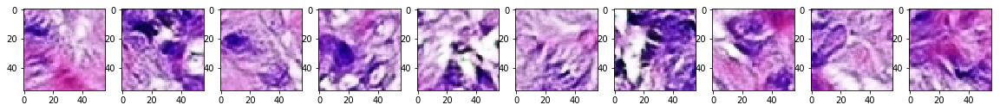

Epochs 1/5: Generator Loss: -2.5238. Discriminator Loss: -0.1536
Epochs 1/5: Generator Loss: 6.8704. Discriminator Loss: -0.1594
Epochs 1/5: Generator Loss: -7.4179. Discriminator Loss: -0.1875
Epochs 1/5: Generator Loss: 1.9338. Discriminator Loss: -0.1616
Epochs 1/5: Generator Loss: 4.8429. Discriminator Loss: -0.0905
Epochs 1/5: Generator Loss: -5.8566. Discriminator Loss: -0.1526
Epochs 1/5: Generator Loss: 5.5339. Discriminator Loss: -0.287
Epochs 1/5: Generator Loss: 0.8029. Discriminator Loss: -0.2688
Epochs 1/5: Generator Loss: -15.2176. Discriminator Loss: -0.1771
Epochs 1/5: Generator Loss: 6.0408. Discriminator Loss: -0.2874


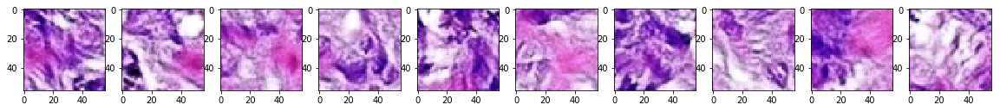

Epochs 1/5: Generator Loss: -1.0197. Discriminator Loss: -0.1628
Epochs 1/5: Generator Loss: -5.4901. Discriminator Loss: -0.1937
Epochs 1/5: Generator Loss: 0.4355. Discriminator Loss: -0.1526
Epochs 1/5: Generator Loss: 2.2452. Discriminator Loss: -0.2177
Epochs 1/5: Generator Loss: -6.0439. Discriminator Loss: -0.1955
Epochs 1/5: Generator Loss: 3.7366. Discriminator Loss: -0.1821
Epochs 1/5: Generator Loss: 1.7299. Discriminator Loss: -0.1304
Epochs 1/5: Generator Loss: 1.3771. Discriminator Loss: -0.2225
Epochs 1/5: Generator Loss: -3.3845. Discriminator Loss: -0.0908
Epochs 1/5: Generator Loss: -0.1717. Discriminator Loss: -0.2959


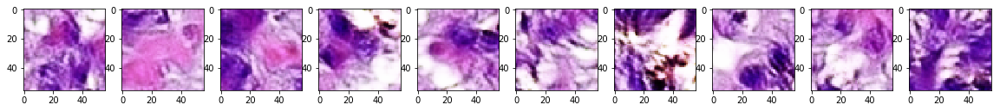

Epochs 1/5: Generator Loss: 1.7737. Discriminator Loss: -0.2057
Epochs 1/5: Generator Loss: -0.0838. Discriminator Loss: -0.0781
Epochs 1/5: Generator Loss: -4.11. Discriminator Loss: -0.1261
Epochs 1/5: Generator Loss: 2.9311. Discriminator Loss: -0.1172
Epochs 1/5: Generator Loss: 3.9386. Discriminator Loss: -0.1279
Epochs 1/5: Generator Loss: -6.2976. Discriminator Loss: -0.0335
Epochs 1/5: Generator Loss: -0.2311. Discriminator Loss: -0.1009
Epochs 1/5: Generator Loss: -3.0587. Discriminator Loss: -0.1556
Epochs 1/5: Generator Loss: 0.0618. Discriminator Loss: -0.1113
Epochs 1/5: Generator Loss: 5.5776. Discriminator Loss: -0.1201


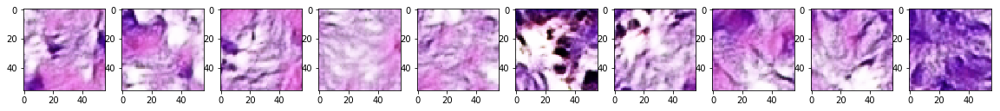

Epochs 1/5: Generator Loss: -4.8093. Discriminator Loss: -0.1702
Epochs 1/5: Generator Loss: -5.3371. Discriminator Loss: -0.1031
Epochs 1/5: Generator Loss: 2.3732. Discriminator Loss: -0.1646
Epochs 1/5: Generator Loss: 0.1401. Discriminator Loss: -0.2222
Epochs 1/5: Generator Loss: 4.0115. Discriminator Loss: -0.1522
Epochs 1/5: Generator Loss: -0.4432. Discriminator Loss: -0.1094
Epochs 1/5: Generator Loss: -11.4626. Discriminator Loss: -0.131
Epochs 1/5: Generator Loss: 10.52. Discriminator Loss: -0.1812
Epochs 1/5: Generator Loss: 1.0516. Discriminator Loss: -0.2088
Epochs 1/5: Generator Loss: -6.1975. Discriminator Loss: -0.1316


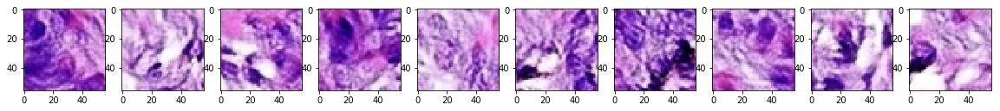

Epochs 1/5: Generator Loss: -2.0021. Discriminator Loss: -0.1045
Epochs 1/5: Generator Loss: 7.3544. Discriminator Loss: -0.1476
Epochs 1/5: Generator Loss: -5.3795. Discriminator Loss: -0.1419
Epochs 1/5: Generator Loss: -3.9325. Discriminator Loss: -0.106
Epochs 1/5: Generator Loss: -7.4982. Discriminator Loss: -0.1515
Epochs 1/5: Generator Loss: 10.3308. Discriminator Loss: -0.1043
Epochs 1/5: Generator Loss: -1.5448. Discriminator Loss: -0.0921
Epochs 1/5: Generator Loss: -3.1551. Discriminator Loss: -0.0349
Epochs 1/5: Generator Loss: -1.3722. Discriminator Loss: -0.147
Epochs 1/5: Generator Loss: 0.1139. Discriminator Loss: -0.1041


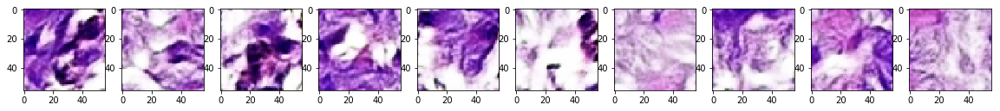

Epochs 1/5: Generator Loss: -2.6688. Discriminator Loss: 0.1415
Epochs 1/5: Generator Loss: 2.3199. Discriminator Loss: -0.1314
Epochs 2/5: Generator Loss: 1.9096. Discriminator Loss: -0.1449
Epochs 2/5: Generator Loss: -2.3309. Discriminator Loss: -0.1474
Epochs 2/5: Generator Loss: 3.6024. Discriminator Loss: -0.0839
Epochs 2/5: Generator Loss: 0.295. Discriminator Loss: -0.0679
Epochs 2/5: Generator Loss: -3.2737. Discriminator Loss: -0.1394
Epochs 2/5: Generator Loss: -4.7704. Discriminator Loss: -0.1046
Epochs 2/5: Generator Loss: 5.1301. Discriminator Loss: -0.0644
Epochs 2/5: Generator Loss: 0.607. Discriminator Loss: -0.0785


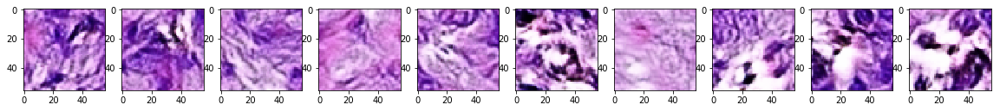

Epochs 2/5: Generator Loss: -1.9033. Discriminator Loss: -0.1276
Epochs 2/5: Generator Loss: 0.3065. Discriminator Loss: -0.0913
Epochs 2/5: Generator Loss: 3.2693. Discriminator Loss: -0.1499
Epochs 2/5: Generator Loss: -0.2296. Discriminator Loss: -0.1675
Epochs 2/5: Generator Loss: -3.2021. Discriminator Loss: -0.1871
Epochs 2/5: Generator Loss: 1.5813. Discriminator Loss: -0.2056
Epochs 2/5: Generator Loss: 4.1159. Discriminator Loss: -0.2309
Epochs 2/5: Generator Loss: -5.9638. Discriminator Loss: -0.2506
Epochs 2/5: Generator Loss: -1.491. Discriminator Loss: -0.1844
Epochs 2/5: Generator Loss: 1.0825. Discriminator Loss: -0.2325


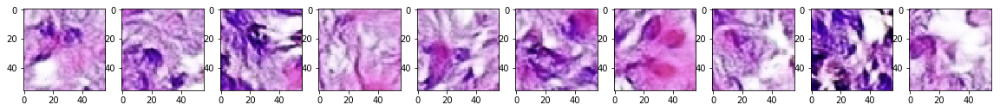

Epochs 2/5: Generator Loss: -5.1369. Discriminator Loss: -0.18
Epochs 2/5: Generator Loss: 10.3083. Discriminator Loss: -0.3176
Epochs 2/5: Generator Loss: -6.1009. Discriminator Loss: -0.2461
Epochs 2/5: Generator Loss: 4.306. Discriminator Loss: -0.1968
Epochs 2/5: Generator Loss: -4.7036. Discriminator Loss: -0.0861
Epochs 2/5: Generator Loss: 2.482. Discriminator Loss: -0.2073
Epochs 2/5: Generator Loss: -4.1198. Discriminator Loss: -0.1521
Epochs 2/5: Generator Loss: 2.4653. Discriminator Loss: -0.2299
Epochs 2/5: Generator Loss: -6.3151. Discriminator Loss: -0.2047
Epochs 2/5: Generator Loss: 9.8873. Discriminator Loss: -0.1985


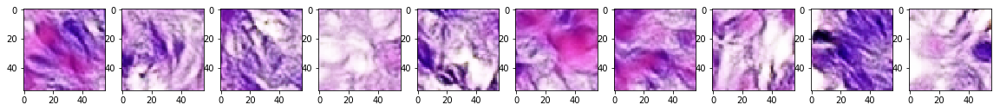

Epochs 2/5: Generator Loss: 0.148. Discriminator Loss: -0.1661
Epochs 2/5: Generator Loss: -10.9824. Discriminator Loss: -0.3546
Epochs 2/5: Generator Loss: 3.9587. Discriminator Loss: -0.173
Epochs 2/5: Generator Loss: 2.8062. Discriminator Loss: -0.045
Epochs 2/5: Generator Loss: -7.9223. Discriminator Loss: -0.148
Epochs 2/5: Generator Loss: 6.1949. Discriminator Loss: -0.1469
Epochs 2/5: Generator Loss: 4.9473. Discriminator Loss: -0.1504
Epochs 2/5: Generator Loss: -1.4803. Discriminator Loss: -0.1254
Epochs 2/5: Generator Loss: -7.5084. Discriminator Loss: -0.0854
Epochs 2/5: Generator Loss: 5.1142. Discriminator Loss: -0.1481


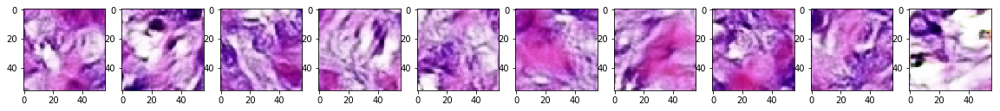

Epochs 2/5: Generator Loss: -3.5623. Discriminator Loss: -0.1082
Epochs 2/5: Generator Loss: -1.258. Discriminator Loss: -0.1359
Epochs 2/5: Generator Loss: -0.2728. Discriminator Loss: -0.2363
Epochs 2/5: Generator Loss: 0.2102. Discriminator Loss: -0.162
Epochs 2/5: Generator Loss: 2.5585. Discriminator Loss: -0.232
Epochs 2/5: Generator Loss: 8.397. Discriminator Loss: -0.232
Epochs 2/5: Generator Loss: 1.8498. Discriminator Loss: -0.1369
Epochs 2/5: Generator Loss: -12.437. Discriminator Loss: -0.1904
Epochs 2/5: Generator Loss: -2.4827. Discriminator Loss: -0.1675
Epochs 2/5: Generator Loss: 6.4543. Discriminator Loss: -0.1166


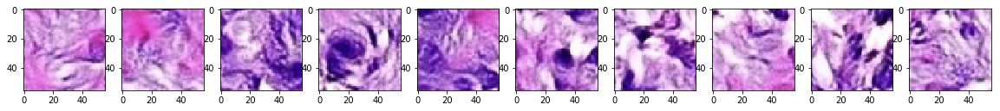

Epochs 2/5: Generator Loss: -1.86. Discriminator Loss: -0.2139
Epochs 2/5: Generator Loss: 1.3397. Discriminator Loss: -0.1659
Epochs 2/5: Generator Loss: -2.7351. Discriminator Loss: -0.1096
Epochs 2/5: Generator Loss: -0.4673. Discriminator Loss: -0.1232
Epochs 2/5: Generator Loss: 3.1856. Discriminator Loss: -0.1232
Epochs 2/5: Generator Loss: -2.2244. Discriminator Loss: -0.1988
Epochs 2/5: Generator Loss: -3.9433. Discriminator Loss: -0.1379
Epochs 2/5: Generator Loss: 5.0661. Discriminator Loss: -0.1933
Epochs 2/5: Generator Loss: 8.3002. Discriminator Loss: -0.1141
Epochs 2/5: Generator Loss: -3.9282. Discriminator Loss: -0.3433


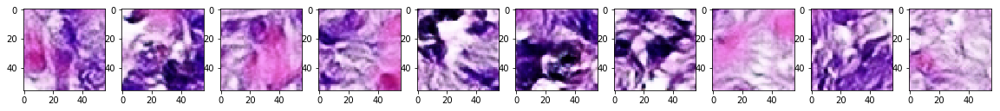

Epochs 2/5: Generator Loss: 1.2451. Discriminator Loss: -0.1176
Epochs 2/5: Generator Loss: 5.0709. Discriminator Loss: -0.2023
Epochs 2/5: Generator Loss: -2.7747. Discriminator Loss: -0.0455
Epochs 2/5: Generator Loss: -3.2368. Discriminator Loss: -0.1457
Epochs 2/5: Generator Loss: 5.2455. Discriminator Loss: -0.1695
Epochs 2/5: Generator Loss: 0.8523. Discriminator Loss: -0.0173
Epochs 2/5: Generator Loss: -3.9901. Discriminator Loss: -0.0403
Epochs 2/5: Generator Loss: 3.1373. Discriminator Loss: -0.229
Epochs 2/5: Generator Loss: -4.2343. Discriminator Loss: -0.2397
Epochs 2/5: Generator Loss: 1.2017. Discriminator Loss: -0.1107


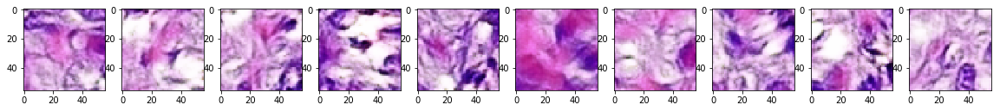

Epochs 2/5: Generator Loss: 4.5816. Discriminator Loss: -0.1565
Epochs 2/5: Generator Loss: 2.5532. Discriminator Loss: -0.4228
Epochs 2/5: Generator Loss: -5.7781. Discriminator Loss: -0.1214
Epochs 2/5: Generator Loss: 4.7336. Discriminator Loss: -0.1745
Epochs 2/5: Generator Loss: -4.7687. Discriminator Loss: -0.0521
Epochs 2/5: Generator Loss: 4.3615. Discriminator Loss: -0.0423
Epochs 2/5: Generator Loss: -2.4514. Discriminator Loss: -0.3764
Epochs 2/5: Generator Loss: -2.6762. Discriminator Loss: -0.133
Epochs 2/5: Generator Loss: -5.7945. Discriminator Loss: -0.2099
Epochs 2/5: Generator Loss: -0.5604. Discriminator Loss: -0.005


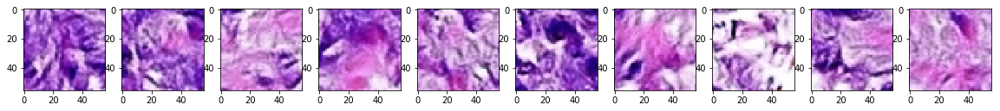

Epochs 2/5: Generator Loss: 4.5525. Discriminator Loss: -0.2506
Epochs 2/5: Generator Loss: -4.1616. Discriminator Loss: -0.1271
Epochs 2/5: Generator Loss: -0.934. Discriminator Loss: -0.1705
Epochs 2/5: Generator Loss: 3.7011. Discriminator Loss: -0.1411
Epochs 2/5: Generator Loss: -0.9577. Discriminator Loss: -0.0712
Epochs 2/5: Generator Loss: -0.9908. Discriminator Loss: -0.2537
Epochs 2/5: Generator Loss: 5.0936. Discriminator Loss: -0.048
Epochs 2/5: Generator Loss: -4.6668. Discriminator Loss: -0.2036
Epochs 2/5: Generator Loss: -11.3913. Discriminator Loss: -0.2324
Epochs 2/5: Generator Loss: 14.6446. Discriminator Loss: -0.3298


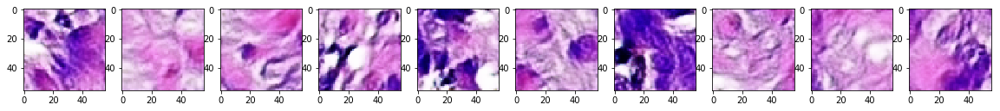

Epochs 2/5: Generator Loss: 0.0798. Discriminator Loss: -0.2057
Epochs 2/5: Generator Loss: -1.2512. Discriminator Loss: -0.1479
Epochs 2/5: Generator Loss: 0.3009. Discriminator Loss: -0.1219
Epochs 2/5: Generator Loss: 9.8458. Discriminator Loss: -0.0904
Epochs 2/5: Generator Loss: 5.0315. Discriminator Loss: -0.0319
Epochs 2/5: Generator Loss: -7.7777. Discriminator Loss: -0.1092
Epochs 2/5: Generator Loss: -1.9808. Discriminator Loss: -0.108
Epochs 2/5: Generator Loss: 5.278. Discriminator Loss: -0.1943
Epochs 2/5: Generator Loss: -2.8604. Discriminator Loss: -0.1838
Epochs 2/5: Generator Loss: 3.2075. Discriminator Loss: -0.1096


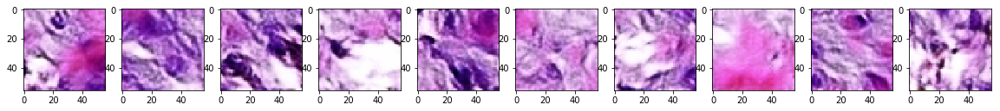

Epochs 2/5: Generator Loss: 0.3747. Discriminator Loss: -0.1249
Epochs 2/5: Generator Loss: -5.0856. Discriminator Loss: -0.0622
Epochs 2/5: Generator Loss: 7.2106. Discriminator Loss: -0.1361
Epochs 2/5: Generator Loss: 3.4142. Discriminator Loss: -0.0871
Epochs 2/5: Generator Loss: -5.6392. Discriminator Loss: -0.03
Epochs 2/5: Generator Loss: 7.2994. Discriminator Loss: -0.1429
Epochs 2/5: Generator Loss: 2.17. Discriminator Loss: -0.1643
Epochs 2/5: Generator Loss: -2.6873. Discriminator Loss: -0.0879
Epochs 2/5: Generator Loss: -0.0965. Discriminator Loss: -0.1895
Epochs 2/5: Generator Loss: -1.0781. Discriminator Loss: -0.0972


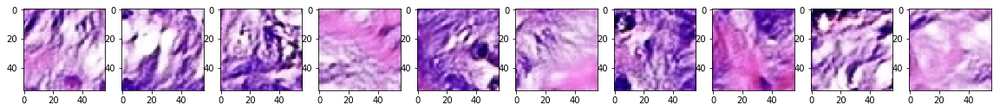

Epochs 2/5: Generator Loss: 1.4347. Discriminator Loss: -0.1526
Epochs 2/5: Generator Loss: 7.0902. Discriminator Loss: -0.3701
Epochs 2/5: Generator Loss: -15.9708. Discriminator Loss: -0.3204
Epochs 2/5: Generator Loss: -0.5606. Discriminator Loss: -0.2048
Epochs 2/5: Generator Loss: 3.14. Discriminator Loss: -0.1406
Epochs 2/5: Generator Loss: -1.402. Discriminator Loss: -0.1918
Epochs 2/5: Generator Loss: -2.437. Discriminator Loss: -0.2044
Epochs 2/5: Generator Loss: -1.4788. Discriminator Loss: -0.1483
Epochs 2/5: Generator Loss: 5.9226. Discriminator Loss: -0.0907
Epochs 2/5: Generator Loss: -7.687. Discriminator Loss: -0.1553


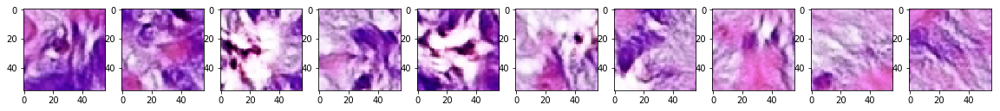

Epochs 2/5: Generator Loss: 0.3205. Discriminator Loss: -0.0171
Epochs 2/5: Generator Loss: 3.7296. Discriminator Loss: -0.2907
Epochs 2/5: Generator Loss: 20.7268. Discriminator Loss: -0.5258
Epochs 2/5: Generator Loss: -16.3166. Discriminator Loss: -0.369
Epochs 2/5: Generator Loss: 1.8403. Discriminator Loss: -0.0724
Epochs 2/5: Generator Loss: 10.6199. Discriminator Loss: -0.1473
Epochs 2/5: Generator Loss: -10.65. Discriminator Loss: -0.2173
Epochs 2/5: Generator Loss: 6.3418. Discriminator Loss: -0.327
Epochs 2/5: Generator Loss: 4.7007. Discriminator Loss: -0.1468
Epochs 2/5: Generator Loss: 0.5488. Discriminator Loss: -0.1266


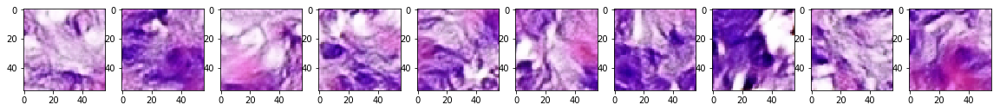

Epochs 2/5: Generator Loss: -5.6442. Discriminator Loss: -0.1223
Epochs 2/5: Generator Loss: 1.9334. Discriminator Loss: -0.1094
Epochs 2/5: Generator Loss: 2.4937. Discriminator Loss: -0.153
Epochs 2/5: Generator Loss: -0.7884. Discriminator Loss: -0.1095
Epochs 2/5: Generator Loss: -11.4425. Discriminator Loss: -0.1426
Epochs 2/5: Generator Loss: 4.0024. Discriminator Loss: -0.1461
Epochs 2/5: Generator Loss: 2.3874. Discriminator Loss: -0.1251
Epochs 2/5: Generator Loss: -2.6498. Discriminator Loss: -0.1619
Epochs 2/5: Generator Loss: -4.7613. Discriminator Loss: -0.242
Epochs 2/5: Generator Loss: 3.8721. Discriminator Loss: -0.1188


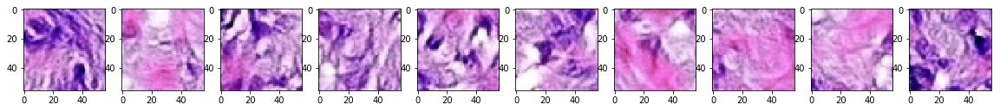

Epochs 2/5: Generator Loss: 1.0898. Discriminator Loss: -0.1956
Epochs 2/5: Generator Loss: 3.197. Discriminator Loss: -0.0908
Epochs 2/5: Generator Loss: -2.8599. Discriminator Loss: -0.2047
Epochs 2/5: Generator Loss: 9.9189. Discriminator Loss: -0.0957
Epochs 2/5: Generator Loss: -3.1497. Discriminator Loss: -0.1943
Epochs 2/5: Generator Loss: -3.1676. Discriminator Loss: -0.1754
Epochs 2/5: Generator Loss: 5.0396. Discriminator Loss: -0.1542
Epochs 2/5: Generator Loss: -0.7936. Discriminator Loss: -0.0781
Epochs 2/5: Generator Loss: -4.7024. Discriminator Loss: -0.0891
Epochs 2/5: Generator Loss: -0.9197. Discriminator Loss: -0.1518


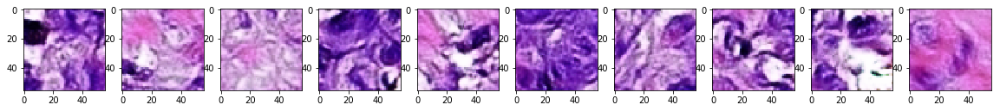

Epochs 2/5: Generator Loss: 4.2681. Discriminator Loss: -0.0905
Epochs 2/5: Generator Loss: 0.0589. Discriminator Loss: -0.1263
Epochs 2/5: Generator Loss: -5.8585. Discriminator Loss: -0.1738
Epochs 2/5: Generator Loss: 3.3179. Discriminator Loss: -0.181
Epochs 2/5: Generator Loss: -9.3678. Discriminator Loss: -0.2525
Epochs 2/5: Generator Loss: 4.5033. Discriminator Loss: -0.0986
Epochs 2/5: Generator Loss: 0.5661. Discriminator Loss: -0.1327
Epochs 2/5: Generator Loss: -5.7139. Discriminator Loss: -0.2181
Epochs 2/5: Generator Loss: 3.226. Discriminator Loss: -0.1268
Epochs 2/5: Generator Loss: 3.3398. Discriminator Loss: -0.1208


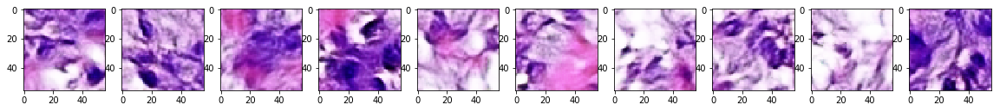

Epochs 2/5: Generator Loss: 4.2495. Discriminator Loss: -0.278
Epochs 2/5: Generator Loss: -3.7384. Discriminator Loss: -0.2484
Epochs 2/5: Generator Loss: -9.085. Discriminator Loss: -0.1301
Epochs 2/5: Generator Loss: 17.7103. Discriminator Loss: -0.2904
Epochs 2/5: Generator Loss: -15.0513. Discriminator Loss: -0.0357
Epochs 2/5: Generator Loss: 0.4016. Discriminator Loss: -0.0791
Epochs 2/5: Generator Loss: -0.1922. Discriminator Loss: -0.1619
Epochs 2/5: Generator Loss: 2.3623. Discriminator Loss: -0.1295
Epochs 2/5: Generator Loss: -6.4538. Discriminator Loss: -0.0697
Epochs 2/5: Generator Loss: 5.5366. Discriminator Loss: -0.2333


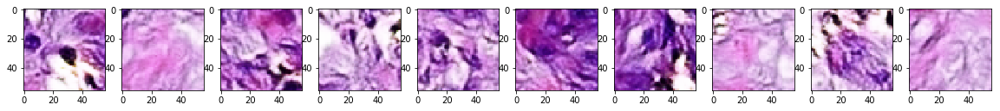

Epochs 2/5: Generator Loss: 3.0007. Discriminator Loss: -0.041
Epochs 2/5: Generator Loss: -5.1223. Discriminator Loss: -0.0915
Epochs 2/5: Generator Loss: 0.3464. Discriminator Loss: -0.0487
Epochs 2/5: Generator Loss: 6.3548. Discriminator Loss: -0.2765
Epochs 2/5: Generator Loss: 1.1846. Discriminator Loss: -0.1396
Epochs 2/5: Generator Loss: -2.6549. Discriminator Loss: -0.1971
Epochs 2/5: Generator Loss: 0.6798. Discriminator Loss: -0.1409
Epochs 2/5: Generator Loss: 2.9894. Discriminator Loss: -0.0419
Epochs 2/5: Generator Loss: -1.8221. Discriminator Loss: -0.1704
Epochs 2/5: Generator Loss: -11.2821. Discriminator Loss: -0.1642


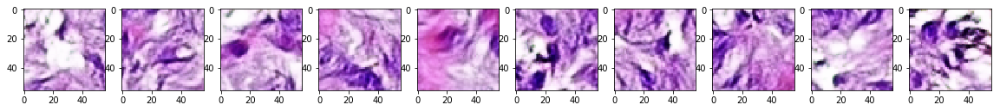

Epochs 2/5: Generator Loss: -1.4919. Discriminator Loss: -0.1549
Epochs 2/5: Generator Loss: 7.9927. Discriminator Loss: 0.0483
Epochs 2/5: Generator Loss: -11.0883. Discriminator Loss: -0.1052
Epochs 2/5: Generator Loss: -5.2495. Discriminator Loss: -0.0509
Epochs 2/5: Generator Loss: -0.516. Discriminator Loss: -0.066
Epochs 2/5: Generator Loss: 4.7005. Discriminator Loss: -0.3156
Epochs 2/5: Generator Loss: 7.0836. Discriminator Loss: -0.0165
Epochs 2/5: Generator Loss: -18.7033. Discriminator Loss: -0.2629
Epochs 2/5: Generator Loss: 1.6313. Discriminator Loss: -0.0768
Epochs 2/5: Generator Loss: 7.2404. Discriminator Loss: -0.0984


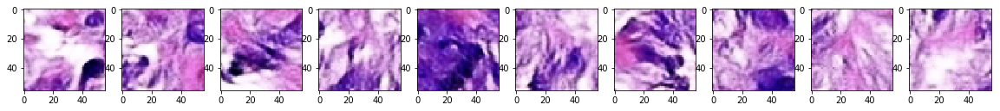

Epochs 2/5: Generator Loss: -8.655. Discriminator Loss: -0.0204
Epochs 2/5: Generator Loss: -1.3251. Discriminator Loss: -0.1891
Epochs 2/5: Generator Loss: 4.6912. Discriminator Loss: -0.2241
Epochs 2/5: Generator Loss: 3.115. Discriminator Loss: -0.1657
Epochs 2/5: Generator Loss: -21.6626. Discriminator Loss: -0.2076
Epochs 2/5: Generator Loss: -4.841. Discriminator Loss: -0.1172
Epochs 2/5: Generator Loss: 3.4157. Discriminator Loss: -0.1899
Epochs 2/5: Generator Loss: 6.8024. Discriminator Loss: -0.1653
Epochs 2/5: Generator Loss: -9.6982. Discriminator Loss: -0.1656
Epochs 2/5: Generator Loss: 1.9573. Discriminator Loss: -0.1274


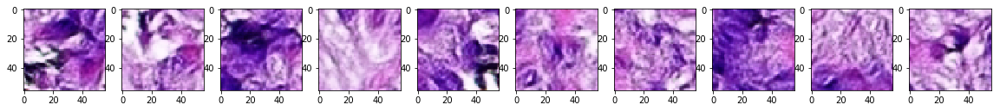

Epochs 2/5: Generator Loss: -2.4451. Discriminator Loss: -0.1755
Epochs 2/5: Generator Loss: -2.9849. Discriminator Loss: -0.1568
Epochs 2/5: Generator Loss: 3.7156. Discriminator Loss: -0.1433
Epochs 2/5: Generator Loss: -3.7473. Discriminator Loss: -0.2172
Epochs 2/5: Generator Loss: 1.2726. Discriminator Loss: -0.1385
Epochs 2/5: Generator Loss: -1.1435. Discriminator Loss: -0.1634
Epochs 2/5: Generator Loss: -3.7675. Discriminator Loss: -0.2156
Epochs 2/5: Generator Loss: 11.3655. Discriminator Loss: -0.1061
Epochs 2/5: Generator Loss: -1.2237. Discriminator Loss: -0.2554
Epochs 2/5: Generator Loss: 3.1169. Discriminator Loss: -0.3898


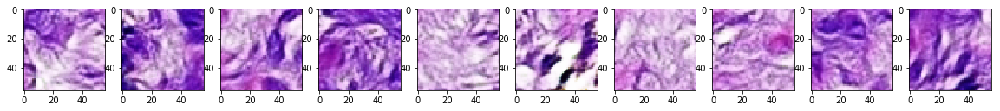

Epochs 2/5: Generator Loss: -7.6235. Discriminator Loss: -0.2262
Epochs 2/5: Generator Loss: 5.6941. Discriminator Loss: -0.102
Epochs 2/5: Generator Loss: -2.8601. Discriminator Loss: -0.4093
Epochs 2/5: Generator Loss: 17.4875. Discriminator Loss: -0.1946
Epochs 2/5: Generator Loss: -8.6433. Discriminator Loss: -0.1461
Epochs 2/5: Generator Loss: 3.2267. Discriminator Loss: -0.1555
Epochs 2/5: Generator Loss: 4.9573. Discriminator Loss: -0.2712
Epochs 2/5: Generator Loss: 3.1099. Discriminator Loss: -0.0911
Epochs 2/5: Generator Loss: -2.3365. Discriminator Loss: -0.0887
Epochs 2/5: Generator Loss: 6.1879. Discriminator Loss: -0.1772


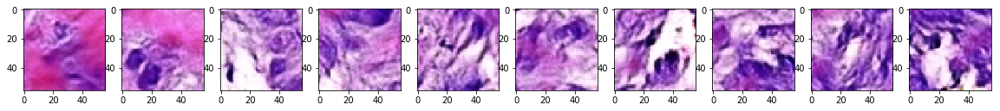

Epochs 2/5: Generator Loss: 1.6963. Discriminator Loss: -0.0991
Epochs 2/5: Generator Loss: -11.6122. Discriminator Loss: -0.1721
Epochs 2/5: Generator Loss: -0.639. Discriminator Loss: -0.1558
Epochs 2/5: Generator Loss: 8.4619. Discriminator Loss: -0.1388
Epochs 2/5: Generator Loss: 2.4183. Discriminator Loss: -0.1499
Epochs 2/5: Generator Loss: -3.2697. Discriminator Loss: -0.1744
Epochs 2/5: Generator Loss: -1.7893. Discriminator Loss: -0.0996
Epochs 2/5: Generator Loss: -1.3675. Discriminator Loss: -0.0645
Epochs 2/5: Generator Loss: 1.1418. Discriminator Loss: -0.1153
Epochs 2/5: Generator Loss: -2.1772. Discriminator Loss: -0.1752


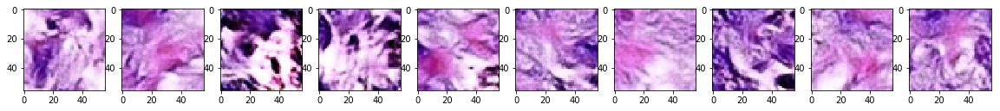

Epochs 2/5: Generator Loss: 9.8359. Discriminator Loss: -0.3335
Epochs 2/5: Generator Loss: -2.9051. Discriminator Loss: -0.2224
Epochs 2/5: Generator Loss: 3.0358. Discriminator Loss: -0.2319
Epochs 2/5: Generator Loss: -7.5002. Discriminator Loss: -0.0386
Epochs 2/5: Generator Loss: 2.906. Discriminator Loss: -0.1404
Epochs 2/5: Generator Loss: 7.0621. Discriminator Loss: -0.1321
Epochs 2/5: Generator Loss: -4.7593. Discriminator Loss: 0.0351
Epochs 2/5: Generator Loss: 1.2654. Discriminator Loss: -0.039
Epochs 2/5: Generator Loss: -0.7002. Discriminator Loss: -0.1504
Epochs 2/5: Generator Loss: -3.2368. Discriminator Loss: -0.0736


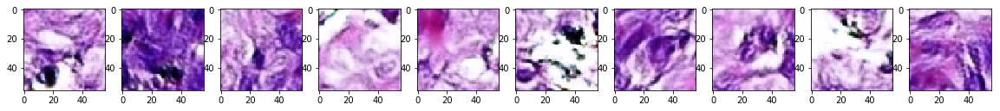

Epochs 2/5: Generator Loss: 3.9023. Discriminator Loss: -0.1554
Epochs 2/5: Generator Loss: 3.2628. Discriminator Loss: -0.0644
Epochs 2/5: Generator Loss: -7.0119. Discriminator Loss: -0.1979
Epochs 2/5: Generator Loss: -3.5719. Discriminator Loss: -0.1549
Epochs 2/5: Generator Loss: 4.4119. Discriminator Loss: -0.0918
Epochs 2/5: Generator Loss: 4.8262. Discriminator Loss: -0.1687
Epochs 2/5: Generator Loss: -15.097. Discriminator Loss: -0.322
Epochs 2/5: Generator Loss: 3.6147. Discriminator Loss: -0.1263
Epochs 2/5: Generator Loss: 4.6025. Discriminator Loss: -0.0906
Epochs 2/5: Generator Loss: -1.8409. Discriminator Loss: -0.1594


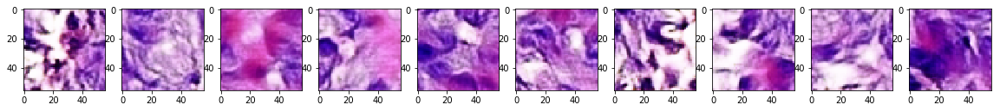

Epochs 2/5: Generator Loss: -3.1109. Discriminator Loss: -0.1558
Epochs 2/5: Generator Loss: 4.7521. Discriminator Loss: -0.0826
Epochs 2/5: Generator Loss: -7.701. Discriminator Loss: -0.1636
Epochs 2/5: Generator Loss: -5.895. Discriminator Loss: -0.1123
Epochs 2/5: Generator Loss: -3.0875. Discriminator Loss: -0.2417
Epochs 2/5: Generator Loss: 5.7172. Discriminator Loss: -0.1431
Epochs 2/5: Generator Loss: 1.8978. Discriminator Loss: -0.0713
Epochs 2/5: Generator Loss: -1.7033. Discriminator Loss: -0.1507
Epochs 2/5: Generator Loss: 5.3341. Discriminator Loss: -0.228
Epochs 2/5: Generator Loss: -4.282. Discriminator Loss: -0.233


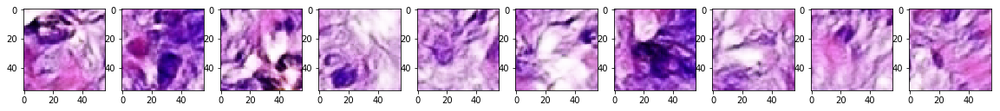

Epochs 2/5: Generator Loss: 0.2554. Discriminator Loss: -0.1316
Epochs 2/5: Generator Loss: 0.2312. Discriminator Loss: -0.0827
Epochs 2/5: Generator Loss: 2.973. Discriminator Loss: -0.2233
Epochs 2/5: Generator Loss: 3.4673. Discriminator Loss: -0.1148
Epochs 2/5: Generator Loss: -7.3371. Discriminator Loss: -0.3097
Epochs 2/5: Generator Loss: -10.931. Discriminator Loss: -0.1171
Epochs 2/5: Generator Loss: 18.6062. Discriminator Loss: -0.419
Epochs 2/5: Generator Loss: -5.1687. Discriminator Loss: -0.0923
Epochs 2/5: Generator Loss: -3.8705. Discriminator Loss: -0.0843
Epochs 2/5: Generator Loss: -2.2873. Discriminator Loss: -0.0823


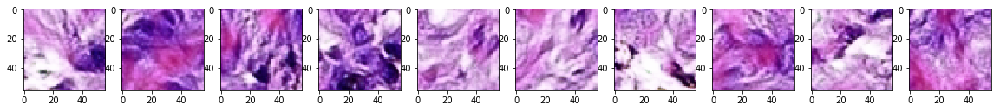

Epochs 2/5: Generator Loss: -0.3107. Discriminator Loss: -0.0268
Epochs 2/5: Generator Loss: 4.5448. Discriminator Loss: -0.2904
Epochs 2/5: Generator Loss: -4.0728. Discriminator Loss: -0.1479
Epochs 2/5: Generator Loss: -3.9175. Discriminator Loss: -0.0628
Epochs 2/5: Generator Loss: 3.6887. Discriminator Loss: -0.0605
Epochs 2/5: Generator Loss: 7.5576. Discriminator Loss: -0.02
Epochs 2/5: Generator Loss: -2.7524. Discriminator Loss: -0.1443
Epochs 2/5: Generator Loss: -2.2985. Discriminator Loss: -0.2216
Epochs 2/5: Generator Loss: -0.4888. Discriminator Loss: -0.1923
Epochs 2/5: Generator Loss: 4.0216. Discriminator Loss: -0.0537


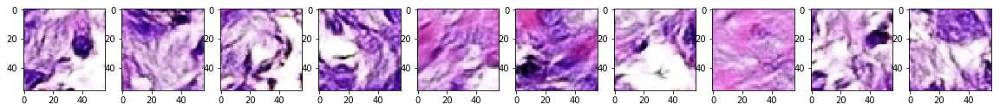

Epochs 2/5: Generator Loss: -3.5931. Discriminator Loss: -0.1819
Epochs 2/5: Generator Loss: 2.9143. Discriminator Loss: -0.0602
Epochs 2/5: Generator Loss: 2.2565. Discriminator Loss: -0.1867
Epochs 2/5: Generator Loss: 4.6986. Discriminator Loss: -0.1418
Epochs 2/5: Generator Loss: 6.7195. Discriminator Loss: -0.1904
Epochs 2/5: Generator Loss: -6.1516. Discriminator Loss: -0.2616
Epochs 2/5: Generator Loss: 3.3995. Discriminator Loss: -0.0365
Epochs 2/5: Generator Loss: 1.4721. Discriminator Loss: -0.0254
Epochs 2/5: Generator Loss: -6.9668. Discriminator Loss: -0.072
Epochs 2/5: Generator Loss: 12.1688. Discriminator Loss: -0.1303


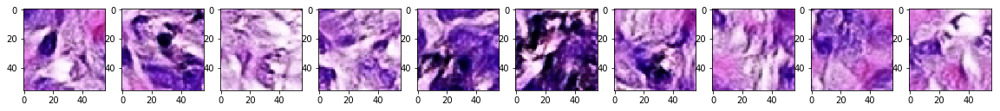

Epochs 2/5: Generator Loss: -4.9855. Discriminator Loss: -0.0941
Epochs 2/5: Generator Loss: 0.9503. Discriminator Loss: -0.1344
Epochs 2/5: Generator Loss: 1.9124. Discriminator Loss: -0.0965
Epochs 2/5: Generator Loss: -0.5425. Discriminator Loss: -0.1305
Epochs 2/5: Generator Loss: 3.5036. Discriminator Loss: -0.1439
Epochs 2/5: Generator Loss: -2.7909. Discriminator Loss: -0.1504
Epochs 2/5: Generator Loss: -1.6295. Discriminator Loss: -0.2437
Epochs 2/5: Generator Loss: 5.623. Discriminator Loss: -0.1652
Epochs 2/5: Generator Loss: 3.5224. Discriminator Loss: -0.1117
Epochs 2/5: Generator Loss: -2.9913. Discriminator Loss: -0.1442


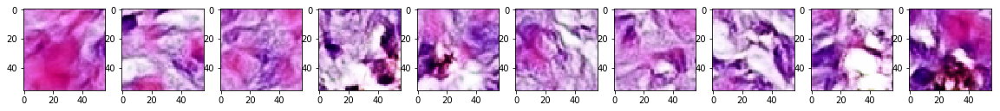

Epochs 2/5: Generator Loss: 1.9933. Discriminator Loss: -0.0964
Epochs 2/5: Generator Loss: 1.8238. Discriminator Loss: -0.1687
Epochs 2/5: Generator Loss: 2.26. Discriminator Loss: -0.1304
Epochs 2/5: Generator Loss: 4.79. Discriminator Loss: -0.1487
Epochs 2/5: Generator Loss: -0.5421. Discriminator Loss: -0.164
Epochs 2/5: Generator Loss: -0.8762. Discriminator Loss: -0.1191
Epochs 2/5: Generator Loss: -3.1374. Discriminator Loss: -0.1889
Epochs 2/5: Generator Loss: 2.5693. Discriminator Loss: -0.1187
Epochs 2/5: Generator Loss: 0.4168. Discriminator Loss: -0.1537
Epochs 2/5: Generator Loss: -0.445. Discriminator Loss: -0.1773


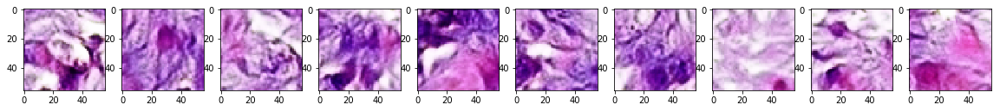

Epochs 2/5: Generator Loss: 1.4551. Discriminator Loss: -0.1888
Epochs 2/5: Generator Loss: 3.9849. Discriminator Loss: -0.2356
Epochs 2/5: Generator Loss: -18.4395. Discriminator Loss: -0.2474
Epochs 2/5: Generator Loss: 5.8938. Discriminator Loss: -0.1442
Epochs 2/5: Generator Loss: -1.7708. Discriminator Loss: -0.2242
Epochs 2/5: Generator Loss: -0.537. Discriminator Loss: -0.0723
Epochs 2/5: Generator Loss: 0.4541. Discriminator Loss: -0.2318
Epochs 2/5: Generator Loss: 0.4897. Discriminator Loss: -0.0998
Epochs 2/5: Generator Loss: 1.4397. Discriminator Loss: -0.182
Epochs 2/5: Generator Loss: -10.1455. Discriminator Loss: -0.1524


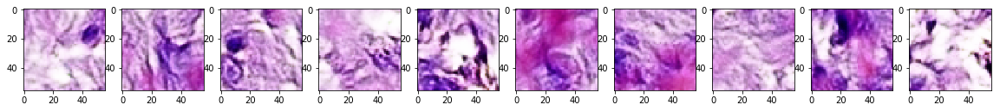

Epochs 2/5: Generator Loss: 0.0646. Discriminator Loss: -0.0516
Epochs 2/5: Generator Loss: 1.3825. Discriminator Loss: -0.1218
Epochs 2/5: Generator Loss: -5.2629. Discriminator Loss: -0.1739
Epochs 2/5: Generator Loss: 3.4035. Discriminator Loss: -0.1645
Epochs 2/5: Generator Loss: -8.3717. Discriminator Loss: -0.1006
Epochs 2/5: Generator Loss: 5.6683. Discriminator Loss: -0.2496
Epochs 2/5: Generator Loss: -0.0402. Discriminator Loss: -0.2309
Epochs 2/5: Generator Loss: -2.0423. Discriminator Loss: -0.1096
Epochs 2/5: Generator Loss: 7.7197. Discriminator Loss: -0.141
Epochs 2/5: Generator Loss: -0.5307. Discriminator Loss: -0.1822


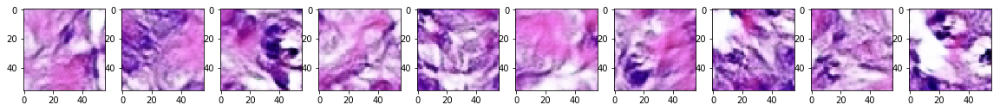

Epochs 2/5: Generator Loss: -5.38. Discriminator Loss: -0.1292
Epochs 2/5: Generator Loss: 1.7391. Discriminator Loss: -0.0224
Epochs 2/5: Generator Loss: -2.661. Discriminator Loss: -0.2357
Epochs 2/5: Generator Loss: 5.9547. Discriminator Loss: -0.1694
Epochs 2/5: Generator Loss: -2.8533. Discriminator Loss: -0.1161
Epochs 2/5: Generator Loss: -1.0036. Discriminator Loss: -0.2054
Epochs 2/5: Generator Loss: -1.3797. Discriminator Loss: -0.0909
Epochs 2/5: Generator Loss: -0.838. Discriminator Loss: -0.3214
Epochs 2/5: Generator Loss: 1.5193. Discriminator Loss: -0.1215
Epochs 2/5: Generator Loss: 2.4137. Discriminator Loss: -0.1891


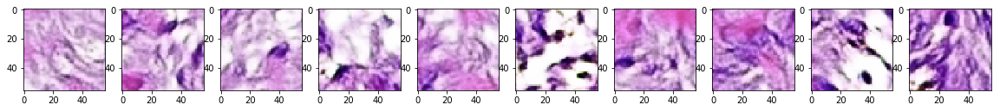

Epochs 2/5: Generator Loss: -1.4229. Discriminator Loss: -0.1202
Epochs 2/5: Generator Loss: -1.9802. Discriminator Loss: -0.0894
Epochs 2/5: Generator Loss: -0.7595. Discriminator Loss: -0.1084
Epochs 2/5: Generator Loss: 2.2566. Discriminator Loss: -0.0703
Epochs 2/5: Generator Loss: -0.425. Discriminator Loss: -0.2567
Epochs 2/5: Generator Loss: 0.2947. Discriminator Loss: -0.2507
Epochs 2/5: Generator Loss: 10.9252. Discriminator Loss: -0.2689
Epochs 2/5: Generator Loss: -0.9818. Discriminator Loss: -0.186
Epochs 2/5: Generator Loss: -4.1981. Discriminator Loss: -0.1673
Epochs 2/5: Generator Loss: 1.841. Discriminator Loss: -0.2499


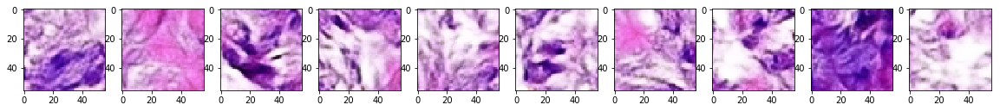

Epochs 2/5: Generator Loss: 5.311. Discriminator Loss: -0.182
Epochs 2/5: Generator Loss: -4.5955. Discriminator Loss: -0.2049
Epochs 2/5: Generator Loss: -4.5725. Discriminator Loss: -0.0438
Epochs 2/5: Generator Loss: 8.4196. Discriminator Loss: -0.1247
Epochs 2/5: Generator Loss: 0.6792. Discriminator Loss: -0.3327
Epochs 2/5: Generator Loss: 1.3262. Discriminator Loss: -0.1346
Epochs 2/5: Generator Loss: 11.8333. Discriminator Loss: -0.1867
Epochs 2/5: Generator Loss: -10.9923. Discriminator Loss: -0.267
Epochs 2/5: Generator Loss: -0.1541. Discriminator Loss: -0.0638
Epochs 2/5: Generator Loss: 5.4394. Discriminator Loss: -0.1363


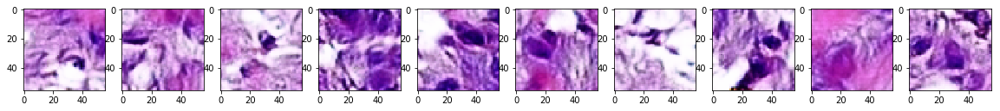

Epochs 2/5: Generator Loss: -2.3611. Discriminator Loss: -0.1998
Epochs 2/5: Generator Loss: -4.4818. Discriminator Loss: -0.1389
Epochs 2/5: Generator Loss: 3.1531. Discriminator Loss: 0.1053
Epochs 2/5: Generator Loss: -5.7836. Discriminator Loss: -0.1008
Epochs 2/5: Generator Loss: 9.6883. Discriminator Loss: -0.2266
Epochs 2/5: Generator Loss: -4.8759. Discriminator Loss: -0.2033
Epochs 2/5: Generator Loss: -2.1062. Discriminator Loss: -0.273
Epochs 2/5: Generator Loss: -13.5068. Discriminator Loss: -0.2693
Epochs 2/5: Generator Loss: 16.1349. Discriminator Loss: -0.1239
Epochs 2/5: Generator Loss: -1.1963. Discriminator Loss: -0.0875


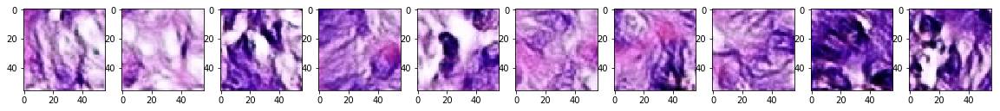

Epochs 2/5: Generator Loss: -1.717. Discriminator Loss: -0.133
Epochs 2/5: Generator Loss: -0.2231. Discriminator Loss: -0.1155
Epochs 2/5: Generator Loss: -0.7876. Discriminator Loss: -0.1697
Epochs 2/5: Generator Loss: -1.3165. Discriminator Loss: -0.1545
Epochs 2/5: Generator Loss: 2.0231. Discriminator Loss: -0.0124
Epochs 2/5: Generator Loss: -10.1491. Discriminator Loss: -0.2612
Epochs 2/5: Generator Loss: 0.1984. Discriminator Loss: -0.0595
Epochs 2/5: Generator Loss: 3.2377. Discriminator Loss: -0.1665
Epochs 2/5: Generator Loss: -6.8672. Discriminator Loss: -0.1593
Epochs 2/5: Generator Loss: -1.9895. Discriminator Loss: -0.1427


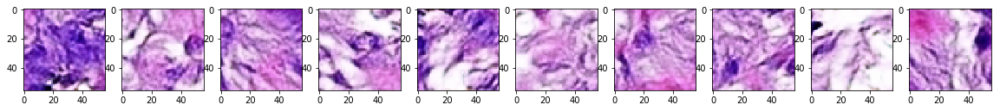

Epochs 2/5: Generator Loss: 2.5493. Discriminator Loss: 0.0681
Epochs 2/5: Generator Loss: -3.8701. Discriminator Loss: -0.1582
Epochs 2/5: Generator Loss: -4.6251. Discriminator Loss: -0.2052
Epochs 2/5: Generator Loss: 5.2372. Discriminator Loss: -0.035
Epochs 2/5: Generator Loss: 1.6156. Discriminator Loss: -0.1474
Epochs 2/5: Generator Loss: -2.3846. Discriminator Loss: -0.204
Epochs 2/5: Generator Loss: -4.6202. Discriminator Loss: -0.1808
Epochs 2/5: Generator Loss: -3.1274. Discriminator Loss: -0.183
Epochs 2/5: Generator Loss: 7.7893. Discriminator Loss: -0.1968
Epochs 2/5: Generator Loss: 3.8076. Discriminator Loss: -0.0642


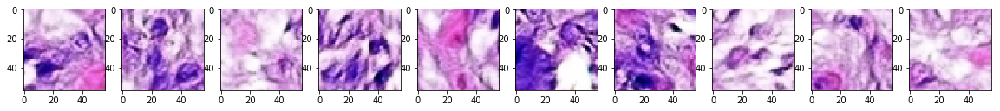

Epochs 2/5: Generator Loss: -18.7773. Discriminator Loss: -0.3262
Epochs 2/5: Generator Loss: 7.6574. Discriminator Loss: -0.1779
Epochs 2/5: Generator Loss: 5.6553. Discriminator Loss: -0.1326
Epochs 2/5: Generator Loss: 1.5433. Discriminator Loss: -0.1319
Epochs 2/5: Generator Loss: 3.6448. Discriminator Loss: -0.0438
Epochs 2/5: Generator Loss: 0.1643. Discriminator Loss: -0.0936
Epochs 2/5: Generator Loss: -2.8716. Discriminator Loss: -0.1013
Epochs 2/5: Generator Loss: -0.8484. Discriminator Loss: -0.1559
Epochs 2/5: Generator Loss: 4.7633. Discriminator Loss: -0.2371
Epochs 2/5: Generator Loss: -0.6281. Discriminator Loss: -0.0997


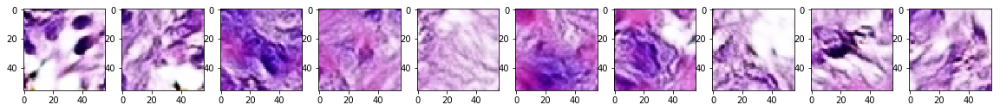

Epochs 2/5: Generator Loss: 0.4354. Discriminator Loss: -0.1824
Epochs 2/5: Generator Loss: -3.986. Discriminator Loss: -0.1649
Epochs 2/5: Generator Loss: 7.7029. Discriminator Loss: -0.0547
Epochs 2/5: Generator Loss: -5.4547. Discriminator Loss: -0.1043
Epochs 2/5: Generator Loss: 5.2247. Discriminator Loss: -0.0632
Epochs 2/5: Generator Loss: -6.1054. Discriminator Loss: -0.1052
Epochs 2/5: Generator Loss: 10.2165. Discriminator Loss: -0.1839
Epochs 2/5: Generator Loss: 2.0749. Discriminator Loss: -0.2794
Epochs 2/5: Generator Loss: -9.0664. Discriminator Loss: -0.1045
Epochs 2/5: Generator Loss: 3.8506. Discriminator Loss: -0.1915


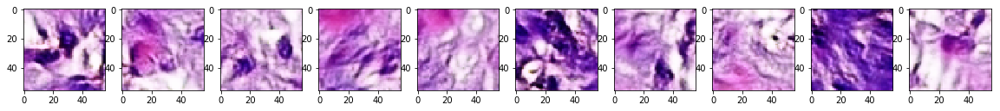

Epochs 2/5: Generator Loss: -4.736. Discriminator Loss: -0.1624
Epochs 2/5: Generator Loss: 2.3375. Discriminator Loss: -0.1775
Epochs 2/5: Generator Loss: 1.4284. Discriminator Loss: -0.1484
Epochs 2/5: Generator Loss: -4.1043. Discriminator Loss: -0.0968
Epochs 2/5: Generator Loss: -4.7366. Discriminator Loss: -0.1886
Epochs 2/5: Generator Loss: 6.7635. Discriminator Loss: -0.1932
Epochs 2/5: Generator Loss: 0.0767. Discriminator Loss: -0.1516
Epochs 2/5: Generator Loss: 2.6935. Discriminator Loss: -0.1964
Epochs 2/5: Generator Loss: -0.5609. Discriminator Loss: -0.0018
Epochs 2/5: Generator Loss: -1.1121. Discriminator Loss: -0.0744


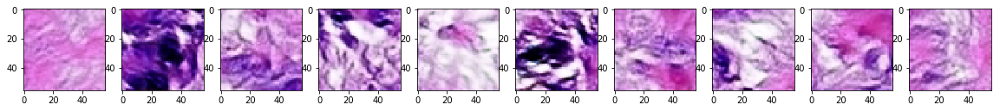

Epochs 2/5: Generator Loss: -0.9694. Discriminator Loss: -0.0312
Epochs 2/5: Generator Loss: 1.8567. Discriminator Loss: -0.1659
Epochs 2/5: Generator Loss: 2.3036. Discriminator Loss: -0.1095
Epochs 2/5: Generator Loss: -4.8725. Discriminator Loss: -0.1495
Epochs 2/5: Generator Loss: -1.4691. Discriminator Loss: -0.1845
Epochs 2/5: Generator Loss: 1.3644. Discriminator Loss: -0.1483
Epochs 2/5: Generator Loss: 2.2806. Discriminator Loss: -0.0477
Epochs 2/5: Generator Loss: -0.0167. Discriminator Loss: -0.1779
Epochs 2/5: Generator Loss: -6.4913. Discriminator Loss: -0.1884
Epochs 2/5: Generator Loss: 7.7497. Discriminator Loss: -0.1182


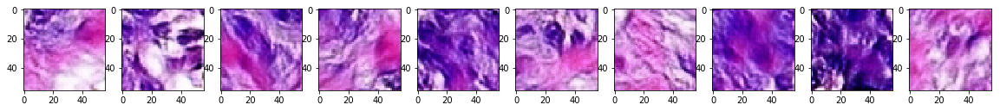

Epochs 2/5: Generator Loss: 2.0467. Discriminator Loss: -0.149
Epochs 2/5: Generator Loss: 2.3275. Discriminator Loss: -0.1025
Epochs 2/5: Generator Loss: -12.175. Discriminator Loss: -0.3184
Epochs 2/5: Generator Loss: 10.9639. Discriminator Loss: -0.1568
Epochs 2/5: Generator Loss: -4.5466. Discriminator Loss: -0.1703
Epochs 2/5: Generator Loss: -5.3688. Discriminator Loss: -0.0536
Epochs 2/5: Generator Loss: 3.0947. Discriminator Loss: -0.1991
Epochs 2/5: Generator Loss: 7.2585. Discriminator Loss: -0.0705
Epochs 2/5: Generator Loss: -4.6721. Discriminator Loss: -0.1745
Epochs 2/5: Generator Loss: 2.1755. Discriminator Loss: -0.164


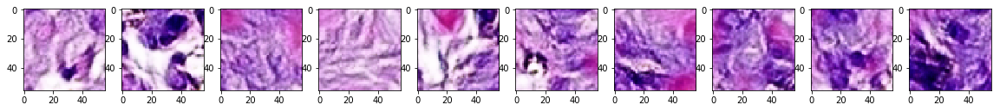

Epochs 2/5: Generator Loss: 8.0024. Discriminator Loss: -0.2172
Epochs 2/5: Generator Loss: -11.6281. Discriminator Loss: -0.2664
Epochs 2/5: Generator Loss: 0.1873. Discriminator Loss: -0.2064
Epochs 2/5: Generator Loss: -4.0408. Discriminator Loss: -0.1594
Epochs 2/5: Generator Loss: -0.0465. Discriminator Loss: -0.1616
Epochs 2/5: Generator Loss: 9.749. Discriminator Loss: -0.1468
Epochs 2/5: Generator Loss: 5.1452. Discriminator Loss: -0.2063
Epochs 2/5: Generator Loss: -9.795. Discriminator Loss: -0.1348
Epochs 2/5: Generator Loss: 3.9395. Discriminator Loss: -0.1068
Epochs 2/5: Generator Loss: 1.0353. Discriminator Loss: -0.25


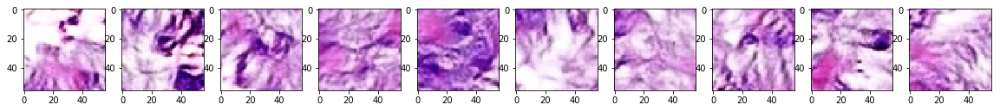

Epochs 2/5: Generator Loss: -6.0178. Discriminator Loss: -0.066
Epochs 2/5: Generator Loss: 1.4645. Discriminator Loss: -0.1142
Epochs 2/5: Generator Loss: -3.4494. Discriminator Loss: -0.1815
Epochs 2/5: Generator Loss: 1.3847. Discriminator Loss: -0.1908
Epochs 2/5: Generator Loss: 4.0222. Discriminator Loss: -0.0951
Epochs 2/5: Generator Loss: -8.4783. Discriminator Loss: -0.1969
Epochs 2/5: Generator Loss: 1.4301. Discriminator Loss: -0.1915
Epochs 2/5: Generator Loss: -8.6093. Discriminator Loss: -0.2353
Epochs 2/5: Generator Loss: -2.1124. Discriminator Loss: -0.0899
Epochs 2/5: Generator Loss: 3.5616. Discriminator Loss: -0.0123


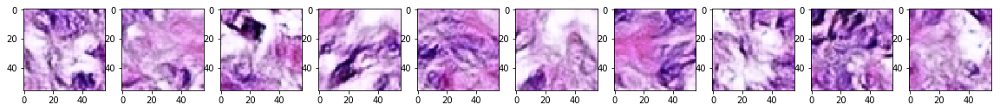

Epochs 2/5: Generator Loss: -7.1604. Discriminator Loss: -0.1068
Epochs 2/5: Generator Loss: 3.8857. Discriminator Loss: -0.1722
Epochs 2/5: Generator Loss: -7.8986. Discriminator Loss: -0.1253
Epochs 2/5: Generator Loss: 7.3497. Discriminator Loss: -0.1809
Epochs 2/5: Generator Loss: 3.9245. Discriminator Loss: -0.1411
Epochs 2/5: Generator Loss: -1.22. Discriminator Loss: -0.0947
Epochs 2/5: Generator Loss: -0.5707. Discriminator Loss: -0.1906
Epochs 2/5: Generator Loss: -2.9501. Discriminator Loss: -0.1963
Epochs 2/5: Generator Loss: 8.8446. Discriminator Loss: -0.1186
Epochs 2/5: Generator Loss: -4.8968. Discriminator Loss: -0.2167


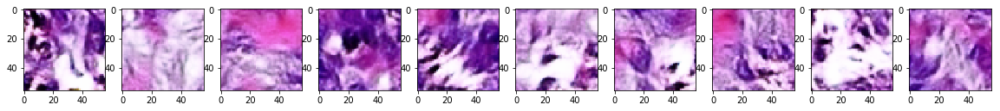

Epochs 2/5: Generator Loss: -7.2008. Discriminator Loss: -0.1271
Epochs 2/5: Generator Loss: 1.6981. Discriminator Loss: -0.1022
Epochs 2/5: Generator Loss: 3.6486. Discriminator Loss: -0.1289
Epochs 2/5: Generator Loss: 3.7254. Discriminator Loss: -0.1304
Epochs 2/5: Generator Loss: -6.5274. Discriminator Loss: -0.1441
Epochs 2/5: Generator Loss: 6.2397. Discriminator Loss: -0.1271
Epochs 2/5: Generator Loss: 2.4125. Discriminator Loss: -0.3191
Epochs 2/5: Generator Loss: 4.4828. Discriminator Loss: -0.1865
Epochs 2/5: Generator Loss: -10.4215. Discriminator Loss: -0.107
Epochs 2/5: Generator Loss: 3.2491. Discriminator Loss: -0.0947


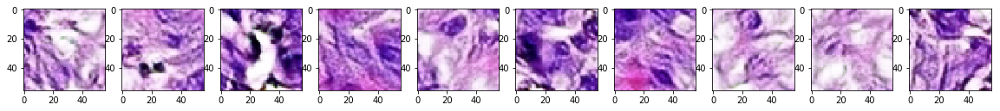

Epochs 2/5: Generator Loss: 2.2002. Discriminator Loss: -0.1225
Epochs 2/5: Generator Loss: -1.2459. Discriminator Loss: -0.0921
Epochs 2/5: Generator Loss: 3.6455. Discriminator Loss: -0.1479
Epochs 2/5: Generator Loss: -5.8443. Discriminator Loss: -0.1677
Epochs 2/5: Generator Loss: 16.6528. Discriminator Loss: -0.1607
Epochs 2/5: Generator Loss: -0.5204. Discriminator Loss: -0.2353
Epochs 2/5: Generator Loss: -4.5793. Discriminator Loss: -0.2301
Epochs 2/5: Generator Loss: -4.5441. Discriminator Loss: -0.1064
Epochs 2/5: Generator Loss: 4.5897. Discriminator Loss: -0.0243
Epochs 2/5: Generator Loss: 7.2324. Discriminator Loss: -0.1314


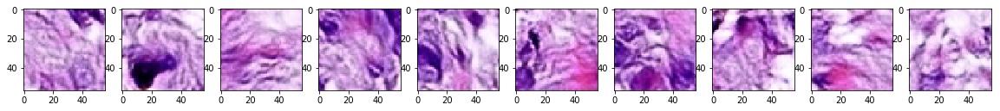

Epochs 2/5: Generator Loss: -9.0244. Discriminator Loss: -0.2154
Epochs 2/5: Generator Loss: 9.7206. Discriminator Loss: -0.2841
Epochs 2/5: Generator Loss: -12.8033. Discriminator Loss: -0.2134
Epochs 2/5: Generator Loss: 9.426. Discriminator Loss: -0.2028
Epochs 2/5: Generator Loss: -3.3773. Discriminator Loss: -0.2507
Epochs 2/5: Generator Loss: 0.3777. Discriminator Loss: -0.1288
Epochs 2/5: Generator Loss: -6.1199. Discriminator Loss: -0.1733
Epochs 2/5: Generator Loss: 5.3888. Discriminator Loss: -0.1665
Epochs 2/5: Generator Loss: -3.5074. Discriminator Loss: -0.1473
Epochs 2/5: Generator Loss: 12.4028. Discriminator Loss: -0.1223


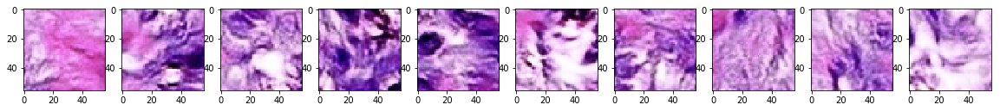

Epochs 2/5: Generator Loss: -6.6426. Discriminator Loss: -0.2856
Epochs 2/5: Generator Loss: -11.2973. Discriminator Loss: -0.1602
Epochs 2/5: Generator Loss: 4.5184. Discriminator Loss: -0.1815
Epochs 2/5: Generator Loss: -0.3073. Discriminator Loss: -0.1476
Epochs 2/5: Generator Loss: -11.2189. Discriminator Loss: -0.1456
Epochs 2/5: Generator Loss: -4.0262. Discriminator Loss: -0.1454
Epochs 2/5: Generator Loss: 1.2699. Discriminator Loss: -0.2152
Epochs 2/5: Generator Loss: 1.9771. Discriminator Loss: -0.1307
Epochs 2/5: Generator Loss: -4.6444. Discriminator Loss: -0.1445
Epochs 2/5: Generator Loss: 0.9076. Discriminator Loss: -0.0736


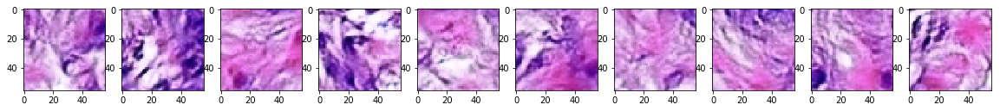

Epochs 2/5: Generator Loss: 4.4945. Discriminator Loss: -0.1573
Epochs 2/5: Generator Loss: -0.2727. Discriminator Loss: -0.2105
Epochs 2/5: Generator Loss: -6.7266. Discriminator Loss: -0.0492
Epochs 2/5: Generator Loss: 5.9242. Discriminator Loss: -0.1724
Epochs 2/5: Generator Loss: 3.1029. Discriminator Loss: -0.1329
Epochs 2/5: Generator Loss: 1.4155. Discriminator Loss: -0.1515
Epochs 2/5: Generator Loss: -13.6941. Discriminator Loss: -0.1623
Epochs 2/5: Generator Loss: 9.3997. Discriminator Loss: -0.163
Epochs 2/5: Generator Loss: -2.7496. Discriminator Loss: -0.1653
Epochs 2/5: Generator Loss: -4.4089. Discriminator Loss: -0.2229


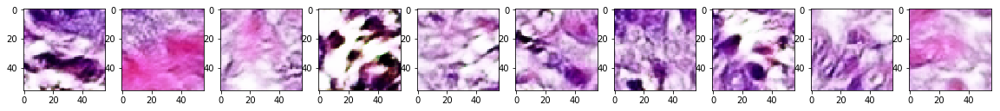

Epochs 2/5: Generator Loss: 2.937. Discriminator Loss: -0.2064
Epochs 2/5: Generator Loss: -3.2529. Discriminator Loss: -0.2531
Epochs 2/5: Generator Loss: 2.367. Discriminator Loss: -0.1013
Epochs 2/5: Generator Loss: -9.0071. Discriminator Loss: -0.1061
Epochs 2/5: Generator Loss: 11.3764. Discriminator Loss: -0.2197
Epochs 2/5: Generator Loss: 0.6743. Discriminator Loss: -0.114
Epochs 2/5: Generator Loss: -0.9734. Discriminator Loss: 0.01
Epochs 2/5: Generator Loss: 4.4999. Discriminator Loss: -0.1655
Epochs 2/5: Generator Loss: 0.707. Discriminator Loss: -0.1532
Epochs 2/5: Generator Loss: -1.578. Discriminator Loss: -0.1437


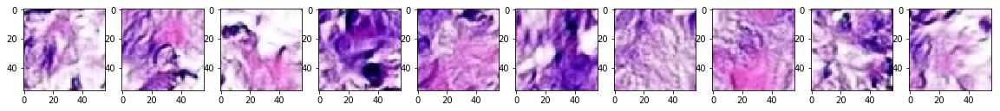

Epochs 2/5: Generator Loss: -1.3672. Discriminator Loss: -0.198
Epochs 2/5: Generator Loss: 8.0694. Discriminator Loss: -0.1199
Epochs 2/5: Generator Loss: -2.0936. Discriminator Loss: -0.1337
Epochs 2/5: Generator Loss: 1.8305. Discriminator Loss: -0.1484
Epochs 2/5: Generator Loss: -3.1516. Discriminator Loss: -0.1836
Epochs 2/5: Generator Loss: 3.4511. Discriminator Loss: -0.1885
Epochs 2/5: Generator Loss: 6.7844. Discriminator Loss: -0.1458
Epochs 2/5: Generator Loss: 1.6899. Discriminator Loss: -0.1364
Epochs 2/5: Generator Loss: -2.3954. Discriminator Loss: -0.1226
Epochs 2/5: Generator Loss: 4.3761. Discriminator Loss: -0.1026


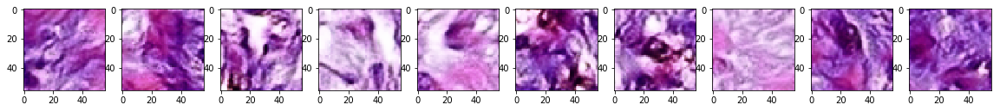

Epochs 2/5: Generator Loss: -5.8705. Discriminator Loss: -0.1931
Epochs 2/5: Generator Loss: -10.0071. Discriminator Loss: -0.2391
Epochs 2/5: Generator Loss: 6.8206. Discriminator Loss: -0.1259
Epochs 2/5: Generator Loss: -2.9843. Discriminator Loss: -0.0996
Epochs 2/5: Generator Loss: -4.1444. Discriminator Loss: -0.2182
Epochs 2/5: Generator Loss: 5.3877. Discriminator Loss: -0.1614
Epochs 2/5: Generator Loss: 2.8762. Discriminator Loss: -0.1636
Epochs 2/5: Generator Loss: -0.493. Discriminator Loss: -0.1901
Epochs 2/5: Generator Loss: -15.3382. Discriminator Loss: -0.2098
Epochs 2/5: Generator Loss: 4.3995. Discriminator Loss: -0.1393


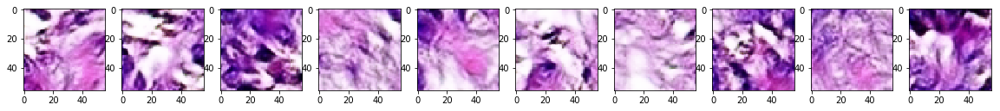

Epochs 2/5: Generator Loss: 0.109. Discriminator Loss: -0.0772
Epochs 2/5: Generator Loss: -4.5761. Discriminator Loss: -0.0884
Epochs 2/5: Generator Loss: 2.7049. Discriminator Loss: -0.1177
Epochs 2/5: Generator Loss: 2.6543. Discriminator Loss: -0.1067
Epochs 2/5: Generator Loss: 0.3839. Discriminator Loss: -0.0627
Epochs 2/5: Generator Loss: -2.9675. Discriminator Loss: -0.134
Epochs 2/5: Generator Loss: 0.9353. Discriminator Loss: -0.1785
Epochs 2/5: Generator Loss: 8.5936. Discriminator Loss: -0.0576
Epochs 2/5: Generator Loss: -2.814. Discriminator Loss: -0.1032
Epochs 2/5: Generator Loss: 5.0154. Discriminator Loss: -0.0809


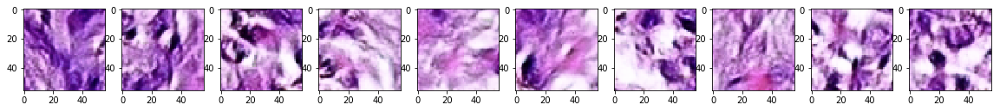

Epochs 2/5: Generator Loss: -0.0315. Discriminator Loss: -0.1415
Epochs 2/5: Generator Loss: -11.4002. Discriminator Loss: -0.0309
Epochs 2/5: Generator Loss: 5.7344. Discriminator Loss: -0.2148
Epochs 2/5: Generator Loss: 3.7253. Discriminator Loss: -0.1513
Epochs 2/5: Generator Loss: -8.1193. Discriminator Loss: -0.1044
Epochs 2/5: Generator Loss: 8.8912. Discriminator Loss: -0.1544
Epochs 2/5: Generator Loss: -1.339. Discriminator Loss: -0.0769
Epochs 2/5: Generator Loss: -7.0089. Discriminator Loss: -0.1452
Epochs 2/5: Generator Loss: -1.9107. Discriminator Loss: -0.0976
Epochs 2/5: Generator Loss: 3.4797. Discriminator Loss: -0.12


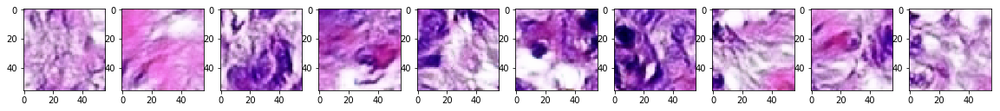

Epochs 2/5: Generator Loss: -2.9161. Discriminator Loss: -0.1765
Epochs 2/5: Generator Loss: 0.6009. Discriminator Loss: -0.1785
Epochs 2/5: Generator Loss: 5.9844. Discriminator Loss: -0.0337
Epochs 2/5: Generator Loss: -6.3462. Discriminator Loss: -0.0009
Epochs 2/5: Generator Loss: -5.3739. Discriminator Loss: -0.0783
Epochs 2/5: Generator Loss: 3.8805. Discriminator Loss: -0.2075
Epochs 2/5: Generator Loss: 5.517. Discriminator Loss: -0.2945
Epochs 2/5: Generator Loss: -12.1309. Discriminator Loss: -0.1649
Epochs 2/5: Generator Loss: -1.9045. Discriminator Loss: -0.0575
Epochs 2/5: Generator Loss: 11.8605. Discriminator Loss: -0.1538


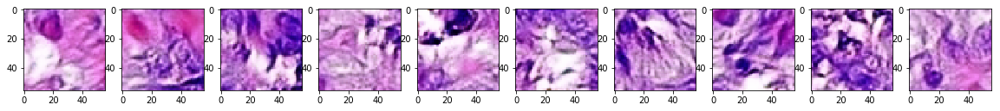

Epochs 2/5: Generator Loss: -4.5655. Discriminator Loss: -0.1586
Epochs 2/5: Generator Loss: -1.2132. Discriminator Loss: -0.1866
Epochs 2/5: Generator Loss: 5.9172. Discriminator Loss: -0.0834
Epochs 2/5: Generator Loss: 0.3313. Discriminator Loss: -0.0561
Epochs 2/5: Generator Loss: -1.7217. Discriminator Loss: -0.0668
Epochs 2/5: Generator Loss: -6.225. Discriminator Loss: -0.1923
Epochs 2/5: Generator Loss: 0.2122. Discriminator Loss: -0.0548
Epochs 2/5: Generator Loss: -3.4679. Discriminator Loss: -0.155
Epochs 2/5: Generator Loss: 1.9471. Discriminator Loss: -0.1572
Epochs 2/5: Generator Loss: 8.6224. Discriminator Loss: -0.2906


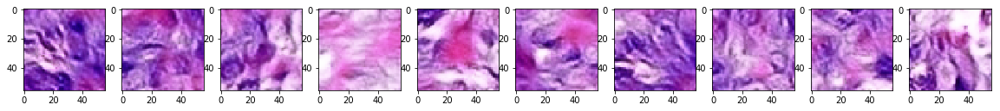

Epochs 2/5: Generator Loss: -3.415. Discriminator Loss: -0.2611
Epochs 2/5: Generator Loss: 11.6708. Discriminator Loss: -0.1037
Epochs 2/5: Generator Loss: -4.9306. Discriminator Loss: -0.2355
Epochs 2/5: Generator Loss: -8.3738. Discriminator Loss: -0.0367
Epochs 2/5: Generator Loss: 3.5861. Discriminator Loss: -0.433
Epochs 2/5: Generator Loss: 14.6624. Discriminator Loss: -0.2909
Epochs 2/5: Generator Loss: 2.1698. Discriminator Loss: -0.0887
Epochs 2/5: Generator Loss: -4.9318. Discriminator Loss: -0.0895
Epochs 2/5: Generator Loss: 4.2749. Discriminator Loss: -0.0711
Epochs 2/5: Generator Loss: 10.7201. Discriminator Loss: -0.1845


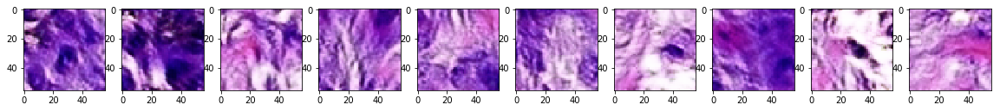

Epochs 2/5: Generator Loss: -5.7377. Discriminator Loss: -0.0631
Epochs 2/5: Generator Loss: -2.2036. Discriminator Loss: -0.1371
Epochs 2/5: Generator Loss: 0.5455. Discriminator Loss: -0.1447
Epochs 2/5: Generator Loss: 10.2354. Discriminator Loss: -0.2276
Epochs 2/5: Generator Loss: -0.9308. Discriminator Loss: -0.145
Epochs 2/5: Generator Loss: -10.6045. Discriminator Loss: -0.2266
Epochs 2/5: Generator Loss: 10.9991. Discriminator Loss: -0.1608
Epochs 2/5: Generator Loss: 1.1054. Discriminator Loss: -0.1821
Epochs 2/5: Generator Loss: -4.0728. Discriminator Loss: -0.1018
Epochs 2/5: Generator Loss: 3.5342. Discriminator Loss: -0.0863


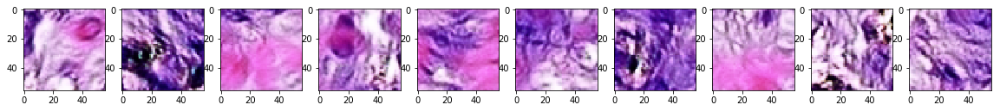

Epochs 2/5: Generator Loss: -4.0556. Discriminator Loss: -0.1711
Epochs 2/5: Generator Loss: 1.0201. Discriminator Loss: -0.1443
Epochs 2/5: Generator Loss: -0.7929. Discriminator Loss: -0.1457
Epochs 2/5: Generator Loss: -4.8517. Discriminator Loss: -0.093
Epochs 2/5: Generator Loss: 2.1161. Discriminator Loss: -0.2211
Epochs 2/5: Generator Loss: 10.2992. Discriminator Loss: -0.108
Epochs 2/5: Generator Loss: -3.4932. Discriminator Loss: -0.2325
Epochs 2/5: Generator Loss: -3.7355. Discriminator Loss: -0.0903
Epochs 2/5: Generator Loss: 10.8333. Discriminator Loss: -0.1955
Epochs 2/5: Generator Loss: -4.0344. Discriminator Loss: -0.126


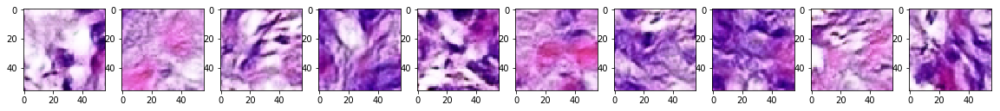

Epochs 2/5: Generator Loss: -1.5834. Discriminator Loss: -0.1592
Epochs 2/5: Generator Loss: 0.3582. Discriminator Loss: -0.1753
Epochs 2/5: Generator Loss: 0.1877. Discriminator Loss: -0.1747
Epochs 2/5: Generator Loss: -27.7682. Discriminator Loss: -0.3529
Epochs 2/5: Generator Loss: 25.6919. Discriminator Loss: -0.3209
Epochs 2/5: Generator Loss: -7.1302. Discriminator Loss: -0.1444
Epochs 2/5: Generator Loss: -5.3003. Discriminator Loss: -0.1606
Epochs 2/5: Generator Loss: 0.023. Discriminator Loss: -0.0474
Epochs 2/5: Generator Loss: -1.3007. Discriminator Loss: -0.0908
Epochs 2/5: Generator Loss: 1.8892. Discriminator Loss: -0.1945


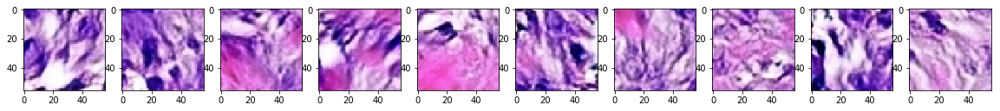

Epochs 2/5: Generator Loss: 6.3436. Discriminator Loss: -0.005
Epochs 2/5: Generator Loss: -0.5627. Discriminator Loss: -0.1122
Epochs 2/5: Generator Loss: -3.9302. Discriminator Loss: -0.2066
Epochs 2/5: Generator Loss: -4.0709. Discriminator Loss: -0.226
Epochs 2/5: Generator Loss: 2.9808. Discriminator Loss: -0.0986
Epochs 2/5: Generator Loss: 2.1094. Discriminator Loss: -0.0955
Epochs 2/5: Generator Loss: -3.6397. Discriminator Loss: -0.123
Epochs 2/5: Generator Loss: 7.5184. Discriminator Loss: -0.0639
Epochs 2/5: Generator Loss: -2.008. Discriminator Loss: -0.1875
Epochs 2/5: Generator Loss: -10.4792. Discriminator Loss: -0.1461


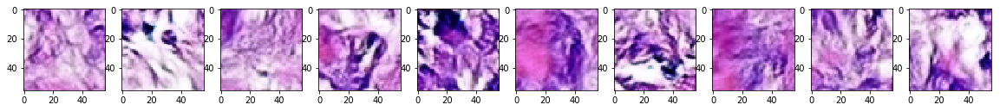

Epochs 2/5: Generator Loss: 3.6911. Discriminator Loss: -0.1655
Epochs 2/5: Generator Loss: 6.5603. Discriminator Loss: -0.0892
Epochs 2/5: Generator Loss: -3.6785. Discriminator Loss: -0.2027
Epochs 2/5: Generator Loss: 3.7446. Discriminator Loss: -0.1534
Epochs 2/5: Generator Loss: 4.7251. Discriminator Loss: -0.2231
Epochs 2/5: Generator Loss: -4.5398. Discriminator Loss: -0.1964
Epochs 2/5: Generator Loss: -2.8723. Discriminator Loss: -0.1451
Epochs 2/5: Generator Loss: 1.731. Discriminator Loss: -0.107
Epochs 2/5: Generator Loss: 7.0104. Discriminator Loss: -0.1719
Epochs 2/5: Generator Loss: -12.2772. Discriminator Loss: 0.0882


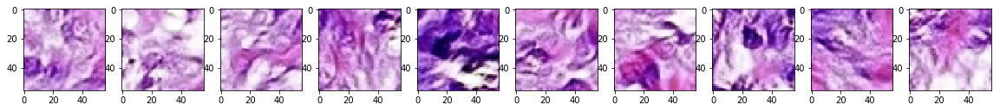

Epochs 2/5: Generator Loss: 5.1054. Discriminator Loss: -0.1946
Epochs 2/5: Generator Loss: 4.8094. Discriminator Loss: -0.2723
Epochs 2/5: Generator Loss: 10.014. Discriminator Loss: -0.1046
Epochs 2/5: Generator Loss: -20.6275. Discriminator Loss: -0.2222
Epochs 2/5: Generator Loss: -6.1901. Discriminator Loss: -0.0636
Epochs 2/5: Generator Loss: 13.8477. Discriminator Loss: -0.2278
Epochs 2/5: Generator Loss: 4.9712. Discriminator Loss: -0.1223
Epochs 2/5: Generator Loss: -1.7482. Discriminator Loss: -0.1757
Epochs 2/5: Generator Loss: 3.0892. Discriminator Loss: -0.0767
Epochs 2/5: Generator Loss: 0.2092. Discriminator Loss: -0.0657


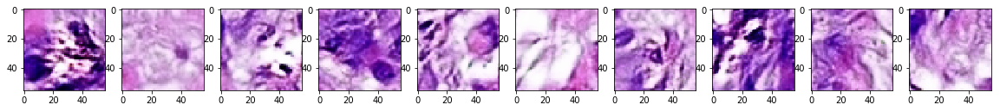

Epochs 2/5: Generator Loss: -4.1145. Discriminator Loss: -0.2936
Epochs 2/5: Generator Loss: 9.9292. Discriminator Loss: -0.1981
Epochs 2/5: Generator Loss: -1.6952. Discriminator Loss: -0.1833
Epochs 2/5: Generator Loss: -7.0969. Discriminator Loss: -0.0655
Epochs 2/5: Generator Loss: 0.6685. Discriminator Loss: -0.1022
Epochs 2/5: Generator Loss: 6.3088. Discriminator Loss: -0.1167
Epochs 2/5: Generator Loss: -3.0372. Discriminator Loss: -0.1294
Epochs 2/5: Generator Loss: -0.9378. Discriminator Loss: -0.0985
Epochs 2/5: Generator Loss: 3.1212. Discriminator Loss: -0.0742
Epochs 2/5: Generator Loss: -8.2085. Discriminator Loss: -0.2353


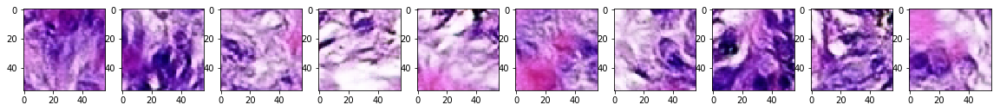

Epochs 2/5: Generator Loss: 3.4068. Discriminator Loss: -0.2682
Epochs 2/5: Generator Loss: -3.6821. Discriminator Loss: 0.01
Epochs 2/5: Generator Loss: 8.9819. Discriminator Loss: -0.1671
Epochs 2/5: Generator Loss: -7.5123. Discriminator Loss: -0.1609
Epochs 2/5: Generator Loss: -5.6697. Discriminator Loss: -0.0229
Epochs 2/5: Generator Loss: -1.6517. Discriminator Loss: -0.2777
Epochs 2/5: Generator Loss: 4.9611. Discriminator Loss: -0.1381
Epochs 2/5: Generator Loss: 6.7416. Discriminator Loss: -0.1226
Epochs 2/5: Generator Loss: -3.6106. Discriminator Loss: -0.2515
Epochs 2/5: Generator Loss: -9.8321. Discriminator Loss: -0.152


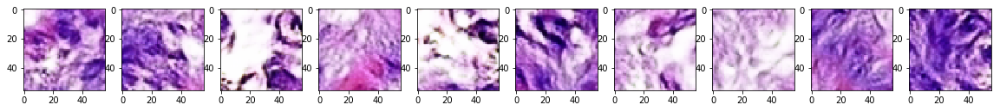

Epochs 2/5: Generator Loss: 11.388. Discriminator Loss: -0.1051
Epochs 2/5: Generator Loss: -13.0683. Discriminator Loss: -0.1615
Epochs 2/5: Generator Loss: 3.5223. Discriminator Loss: -0.3058
Epochs 2/5: Generator Loss: -0.8939. Discriminator Loss: -0.2097
Epochs 2/5: Generator Loss: -9.6072. Discriminator Loss: -0.1467
Epochs 2/5: Generator Loss: -0.4795. Discriminator Loss: -0.1828
Epochs 2/5: Generator Loss: 4.5581. Discriminator Loss: -0.1596
Epochs 2/5: Generator Loss: 2.6813. Discriminator Loss: -0.1654
Epochs 2/5: Generator Loss: -2.3894. Discriminator Loss: -0.1401
Epochs 2/5: Generator Loss: -4.056. Discriminator Loss: -0.0716


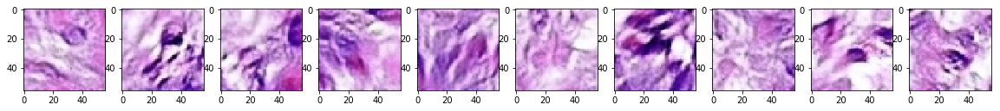

Epochs 2/5: Generator Loss: -0.7013. Discriminator Loss: -0.1729
Epochs 2/5: Generator Loss: 2.5005. Discriminator Loss: -0.0327
Epochs 2/5: Generator Loss: 2.5135. Discriminator Loss: -0.0958
Epochs 2/5: Generator Loss: -9.1269. Discriminator Loss: 0.0003
Epochs 2/5: Generator Loss: -3.9292. Discriminator Loss: -0.096
Epochs 2/5: Generator Loss: 3.1986. Discriminator Loss: -0.1187
Epochs 2/5: Generator Loss: 0.0961. Discriminator Loss: -0.1334
Epochs 2/5: Generator Loss: -4.7172. Discriminator Loss: -0.0765
Epochs 2/5: Generator Loss: -2.3355. Discriminator Loss: -0.1119
Epochs 2/5: Generator Loss: -1.0844. Discriminator Loss: -0.1193


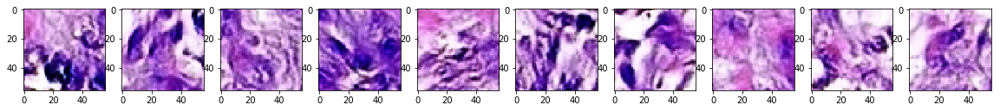

Epochs 2/5: Generator Loss: 7.2023. Discriminator Loss: -0.1242
Epochs 2/5: Generator Loss: -1.5142. Discriminator Loss: -0.1913
Epochs 2/5: Generator Loss: -0.04. Discriminator Loss: -0.2026
Epochs 2/5: Generator Loss: 4.0514. Discriminator Loss: -0.2214
Epochs 2/5: Generator Loss: -5.5082. Discriminator Loss: -0.1298
Epochs 2/5: Generator Loss: -4.1824. Discriminator Loss: -0.0635
Epochs 2/5: Generator Loss: 7.9464. Discriminator Loss: -0.0069
Epochs 2/5: Generator Loss: -15.3892. Discriminator Loss: -0.1726
Epochs 2/5: Generator Loss: 11.0414. Discriminator Loss: -0.2908
Epochs 2/5: Generator Loss: 2.6892. Discriminator Loss: -0.1857


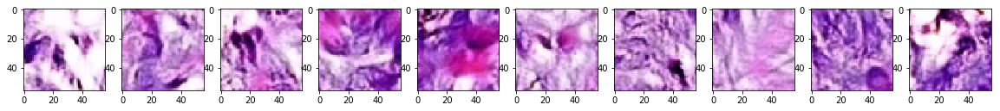

Epochs 2/5: Generator Loss: 5.5322. Discriminator Loss: -0.157
Epochs 2/5: Generator Loss: 4.2266. Discriminator Loss: -0.1332
Epochs 2/5: Generator Loss: -5.6148. Discriminator Loss: -0.0741
Epochs 2/5: Generator Loss: 2.6467. Discriminator Loss: -0.1422
Epochs 2/5: Generator Loss: 0.6393. Discriminator Loss: -0.199
Epochs 2/5: Generator Loss: -3.2918. Discriminator Loss: -0.1704
Epochs 2/5: Generator Loss: 7.2217. Discriminator Loss: -0.16
Epochs 2/5: Generator Loss: -3.3169. Discriminator Loss: -0.1953
Epochs 2/5: Generator Loss: 0.9618. Discriminator Loss: -0.0372
Epochs 2/5: Generator Loss: 6.0577. Discriminator Loss: -0.1238


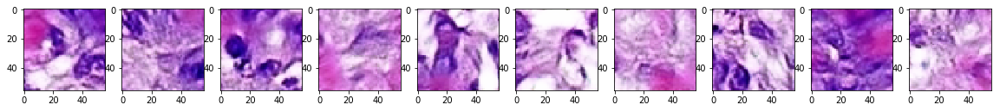

Epochs 2/5: Generator Loss: -10.9566. Discriminator Loss: -0.1529
Epochs 2/5: Generator Loss: -2.4106. Discriminator Loss: -0.1592
Epochs 2/5: Generator Loss: 0.2296. Discriminator Loss: -0.2161
Epochs 2/5: Generator Loss: -4.0383. Discriminator Loss: -0.1413
Epochs 2/5: Generator Loss: 3.3964. Discriminator Loss: -0.1245
Epochs 2/5: Generator Loss: -1.948. Discriminator Loss: -0.1417
Epochs 2/5: Generator Loss: -6.0005. Discriminator Loss: -0.0517
Epochs 2/5: Generator Loss: 1.373. Discriminator Loss: -0.1114
Epochs 2/5: Generator Loss: -5.4664. Discriminator Loss: -0.136
Epochs 2/5: Generator Loss: 3.4924. Discriminator Loss: -0.0713


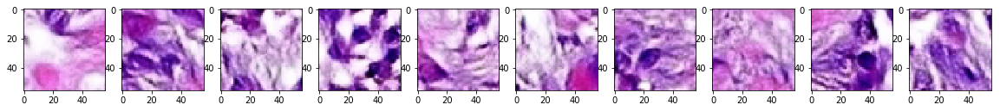

Epochs 2/5: Generator Loss: 0.1056. Discriminator Loss: -0.1393
Epochs 2/5: Generator Loss: -5.7303. Discriminator Loss: -0.1631
Epochs 2/5: Generator Loss: 2.6573. Discriminator Loss: -0.1134
Epochs 2/5: Generator Loss: 0.6393. Discriminator Loss: -0.1375
Epochs 2/5: Generator Loss: -12.7712. Discriminator Loss: -0.2176
Epochs 2/5: Generator Loss: 3.6487. Discriminator Loss: -0.1963
Epochs 2/5: Generator Loss: -8.0018. Discriminator Loss: -0.1709
Epochs 2/5: Generator Loss: -11.3875. Discriminator Loss: -0.0372
Epochs 2/5: Generator Loss: 0.2916. Discriminator Loss: -0.0564
Epochs 2/5: Generator Loss: 4.6029. Discriminator Loss: -0.1543


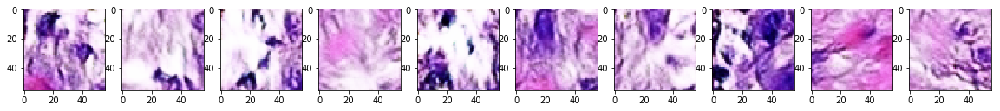

Epochs 2/5: Generator Loss: 12.604. Discriminator Loss: -0.2216
Epochs 2/5: Generator Loss: -6.0529. Discriminator Loss: -0.1706
Epochs 2/5: Generator Loss: -2.4646. Discriminator Loss: -0.0732
Epochs 2/5: Generator Loss: 3.9862. Discriminator Loss: -0.2184
Epochs 2/5: Generator Loss: 7.3457. Discriminator Loss: -0.0651
Epochs 2/5: Generator Loss: -13.9697. Discriminator Loss: -0.256
Epochs 2/5: Generator Loss: -0.5608. Discriminator Loss: -0.1493
Epochs 2/5: Generator Loss: 3.28. Discriminator Loss: -0.0653
Epochs 2/5: Generator Loss: -3.8601. Discriminator Loss: -0.3319
Epochs 2/5: Generator Loss: -4.6598. Discriminator Loss: -0.106


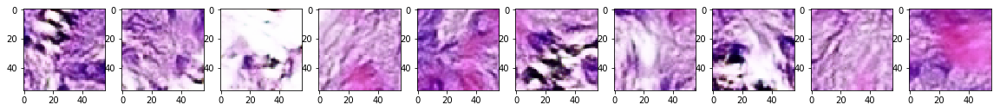

Epochs 2/5: Generator Loss: 5.4771. Discriminator Loss: -0.2933
Epochs 2/5: Generator Loss: 0.0921. Discriminator Loss: -0.0869
Epochs 2/5: Generator Loss: 1.134. Discriminator Loss: -0.1269
Epochs 2/5: Generator Loss: -2.4251. Discriminator Loss: -0.1258
Epochs 2/5: Generator Loss: 3.1756. Discriminator Loss: -0.1029
Epochs 2/5: Generator Loss: 6.0021. Discriminator Loss: -0.2129
Epochs 2/5: Generator Loss: 5.489. Discriminator Loss: -0.0353
Epochs 2/5: Generator Loss: -4.0423. Discriminator Loss: -0.1526
Epochs 2/5: Generator Loss: -3.6219. Discriminator Loss: -0.1612
Epochs 2/5: Generator Loss: 8.2842. Discriminator Loss: -0.0363


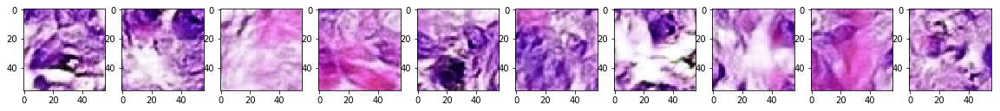

Epochs 2/5: Generator Loss: -8.4498. Discriminator Loss: -0.0551
Epochs 2/5: Generator Loss: 0.7393. Discriminator Loss: -0.0685
Epochs 2/5: Generator Loss: 5.0733. Discriminator Loss: -0.0316
Epochs 2/5: Generator Loss: 3.5867. Discriminator Loss: -0.06
Epochs 2/5: Generator Loss: -4.8861. Discriminator Loss: -0.2496
Epochs 2/5: Generator Loss: -1.6837. Discriminator Loss: -0.2402
Epochs 2/5: Generator Loss: 11.5908. Discriminator Loss: -0.1325
Epochs 2/5: Generator Loss: -6.8509. Discriminator Loss: -0.1663
Epochs 2/5: Generator Loss: -4.5354. Discriminator Loss: -0.0907
Epochs 2/5: Generator Loss: 1.4924. Discriminator Loss: -0.1008


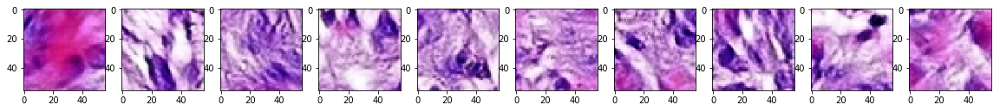

Epochs 2/5: Generator Loss: 0.5122. Discriminator Loss: -0.1739
Epochs 2/5: Generator Loss: 3.798. Discriminator Loss: -0.2081
Epochs 2/5: Generator Loss: 8.1514. Discriminator Loss: -0.129
Epochs 2/5: Generator Loss: 5.144. Discriminator Loss: -0.1503
Epochs 2/5: Generator Loss: -4.5821. Discriminator Loss: -0.1609
Epochs 2/5: Generator Loss: 6.4264. Discriminator Loss: 0.0764
Epochs 2/5: Generator Loss: 0.4761. Discriminator Loss: -0.2785
Epochs 2/5: Generator Loss: 14.9059. Discriminator Loss: -0.1738
Epochs 2/5: Generator Loss: -1.3581. Discriminator Loss: -0.0649
Epochs 2/5: Generator Loss: -10.1696. Discriminator Loss: -0.0905


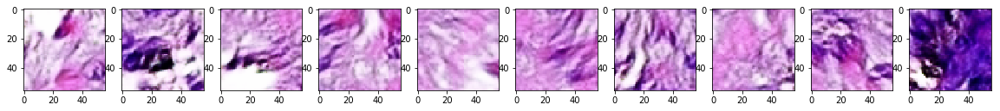

Epochs 2/5: Generator Loss: 2.3236. Discriminator Loss: -0.0937
Epochs 2/5: Generator Loss: 1.5554. Discriminator Loss: -0.1705
Epochs 2/5: Generator Loss: 0.8377. Discriminator Loss: -0.0512
Epochs 2/5: Generator Loss: -13.4265. Discriminator Loss: -0.1381
Epochs 2/5: Generator Loss: 11.3993. Discriminator Loss: -0.235
Epochs 2/5: Generator Loss: -13.6642. Discriminator Loss: -0.3295
Epochs 2/5: Generator Loss: 9.856. Discriminator Loss: -0.2037
Epochs 2/5: Generator Loss: -12.0827. Discriminator Loss: -0.1934
Epochs 2/5: Generator Loss: -3.2412. Discriminator Loss: -0.1611
Epochs 2/5: Generator Loss: 2.9362. Discriminator Loss: -0.0899


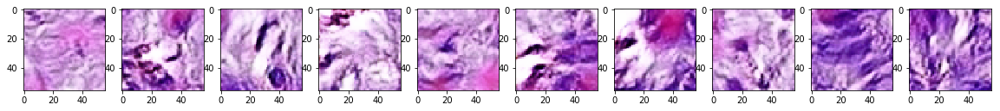

Epochs 2/5: Generator Loss: -3.886. Discriminator Loss: -0.1406
Epochs 2/5: Generator Loss: -2.2257. Discriminator Loss: -0.1746
Epochs 2/5: Generator Loss: 0.5989. Discriminator Loss: -0.0967
Epochs 2/5: Generator Loss: 2.6432. Discriminator Loss: -0.0147
Epochs 2/5: Generator Loss: -2.1751. Discriminator Loss: -0.0248
Epochs 2/5: Generator Loss: 2.0827. Discriminator Loss: -0.2104
Epochs 2/5: Generator Loss: -19.8165. Discriminator Loss: -0.2545
Epochs 2/5: Generator Loss: -0.1737. Discriminator Loss: -0.1906
Epochs 2/5: Generator Loss: 1.6741. Discriminator Loss: -0.0561
Epochs 2/5: Generator Loss: -12.148. Discriminator Loss: -0.0138


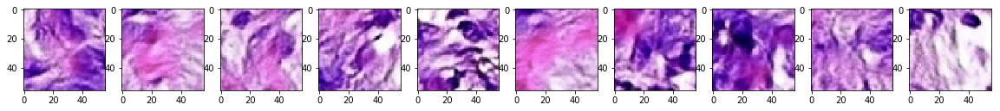

Epochs 2/5: Generator Loss: 9.0822. Discriminator Loss: -0.1532
Epochs 2/5: Generator Loss: 3.1745. Discriminator Loss: -0.1388
Epochs 2/5: Generator Loss: -3.482. Discriminator Loss: -0.127
Epochs 2/5: Generator Loss: -5.5534. Discriminator Loss: -0.0568
Epochs 2/5: Generator Loss: -0.5148. Discriminator Loss: -0.103
Epochs 2/5: Generator Loss: 10.0015. Discriminator Loss: -0.1724
Epochs 2/5: Generator Loss: 7.4585. Discriminator Loss: -0.2863
Epochs 2/5: Generator Loss: -6.9107. Discriminator Loss: -0.0968
Epochs 2/5: Generator Loss: -4.0989. Discriminator Loss: -0.1212
Epochs 2/5: Generator Loss: 4.0284. Discriminator Loss: -0.1236


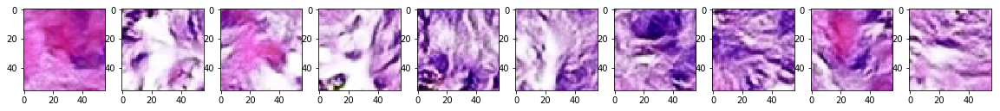

Epochs 2/5: Generator Loss: -3.5182. Discriminator Loss: -0.2098
Epochs 2/5: Generator Loss: -6.5007. Discriminator Loss: -0.0862
Epochs 2/5: Generator Loss: 12.8459. Discriminator Loss: -0.2649
Epochs 2/5: Generator Loss: -0.025. Discriminator Loss: -0.1372
Epochs 2/5: Generator Loss: -1.9199. Discriminator Loss: -0.0017
Epochs 2/5: Generator Loss: -11.9768. Discriminator Loss: -0.158
Epochs 2/5: Generator Loss: 4.6016. Discriminator Loss: -0.1365
Epochs 2/5: Generator Loss: 9.0354. Discriminator Loss: -0.149
Epochs 2/5: Generator Loss: -8.2289. Discriminator Loss: -0.2439
Epochs 2/5: Generator Loss: -3.0463. Discriminator Loss: -0.1493


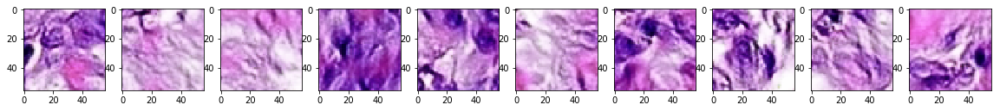

Epochs 2/5: Generator Loss: 9.1373. Discriminator Loss: -0.1968
Epochs 2/5: Generator Loss: -3.7923. Discriminator Loss: -0.1433
Epochs 2/5: Generator Loss: -3.304. Discriminator Loss: -0.1787
Epochs 2/5: Generator Loss: 0.3533. Discriminator Loss: -0.1891
Epochs 2/5: Generator Loss: 2.5036. Discriminator Loss: -0.1305
Epochs 2/5: Generator Loss: 0.1085. Discriminator Loss: -0.1423
Epochs 2/5: Generator Loss: -3.314. Discriminator Loss: -0.1802
Epochs 2/5: Generator Loss: 2.9154. Discriminator Loss: -0.162
Epochs 2/5: Generator Loss: -3.1915. Discriminator Loss: -0.2539
Epochs 2/5: Generator Loss: 1.9783. Discriminator Loss: -0.1269


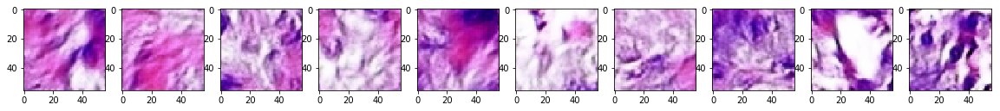

Epochs 2/5: Generator Loss: -4.4034. Discriminator Loss: -0.1727
Epochs 2/5: Generator Loss: 6.9663. Discriminator Loss: -0.0948
Epochs 2/5: Generator Loss: 0.2781. Discriminator Loss: -0.1752
Epochs 2/5: Generator Loss: 5.256. Discriminator Loss: -0.1525
Epochs 2/5: Generator Loss: 8.7384. Discriminator Loss: -0.1016
Epochs 2/5: Generator Loss: -9.4414. Discriminator Loss: -0.1728
Epochs 2/5: Generator Loss: 1.7424. Discriminator Loss: -0.2108
Epochs 2/5: Generator Loss: 3.8412. Discriminator Loss: -0.1275
Epochs 2/5: Generator Loss: 3.1011. Discriminator Loss: -0.1611
Epochs 2/5: Generator Loss: -3.9722. Discriminator Loss: -0.1455


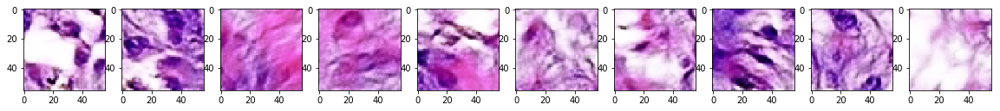

Epochs 2/5: Generator Loss: -0.1131. Discriminator Loss: -0.1539
Epochs 2/5: Generator Loss: 5.3517. Discriminator Loss: -0.1585
Epochs 2/5: Generator Loss: 3.8812. Discriminator Loss: -0.1594
Epochs 2/5: Generator Loss: -2.0843. Discriminator Loss: -0.1282
Epochs 2/5: Generator Loss: -4.9571. Discriminator Loss: -0.1791
Epochs 2/5: Generator Loss: 0.4266. Discriminator Loss: -0.024
Epochs 2/5: Generator Loss: 8.0258. Discriminator Loss: -0.1674
Epochs 2/5: Generator Loss: 0.4605. Discriminator Loss: -0.1244
Epochs 2/5: Generator Loss: -12.9618. Discriminator Loss: -0.1043
Epochs 2/5: Generator Loss: 0.4788. Discriminator Loss: -0.2697


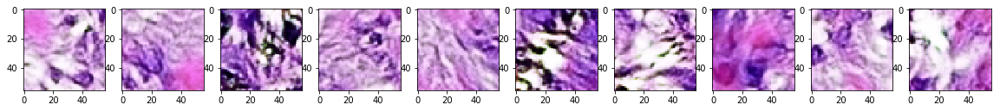

Epochs 2/5: Generator Loss: 6.356. Discriminator Loss: -0.0836
Epochs 2/5: Generator Loss: 6.5568. Discriminator Loss: -0.1801
Epochs 2/5: Generator Loss: -1.1716. Discriminator Loss: -0.0475
Epochs 2/5: Generator Loss: -0.2912. Discriminator Loss: -0.1625
Epochs 2/5: Generator Loss: 0.9614. Discriminator Loss: -0.131
Epochs 2/5: Generator Loss: 4.5495. Discriminator Loss: -0.0154
Epochs 2/5: Generator Loss: -8.8378. Discriminator Loss: -0.2131
Epochs 2/5: Generator Loss: -3.2124. Discriminator Loss: -0.1744
Epochs 2/5: Generator Loss: 1.7732. Discriminator Loss: -0.1611
Epochs 2/5: Generator Loss: 0.9782. Discriminator Loss: -0.1366


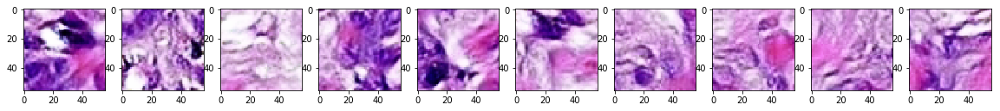

Epochs 2/5: Generator Loss: -3.3176. Discriminator Loss: -0.1743
Epochs 2/5: Generator Loss: -3.5553. Discriminator Loss: -0.176
Epochs 2/5: Generator Loss: 7.1382. Discriminator Loss: -0.1413
Epochs 2/5: Generator Loss: 5.13. Discriminator Loss: -0.0835
Epochs 2/5: Generator Loss: 2.2613. Discriminator Loss: -0.0465
Epochs 2/5: Generator Loss: -1.0237. Discriminator Loss: -0.1099
Epochs 2/5: Generator Loss: -10.5198. Discriminator Loss: -0.1872
Epochs 2/5: Generator Loss: -1.7148. Discriminator Loss: -0.0956
Epochs 2/5: Generator Loss: 6.5976. Discriminator Loss: -0.1235
Epochs 2/5: Generator Loss: 3.2272. Discriminator Loss: -0.1513


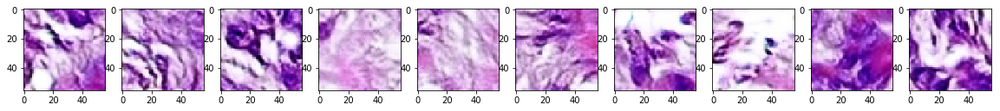

Epochs 2/5: Generator Loss: -4.7864. Discriminator Loss: -0.0908
Epochs 2/5: Generator Loss: 0.4552. Discriminator Loss: -0.1118
Epochs 2/5: Generator Loss: 2.8234. Discriminator Loss: -0.1041
Epochs 2/5: Generator Loss: 5.3937. Discriminator Loss: -0.1164
Epochs 2/5: Generator Loss: -8.0812. Discriminator Loss: -0.2081
Epochs 2/5: Generator Loss: -4.9436. Discriminator Loss: -0.2589
Epochs 2/5: Generator Loss: 6.8157. Discriminator Loss: -0.2041
Epochs 2/5: Generator Loss: 1.9722. Discriminator Loss: -0.1224
Epochs 2/5: Generator Loss: -1.3207. Discriminator Loss: -0.1385
Epochs 2/5: Generator Loss: -3.7221. Discriminator Loss: -0.1178


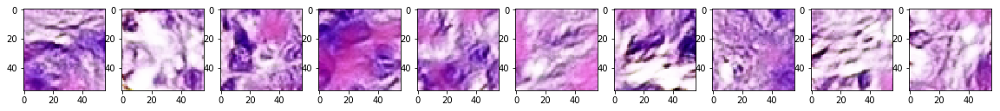

Epochs 2/5: Generator Loss: 2.9089. Discriminator Loss: -0.0468
Epochs 2/5: Generator Loss: 1.9956. Discriminator Loss: -0.0381
Epochs 2/5: Generator Loss: 3.1671. Discriminator Loss: -0.1015
Epochs 2/5: Generator Loss: -10.795. Discriminator Loss: -0.1253
Epochs 2/5: Generator Loss: 6.4855. Discriminator Loss: -0.1282
Epochs 2/5: Generator Loss: -4.3053. Discriminator Loss: -0.2159
Epochs 2/5: Generator Loss: -7.3561. Discriminator Loss: -0.0053
Epochs 2/5: Generator Loss: 3.3906. Discriminator Loss: -0.0481
Epochs 2/5: Generator Loss: 0.6176. Discriminator Loss: -0.1548
Epochs 2/5: Generator Loss: -3.2715. Discriminator Loss: 0.0132


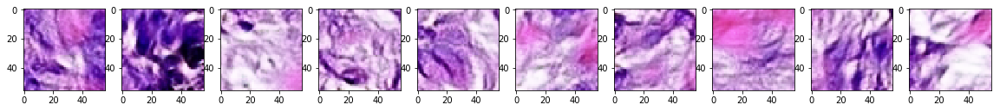

Epochs 2/5: Generator Loss: 5.446. Discriminator Loss: -0.1616
Epochs 2/5: Generator Loss: -2.958. Discriminator Loss: -0.1249
Epochs 2/5: Generator Loss: 6.5632. Discriminator Loss: -0.2513
Epochs 2/5: Generator Loss: -3.1672. Discriminator Loss: -0.1588
Epochs 2/5: Generator Loss: 2.0917. Discriminator Loss: -0.1142
Epochs 2/5: Generator Loss: -3.1421. Discriminator Loss: -0.0628
Epochs 2/5: Generator Loss: -0.0368. Discriminator Loss: -0.0961
Epochs 2/5: Generator Loss: 3.4833. Discriminator Loss: -0.1342
Epochs 2/5: Generator Loss: -11.8687. Discriminator Loss: -0.2606
Epochs 2/5: Generator Loss: 2.2498. Discriminator Loss: -0.1384


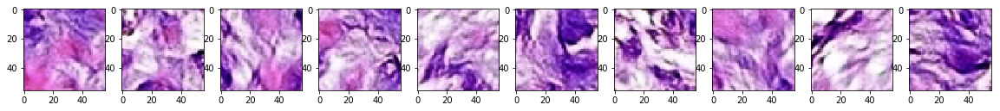

Epochs 2/5: Generator Loss: 3.1846. Discriminator Loss: -0.1753
Epochs 2/5: Generator Loss: -2.5548. Discriminator Loss: -0.1285
Epochs 2/5: Generator Loss: 2.4121. Discriminator Loss: -0.1534
Epochs 2/5: Generator Loss: -9.5215. Discriminator Loss: -0.0871
Epochs 2/5: Generator Loss: 12.0808. Discriminator Loss: -0.2374
Epochs 2/5: Generator Loss: -0.1036. Discriminator Loss: -0.0797
Epochs 2/5: Generator Loss: -6.8779. Discriminator Loss: -0.0816
Epochs 2/5: Generator Loss: 2.3317. Discriminator Loss: -0.1801
Epochs 2/5: Generator Loss: 0.9447. Discriminator Loss: -0.1613
Epochs 2/5: Generator Loss: -4.2753. Discriminator Loss: -0.1732


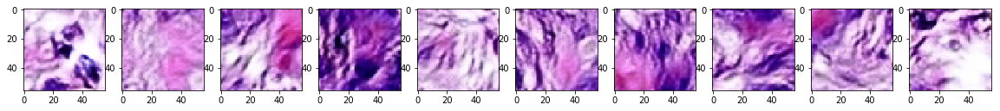

Epochs 2/5: Generator Loss: 0.0896. Discriminator Loss: -0.1393
Epochs 2/5: Generator Loss: 1.9595. Discriminator Loss: -0.1837
Epochs 2/5: Generator Loss: -1.876. Discriminator Loss: -0.201
Epochs 2/5: Generator Loss: -2.2741. Discriminator Loss: -0.1749
Epochs 2/5: Generator Loss: -0.7381. Discriminator Loss: -0.1179
Epochs 2/5: Generator Loss: 0.4465. Discriminator Loss: -0.1641
Epochs 2/5: Generator Loss: -2.9611. Discriminator Loss: -0.1929
Epochs 2/5: Generator Loss: 3.5036. Discriminator Loss: -0.0667
Epochs 2/5: Generator Loss: -2.7842. Discriminator Loss: -0.1475
Epochs 2/5: Generator Loss: -3.4498. Discriminator Loss: -0.0959


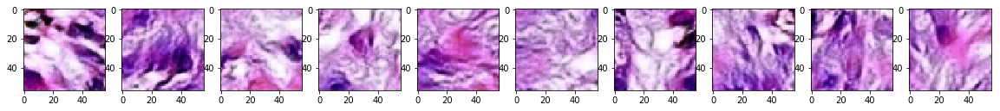

Epochs 2/5: Generator Loss: 15.7502. Discriminator Loss: -0.2218
Epochs 2/5: Generator Loss: -5.69. Discriminator Loss: -0.2353
Epochs 2/5: Generator Loss: -7.2783. Discriminator Loss: -0.0822
Epochs 2/5: Generator Loss: 0.3563. Discriminator Loss: -0.0062
Epochs 2/5: Generator Loss: 4.0904. Discriminator Loss: -0.015
Epochs 2/5: Generator Loss: -2.7388. Discriminator Loss: -0.2159
Epochs 2/5: Generator Loss: -20.3592. Discriminator Loss: -0.3143
Epochs 2/5: Generator Loss: 17.9789. Discriminator Loss: -0.2172
Epochs 2/5: Generator Loss: 4.2465. Discriminator Loss: -0.135
Epochs 2/5: Generator Loss: 0.3264. Discriminator Loss: -0.1948


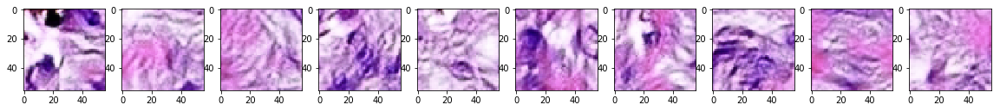

Epochs 2/5: Generator Loss: -15.1168. Discriminator Loss: -0.1785
Epochs 2/5: Generator Loss: 13.4259. Discriminator Loss: -0.0409
Epochs 2/5: Generator Loss: -0.9204. Discriminator Loss: -0.1619
Epochs 2/5: Generator Loss: 0.7087. Discriminator Loss: -0.2166
Epochs 2/5: Generator Loss: -3.5872. Discriminator Loss: -0.125
Epochs 2/5: Generator Loss: -1.6611. Discriminator Loss: -0.143
Epochs 2/5: Generator Loss: 3.3083. Discriminator Loss: -0.0413
Epochs 2/5: Generator Loss: -4.4047. Discriminator Loss: -0.0296
Epochs 2/5: Generator Loss: -0.6366. Discriminator Loss: -0.1
Epochs 2/5: Generator Loss: -0.0038. Discriminator Loss: -0.0683


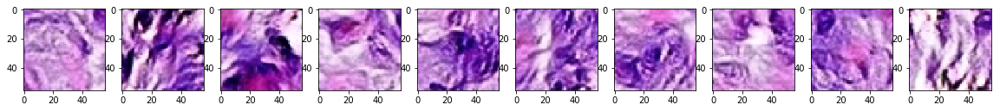

Epochs 2/5: Generator Loss: 7.1155. Discriminator Loss: -0.0853
Epochs 2/5: Generator Loss: -5.4741. Discriminator Loss: -0.1963
Epochs 2/5: Generator Loss: -1.9348. Discriminator Loss: -0.1322
Epochs 2/5: Generator Loss: -3.602. Discriminator Loss: -0.2207
Epochs 2/5: Generator Loss: 5.7688. Discriminator Loss: -0.2474
Epochs 2/5: Generator Loss: -5.9821. Discriminator Loss: -0.2058
Epochs 2/5: Generator Loss: 7.3732. Discriminator Loss: -0.2463
Epochs 2/5: Generator Loss: 0.6717. Discriminator Loss: -0.2786
Epochs 2/5: Generator Loss: 2.1385. Discriminator Loss: -0.1129
Epochs 2/5: Generator Loss: -7.1529. Discriminator Loss: -0.1649


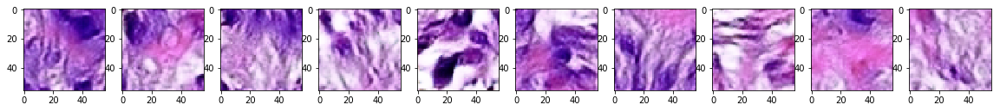

Epochs 2/5: Generator Loss: -1.6195. Discriminator Loss: -0.1639
Epochs 2/5: Generator Loss: 1.8033. Discriminator Loss: -0.1192
Epochs 2/5: Generator Loss: -8.058. Discriminator Loss: -0.2363
Epochs 2/5: Generator Loss: -0.8718. Discriminator Loss: -0.1392
Epochs 2/5: Generator Loss: -7.5311. Discriminator Loss: -0.2268
Epochs 2/5: Generator Loss: 13.3949. Discriminator Loss: -0.3849
Epochs 2/5: Generator Loss: 12.8042. Discriminator Loss: -0.1486
Epochs 2/5: Generator Loss: 5.5225. Discriminator Loss: -0.071
Epochs 2/5: Generator Loss: -10.147. Discriminator Loss: -0.1046
Epochs 2/5: Generator Loss: 3.6167. Discriminator Loss: -0.0494


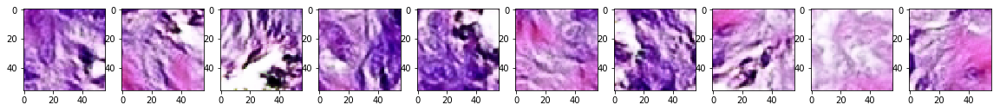

Epochs 2/5: Generator Loss: 7.8772. Discriminator Loss: -0.1495
Epochs 2/5: Generator Loss: -0.3117. Discriminator Loss: -0.141
Epochs 2/5: Generator Loss: -9.6498. Discriminator Loss: -0.2362
Epochs 2/5: Generator Loss: 4.4514. Discriminator Loss: -0.2021
Epochs 2/5: Generator Loss: 1.2114. Discriminator Loss: -0.1123
Epochs 2/5: Generator Loss: -1.7216. Discriminator Loss: -0.1034
Epochs 2/5: Generator Loss: 0.4994. Discriminator Loss: -0.2054
Epochs 2/5: Generator Loss: -7.5776. Discriminator Loss: -0.2966
Epochs 2/5: Generator Loss: 3.7783. Discriminator Loss: -0.2079
Epochs 2/5: Generator Loss: -10.31. Discriminator Loss: -0.0449


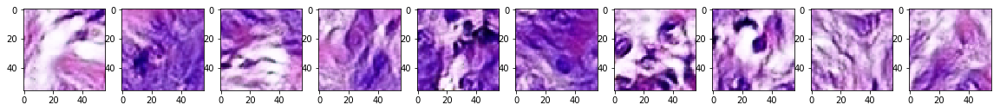

Epochs 2/5: Generator Loss: -5.5192. Discriminator Loss: -0.0085
Epochs 2/5: Generator Loss: 6.2651. Discriminator Loss: -0.0591
Epochs 2/5: Generator Loss: 5.159. Discriminator Loss: -0.1846
Epochs 2/5: Generator Loss: 3.5671. Discriminator Loss: -0.0578
Epochs 2/5: Generator Loss: 0.2963. Discriminator Loss: -0.0626
Epochs 2/5: Generator Loss: -10.0768. Discriminator Loss: -0.147
Epochs 2/5: Generator Loss: -0.1528. Discriminator Loss: -0.1443
Epochs 2/5: Generator Loss: -2.1126. Discriminator Loss: 0.0274
Epochs 2/5: Generator Loss: 1.2069. Discriminator Loss: -0.1087
Epochs 2/5: Generator Loss: -4.127. Discriminator Loss: -0.1059


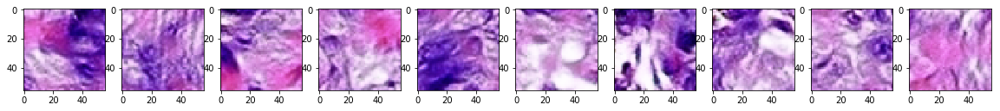

Epochs 2/5: Generator Loss: -2.2076. Discriminator Loss: -0.1073
Epochs 2/5: Generator Loss: 10.6723. Discriminator Loss: -0.131
Epochs 2/5: Generator Loss: -26.4788. Discriminator Loss: -0.3432
Epochs 2/5: Generator Loss: 10.2862. Discriminator Loss: -0.2658
Epochs 2/5: Generator Loss: -0.2725. Discriminator Loss: -0.1095
Epochs 2/5: Generator Loss: 0.7518. Discriminator Loss: -0.1397
Epochs 2/5: Generator Loss: 7.5647. Discriminator Loss: -0.1537
Epochs 2/5: Generator Loss: -11.7182. Discriminator Loss: -0.0871
Epochs 2/5: Generator Loss: -0.6179. Discriminator Loss: -0.0814
Epochs 2/5: Generator Loss: -3.3262. Discriminator Loss: -0.1799


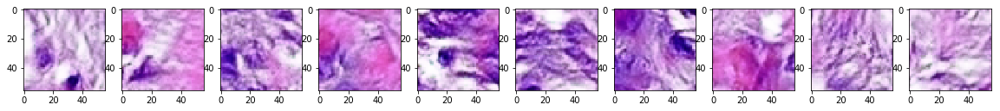

Epochs 2/5: Generator Loss: 1.1461. Discriminator Loss: -0.3295
Epochs 2/5: Generator Loss: 0.76. Discriminator Loss: -0.101
Epochs 2/5: Generator Loss: 0.3241. Discriminator Loss: -0.114
Epochs 2/5: Generator Loss: 2.6255. Discriminator Loss: -0.0745
Epochs 2/5: Generator Loss: 5.7664. Discriminator Loss: -0.1676
Epochs 2/5: Generator Loss: 0.9313. Discriminator Loss: -0.1765
Epochs 2/5: Generator Loss: -2.053. Discriminator Loss: -0.1395
Epochs 2/5: Generator Loss: 1.4909. Discriminator Loss: -0.2038
Epochs 2/5: Generator Loss: -1.863. Discriminator Loss: -0.0691
Epochs 2/5: Generator Loss: 4.1632. Discriminator Loss: -0.1141


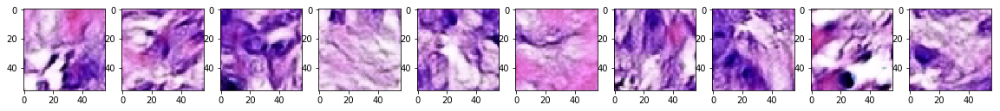

Epochs 2/5: Generator Loss: 3.539. Discriminator Loss: -0.1316
Epochs 2/5: Generator Loss: -0.4916. Discriminator Loss: -0.1482
Epochs 2/5: Generator Loss: -0.6936. Discriminator Loss: -0.0652
Epochs 2/5: Generator Loss: -15.083. Discriminator Loss: -0.1014
Epochs 2/5: Generator Loss: 13.0619. Discriminator Loss: 0.0367
Epochs 2/5: Generator Loss: -1.904. Discriminator Loss: 0.0474
Epochs 2/5: Generator Loss: 2.4799. Discriminator Loss: -0.098
Epochs 2/5: Generator Loss: -7.1672. Discriminator Loss: -0.0767
Epochs 2/5: Generator Loss: 6.0372. Discriminator Loss: -0.104
Epochs 2/5: Generator Loss: 2.5437. Discriminator Loss: -0.1283


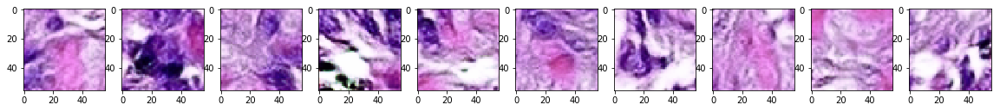

Epochs 2/5: Generator Loss: -11.7174. Discriminator Loss: -0.0497
Epochs 2/5: Generator Loss: -10.0766. Discriminator Loss: -0.1116
Epochs 2/5: Generator Loss: 3.2853. Discriminator Loss: -0.098
Epochs 2/5: Generator Loss: -2.1892. Discriminator Loss: -0.1101
Epochs 2/5: Generator Loss: -1.7717. Discriminator Loss: -0.1506
Epochs 2/5: Generator Loss: -2.7445. Discriminator Loss: -0.0905
Epochs 2/5: Generator Loss: 6.2781. Discriminator Loss: -0.0924
Epochs 2/5: Generator Loss: -4.8427. Discriminator Loss: -0.2373
Epochs 2/5: Generator Loss: 5.8407. Discriminator Loss: -0.0742
Epochs 2/5: Generator Loss: -6.4705. Discriminator Loss: -0.1607


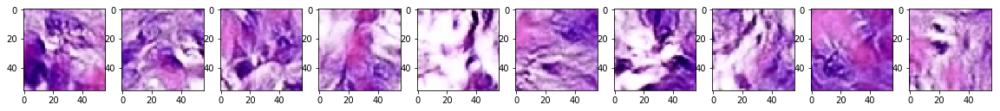

Epochs 2/5: Generator Loss: 2.1208. Discriminator Loss: -0.1316
Epochs 2/5: Generator Loss: -1.6634. Discriminator Loss: -0.1893
Epochs 2/5: Generator Loss: -1.0712. Discriminator Loss: -0.0917
Epochs 2/5: Generator Loss: 0.6095. Discriminator Loss: -0.1777
Epochs 2/5: Generator Loss: 6.0594. Discriminator Loss: -0.0527
Epochs 2/5: Generator Loss: -11.0015. Discriminator Loss: -0.2062
Epochs 2/5: Generator Loss: -0.8242. Discriminator Loss: -0.119
Epochs 2/5: Generator Loss: 0.6649. Discriminator Loss: -0.1592
Epochs 2/5: Generator Loss: 5.4254. Discriminator Loss: -0.1107
Epochs 2/5: Generator Loss: 1.4068. Discriminator Loss: -0.0543


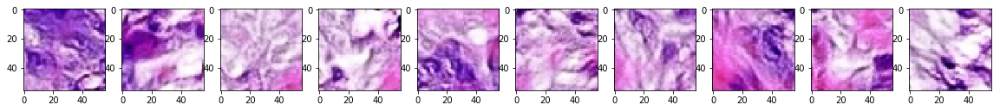

Epochs 2/5: Generator Loss: -10.5816. Discriminator Loss: -0.3388
Epochs 2/5: Generator Loss: -6.508. Discriminator Loss: -0.1234
Epochs 2/5: Generator Loss: 7.6025. Discriminator Loss: -0.2446
Epochs 2/5: Generator Loss: 1.1826. Discriminator Loss: -0.13
Epochs 2/5: Generator Loss: -1.8516. Discriminator Loss: -0.0768
Epochs 2/5: Generator Loss: 3.1825. Discriminator Loss: -0.0599
Epochs 2/5: Generator Loss: 0.6472. Discriminator Loss: -0.0914
Epochs 2/5: Generator Loss: 4.8329. Discriminator Loss: -0.1279
Epochs 2/5: Generator Loss: 3.359. Discriminator Loss: -0.1199
Epochs 2/5: Generator Loss: -0.7931. Discriminator Loss: -0.1043


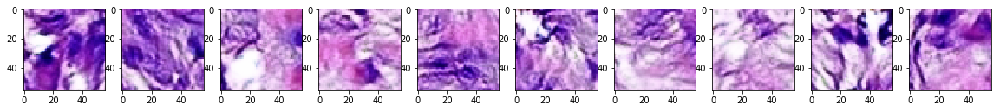

Epochs 2/5: Generator Loss: -4.7197. Discriminator Loss: -0.1476
Epochs 2/5: Generator Loss: 2.4368. Discriminator Loss: -0.1464
Epochs 2/5: Generator Loss: 10.4417. Discriminator Loss: -0.15
Epochs 2/5: Generator Loss: -1.9194. Discriminator Loss: -0.1813
Epochs 2/5: Generator Loss: 1.9108. Discriminator Loss: -0.2002
Epochs 2/5: Generator Loss: -2.2749. Discriminator Loss: -0.0472
Epochs 2/5: Generator Loss: 3.2178. Discriminator Loss: -0.0887
Epochs 2/5: Generator Loss: 3.3974. Discriminator Loss: -0.1024
Epochs 2/5: Generator Loss: -0.981. Discriminator Loss: -0.1081
Epochs 2/5: Generator Loss: 4.633. Discriminator Loss: -0.1249


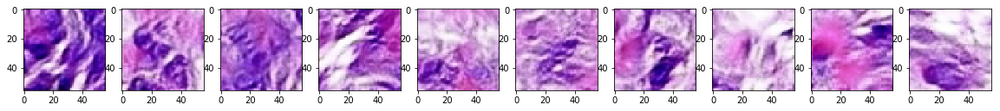

Epochs 2/5: Generator Loss: -6.2689. Discriminator Loss: -0.1006
Epochs 2/5: Generator Loss: -4.705. Discriminator Loss: -0.0329
Epochs 2/5: Generator Loss: 5.2084. Discriminator Loss: 0.0014
Epochs 2/5: Generator Loss: 0.6044. Discriminator Loss: -0.1392
Epochs 2/5: Generator Loss: 0.2218. Discriminator Loss: -0.1034
Epochs 2/5: Generator Loss: -7.4836. Discriminator Loss: -0.1268
Epochs 2/5: Generator Loss: 9.0362. Discriminator Loss: -0.1817
Epochs 2/5: Generator Loss: -4.7833. Discriminator Loss: -0.1601
Epochs 2/5: Generator Loss: -3.411. Discriminator Loss: -0.1368
Epochs 2/5: Generator Loss: 8.9106. Discriminator Loss: -0.1479


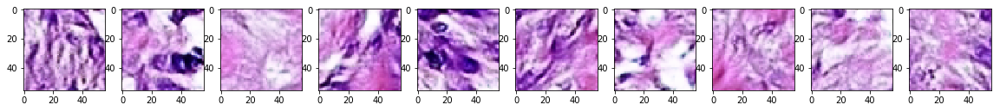

Epochs 2/5: Generator Loss: -0.2649. Discriminator Loss: -0.0709
Epochs 2/5: Generator Loss: 3.5563. Discriminator Loss: -0.102
Epochs 2/5: Generator Loss: 1.5029. Discriminator Loss: -0.2284
Epochs 2/5: Generator Loss: -6.175. Discriminator Loss: -0.236
Epochs 2/5: Generator Loss: -1.0844. Discriminator Loss: -0.1509
Epochs 2/5: Generator Loss: 0.3934. Discriminator Loss: -0.1105
Epochs 2/5: Generator Loss: 0.65. Discriminator Loss: -0.1139
Epochs 2/5: Generator Loss: 3.1606. Discriminator Loss: -0.1262
Epochs 2/5: Generator Loss: 3.0765. Discriminator Loss: 0.1422
Epochs 2/5: Generator Loss: -11.1602. Discriminator Loss: -0.1104


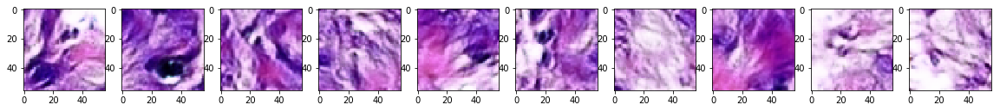

Epochs 2/5: Generator Loss: 5.0793. Discriminator Loss: -0.177
Epochs 2/5: Generator Loss: 0.0616. Discriminator Loss: -0.1829
Epochs 2/5: Generator Loss: -5.4845. Discriminator Loss: 0.0035
Epochs 2/5: Generator Loss: -3.9764. Discriminator Loss: -0.0548
Epochs 2/5: Generator Loss: 9.3806. Discriminator Loss: -0.2203
Epochs 2/5: Generator Loss: 3.8475. Discriminator Loss: 0.091
Epochs 2/5: Generator Loss: -6.4517. Discriminator Loss: -0.1464
Epochs 2/5: Generator Loss: -0.8729. Discriminator Loss: -0.1543
Epochs 2/5: Generator Loss: -0.188. Discriminator Loss: -0.1598
Epochs 2/5: Generator Loss: 5.7676. Discriminator Loss: -0.2704


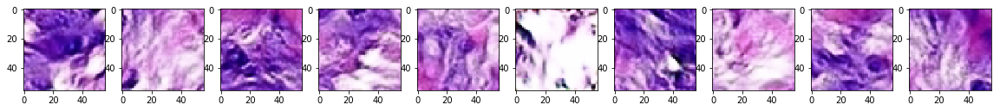

Epochs 2/5: Generator Loss: -5.4773. Discriminator Loss: -0.124
Epochs 2/5: Generator Loss: 1.1193. Discriminator Loss: -0.1749
Epochs 2/5: Generator Loss: -4.2996. Discriminator Loss: -0.0524
Epochs 2/5: Generator Loss: -0.4064. Discriminator Loss: -0.15
Epochs 2/5: Generator Loss: -2.2716. Discriminator Loss: -0.1427
Epochs 2/5: Generator Loss: 4.7188. Discriminator Loss: -0.2312
Epochs 2/5: Generator Loss: 6.7652. Discriminator Loss: -0.1304
Epochs 2/5: Generator Loss: -6.4199. Discriminator Loss: -0.1826
Epochs 2/5: Generator Loss: 2.1661. Discriminator Loss: -0.1347
Epochs 2/5: Generator Loss: -3.4322. Discriminator Loss: 0.0137


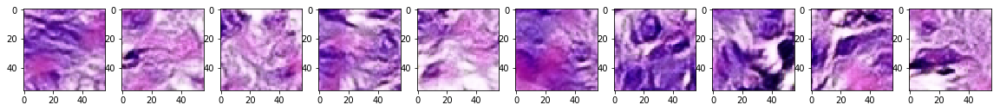

Epochs 2/5: Generator Loss: 1.7532. Discriminator Loss: -0.077
Epochs 2/5: Generator Loss: -5.3392. Discriminator Loss: -0.0195
Epochs 2/5: Generator Loss: 7.2168. Discriminator Loss: -0.1325
Epochs 2/5: Generator Loss: -6.047. Discriminator Loss: -0.0427
Epochs 2/5: Generator Loss: 2.8514. Discriminator Loss: -0.1819
Epochs 2/5: Generator Loss: -3.1427. Discriminator Loss: 0.0708
Epochs 2/5: Generator Loss: 3.4934. Discriminator Loss: -0.148
Epochs 2/5: Generator Loss: -0.3165. Discriminator Loss: -0.0365
Epochs 2/5: Generator Loss: -1.38. Discriminator Loss: -0.1345
Epochs 2/5: Generator Loss: 0.6192. Discriminator Loss: -0.0933


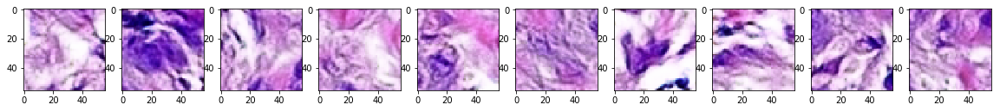

Epochs 2/5: Generator Loss: -4.8029. Discriminator Loss: -0.0902
Epochs 2/5: Generator Loss: 5.2834. Discriminator Loss: -0.2098
Epochs 2/5: Generator Loss: -7.0456. Discriminator Loss: -0.1413
Epochs 2/5: Generator Loss: 2.7157. Discriminator Loss: -0.1057
Epochs 2/5: Generator Loss: 5.2411. Discriminator Loss: -0.1047
Epochs 2/5: Generator Loss: 5.7933. Discriminator Loss: -0.1521
Epochs 2/5: Generator Loss: -6.2099. Discriminator Loss: -0.0795
Epochs 2/5: Generator Loss: 1.4377. Discriminator Loss: -0.1842
Epochs 2/5: Generator Loss: 5.7022. Discriminator Loss: -0.089
Epochs 2/5: Generator Loss: 3.4173. Discriminator Loss: -0.1221


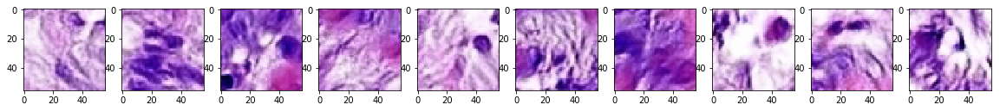

Epochs 2/5: Generator Loss: -2.7773. Discriminator Loss: -0.1544
Epochs 2/5: Generator Loss: -4.8301. Discriminator Loss: -0.4557
Epochs 2/5: Generator Loss: 8.7216. Discriminator Loss: -0.0499
Epochs 2/5: Generator Loss: -0.1844. Discriminator Loss: -0.1301
Epochs 2/5: Generator Loss: -0.5399. Discriminator Loss: -0.1815
Epochs 2/5: Generator Loss: 2.3372. Discriminator Loss: -0.1025
Epochs 2/5: Generator Loss: 3.0133. Discriminator Loss: -0.1496
Epochs 2/5: Generator Loss: -3.9175. Discriminator Loss: -0.1307
Epochs 2/5: Generator Loss: -3.8267. Discriminator Loss: -0.1405
Epochs 2/5: Generator Loss: 7.45. Discriminator Loss: -0.2746


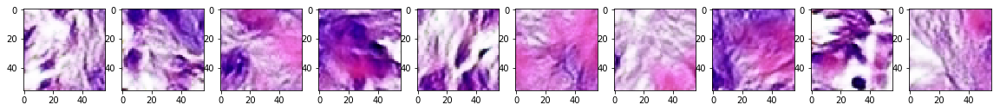

Epochs 2/5: Generator Loss: 0.1782. Discriminator Loss: -0.1489
Epochs 2/5: Generator Loss: -2.3921. Discriminator Loss: -0.0904
Epochs 2/5: Generator Loss: -1.1416. Discriminator Loss: -0.1822
Epochs 2/5: Generator Loss: -3.0344. Discriminator Loss: -0.1632
Epochs 2/5: Generator Loss: 3.5395. Discriminator Loss: -0.102
Epochs 2/5: Generator Loss: 8.306. Discriminator Loss: -0.1974
Epochs 2/5: Generator Loss: -8.594. Discriminator Loss: -0.2557
Epochs 2/5: Generator Loss: 0.9627. Discriminator Loss: -0.1108
Epochs 2/5: Generator Loss: -4.3117. Discriminator Loss: -0.0642
Epochs 2/5: Generator Loss: 0.4092. Discriminator Loss: -0.1038


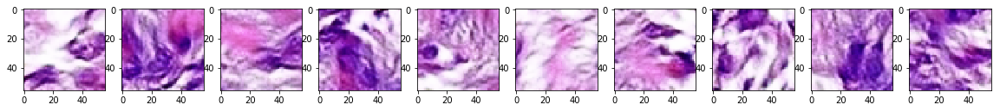

Epochs 2/5: Generator Loss: 7.7261. Discriminator Loss: -0.1959
Epochs 2/5: Generator Loss: 0.7412. Discriminator Loss: -0.1025
Epochs 2/5: Generator Loss: -9.114. Discriminator Loss: -0.1534
Epochs 2/5: Generator Loss: 4.4218. Discriminator Loss: -0.0927
Epochs 2/5: Generator Loss: 1.6437. Discriminator Loss: -0.1297
Epochs 2/5: Generator Loss: -0.0973. Discriminator Loss: -0.0506
Epochs 2/5: Generator Loss: -6.6697. Discriminator Loss: -0.0482
Epochs 2/5: Generator Loss: -3.4608. Discriminator Loss: -0.1242
Epochs 2/5: Generator Loss: 1.4918. Discriminator Loss: -0.1225
Epochs 2/5: Generator Loss: -2.5878. Discriminator Loss: -0.1593


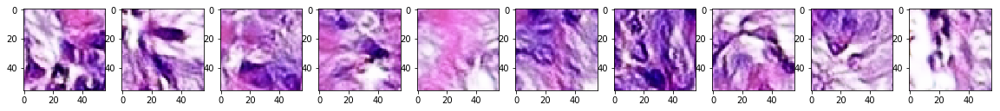

Epochs 2/5: Generator Loss: -5.1074. Discriminator Loss: -0.1339
Epochs 2/5: Generator Loss: 4.3718. Discriminator Loss: -0.1293
Epochs 2/5: Generator Loss: 9.1324. Discriminator Loss: -0.2459
Epochs 2/5: Generator Loss: -8.8354. Discriminator Loss: -0.1641
Epochs 2/5: Generator Loss: -0.9981. Discriminator Loss: -0.1278
Epochs 2/5: Generator Loss: 1.0608. Discriminator Loss: -0.2387
Epochs 2/5: Generator Loss: -1.0815. Discriminator Loss: -0.1324
Epochs 2/5: Generator Loss: 4.1588. Discriminator Loss: -0.086
Epochs 2/5: Generator Loss: 0.4701. Discriminator Loss: -0.0955
Epochs 2/5: Generator Loss: 1.4186. Discriminator Loss: -0.0777


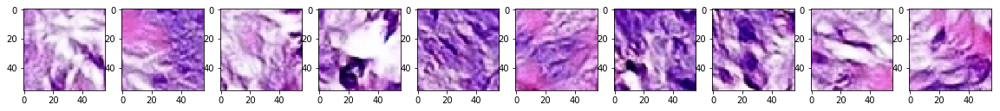

Epochs 2/5: Generator Loss: 2.3867. Discriminator Loss: -0.1895
Epochs 2/5: Generator Loss: -2.555. Discriminator Loss: -0.1484
Epochs 2/5: Generator Loss: -1.1331. Discriminator Loss: -0.1402
Epochs 2/5: Generator Loss: 3.8347. Discriminator Loss: -0.2217
Epochs 2/5: Generator Loss: 7.0922. Discriminator Loss: -0.0171
Epochs 2/5: Generator Loss: -5.4336. Discriminator Loss: -0.1304
Epochs 2/5: Generator Loss: -0.9312. Discriminator Loss: -0.049
Epochs 2/5: Generator Loss: 1.5281. Discriminator Loss: -0.0906
Epochs 2/5: Generator Loss: -5.2401. Discriminator Loss: -0.1042
Epochs 2/5: Generator Loss: 6.878. Discriminator Loss: -0.1311


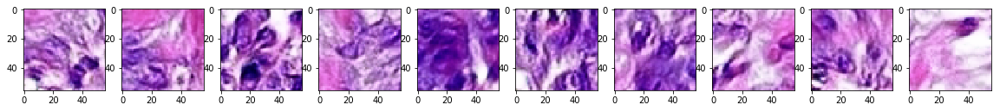

Epochs 2/5: Generator Loss: 1.4008. Discriminator Loss: -0.1433
Epochs 2/5: Generator Loss: -1.0791. Discriminator Loss: -0.0365
Epochs 2/5: Generator Loss: 0.3912. Discriminator Loss: -0.1512
Epochs 2/5: Generator Loss: 0.8204. Discriminator Loss: -0.2288
Epochs 2/5: Generator Loss: 7.9444. Discriminator Loss: -0.1327
Epochs 2/5: Generator Loss: -11.7263. Discriminator Loss: -0.0741
Epochs 2/5: Generator Loss: -1.9336. Discriminator Loss: -0.1044
Epochs 2/5: Generator Loss: -0.9532. Discriminator Loss: -0.1497
Epochs 2/5: Generator Loss: 4.693. Discriminator Loss: 0.0014
Epochs 2/5: Generator Loss: -3.1515. Discriminator Loss: 0.0019


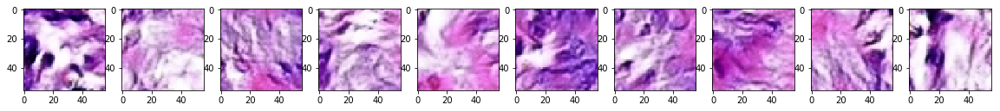

Epochs 2/5: Generator Loss: -0.3485. Discriminator Loss: -0.05
Epochs 2/5: Generator Loss: -6.7914. Discriminator Loss: -0.1646
Epochs 2/5: Generator Loss: 10.3905. Discriminator Loss: -0.1362
Epochs 2/5: Generator Loss: 3.3895. Discriminator Loss: -0.1616
Epochs 2/5: Generator Loss: -2.5816. Discriminator Loss: -0.1034
Epochs 2/5: Generator Loss: 4.9276. Discriminator Loss: -0.1275
Epochs 2/5: Generator Loss: -5.1777. Discriminator Loss: -0.1282
Epochs 2/5: Generator Loss: 1.6153. Discriminator Loss: -0.055
Epochs 2/5: Generator Loss: -1.8966. Discriminator Loss: -0.0916
Epochs 2/5: Generator Loss: -5.2699. Discriminator Loss: -0.0833


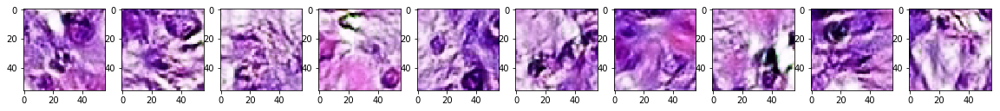

Epochs 2/5: Generator Loss: 4.6065. Discriminator Loss: -0.1392
Epochs 2/5: Generator Loss: 0.884. Discriminator Loss: -0.069
Epochs 2/5: Generator Loss: -3.5323. Discriminator Loss: -0.1779
Epochs 2/5: Generator Loss: -2.3368. Discriminator Loss: -0.1893
Epochs 2/5: Generator Loss: 14.6689. Discriminator Loss: -0.1478
Epochs 2/5: Generator Loss: -7.1661. Discriminator Loss: -0.1578
Epochs 2/5: Generator Loss: -0.9938. Discriminator Loss: -0.0808
Epochs 2/5: Generator Loss: 8.9959. Discriminator Loss: -0.1514
Epochs 2/5: Generator Loss: -1.3195. Discriminator Loss: -0.1746
Epochs 2/5: Generator Loss: -5.3525. Discriminator Loss: -0.0874


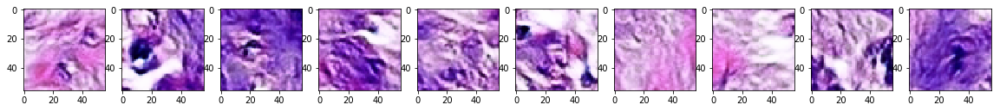

Epochs 2/5: Generator Loss: -1.864. Discriminator Loss: -0.2182
Epochs 2/5: Generator Loss: 6.4355. Discriminator Loss: -0.3118
Epochs 2/5: Generator Loss: -8.01. Discriminator Loss: -0.1546
Epochs 2/5: Generator Loss: -2.5353. Discriminator Loss: -0.0901
Epochs 2/5: Generator Loss: 5.0671. Discriminator Loss: 0.0265
Epochs 2/5: Generator Loss: -1.7279. Discriminator Loss: -0.0977
Epochs 2/5: Generator Loss: -7.5058. Discriminator Loss: -0.1191
Epochs 2/5: Generator Loss: 9.8964. Discriminator Loss: -0.1062
Epochs 2/5: Generator Loss: 6.636. Discriminator Loss: -0.2138
Epochs 2/5: Generator Loss: 2.6657. Discriminator Loss: -0.2806


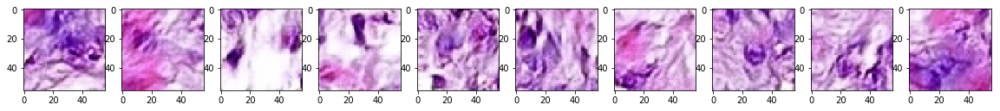

Epochs 2/5: Generator Loss: -4.2775. Discriminator Loss: 0.0402
Epochs 2/5: Generator Loss: -13.7944. Discriminator Loss: -0.1031
Epochs 2/5: Generator Loss: 1.2808. Discriminator Loss: -0.2129
Epochs 2/5: Generator Loss: 11.5743. Discriminator Loss: -0.5311
Epochs 2/5: Generator Loss: 2.1756. Discriminator Loss: -0.1105
Epochs 2/5: Generator Loss: -2.9246. Discriminator Loss: -0.1109
Epochs 2/5: Generator Loss: -1.7631. Discriminator Loss: -0.1195
Epochs 2/5: Generator Loss: -0.7814. Discriminator Loss: -0.0838
Epochs 2/5: Generator Loss: 6.9926. Discriminator Loss: -0.1364
Epochs 2/5: Generator Loss: -2.538. Discriminator Loss: -0.1303


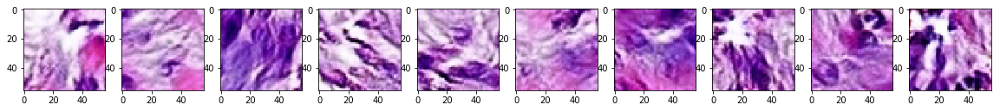

Epochs 2/5: Generator Loss: -6.8798. Discriminator Loss: -0.064
Epochs 2/5: Generator Loss: 1.3292. Discriminator Loss: -0.0602
Epochs 2/5: Generator Loss: 7.2446. Discriminator Loss: -0.1435
Epochs 2/5: Generator Loss: -6.5339. Discriminator Loss: -0.1506
Epochs 2/5: Generator Loss: -0.5623. Discriminator Loss: -0.0413
Epochs 2/5: Generator Loss: -7.4383. Discriminator Loss: -0.0677
Epochs 2/5: Generator Loss: -1.6362. Discriminator Loss: -0.1023
Epochs 2/5: Generator Loss: 8.0605. Discriminator Loss: -0.2072
Epochs 2/5: Generator Loss: 1.1225. Discriminator Loss: -0.0459
Epochs 2/5: Generator Loss: -13.1373. Discriminator Loss: -0.0634


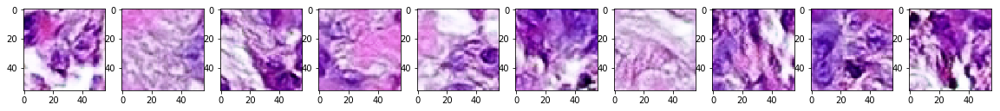

Epochs 2/5: Generator Loss: -2.7075. Discriminator Loss: -0.1243
Epochs 2/5: Generator Loss: 4.7365. Discriminator Loss: -0.1199
Epochs 2/5: Generator Loss: -3.26. Discriminator Loss: -0.112
Epochs 2/5: Generator Loss: -1.9466. Discriminator Loss: -0.0372
Epochs 2/5: Generator Loss: 8.6338. Discriminator Loss: -0.0266
Epochs 2/5: Generator Loss: -5.5511. Discriminator Loss: -0.2126
Epochs 2/5: Generator Loss: -8.8241. Discriminator Loss: -0.1477
Epochs 2/5: Generator Loss: 13.0632. Discriminator Loss: -0.1342
Epochs 2/5: Generator Loss: 6.0892. Discriminator Loss: -0.1019
Epochs 2/5: Generator Loss: -6.1722. Discriminator Loss: -0.1399


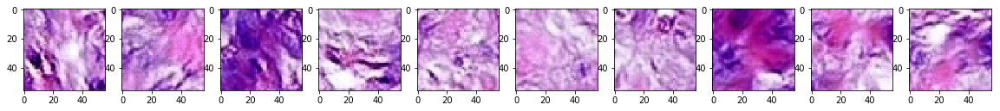

Epochs 2/5: Generator Loss: -2.8477. Discriminator Loss: -0.1841
Epochs 2/5: Generator Loss: 4.08. Discriminator Loss: -0.0969
Epochs 2/5: Generator Loss: -1.1893. Discriminator Loss: -0.1522
Epochs 2/5: Generator Loss: 3.5567. Discriminator Loss: -0.1011
Epochs 2/5: Generator Loss: 2.5296. Discriminator Loss: -0.1474
Epochs 2/5: Generator Loss: -5.1682. Discriminator Loss: -0.1628
Epochs 2/5: Generator Loss: -8.2719. Discriminator Loss: -0.1137
Epochs 2/5: Generator Loss: 11.0361. Discriminator Loss: -0.1435
Epochs 2/5: Generator Loss: -2.9788. Discriminator Loss: -0.2236
Epochs 2/5: Generator Loss: 6.1666. Discriminator Loss: -0.2113


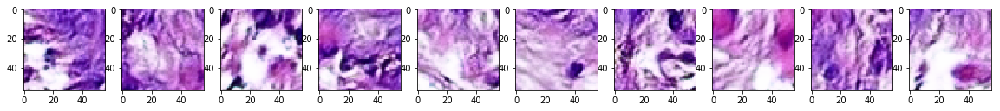

Epochs 2/5: Generator Loss: -0.3106. Discriminator Loss: -0.1076
Epochs 2/5: Generator Loss: -4.1079. Discriminator Loss: -0.0599
Epochs 2/5: Generator Loss: 6.2063. Discriminator Loss: -0.1093
Epochs 2/5: Generator Loss: -9.3336. Discriminator Loss: -0.3271
Epochs 2/5: Generator Loss: 6.3909. Discriminator Loss: -0.1259
Epochs 2/5: Generator Loss: -2.6531. Discriminator Loss: -0.2205
Epochs 2/5: Generator Loss: 1.8101. Discriminator Loss: -0.0931
Epochs 2/5: Generator Loss: -11.4893. Discriminator Loss: -0.1777
Epochs 2/5: Generator Loss: 5.4057. Discriminator Loss: -0.0705
Epochs 2/5: Generator Loss: -0.5892. Discriminator Loss: -0.1506


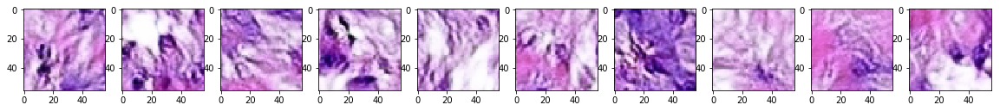

Epochs 2/5: Generator Loss: -2.06. Discriminator Loss: -0.152
Epochs 2/5: Generator Loss: 4.5874. Discriminator Loss: -0.1223
Epochs 2/5: Generator Loss: 9.5265. Discriminator Loss: 0.0224
Epochs 2/5: Generator Loss: -5.6622. Discriminator Loss: -0.1099
Epochs 2/5: Generator Loss: -0.5345. Discriminator Loss: -0.1645
Epochs 2/5: Generator Loss: 7.4796. Discriminator Loss: -0.1295
Epochs 2/5: Generator Loss: 0.9262. Discriminator Loss: -0.1511
Epochs 2/5: Generator Loss: -2.261. Discriminator Loss: -0.1286
Epochs 2/5: Generator Loss: 3.279. Discriminator Loss: -0.1957
Epochs 2/5: Generator Loss: -3.8826. Discriminator Loss: -0.1549


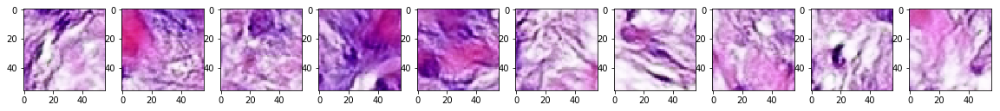

Epochs 2/5: Generator Loss: 3.9365. Discriminator Loss: -0.1314
Epochs 2/5: Generator Loss: 6.1981. Discriminator Loss: -0.0222
Epochs 2/5: Generator Loss: -5.8499. Discriminator Loss: -0.1177
Epochs 2/5: Generator Loss: -4.2216. Discriminator Loss: -0.1742
Epochs 2/5: Generator Loss: 7.7508. Discriminator Loss: -0.1849
Epochs 2/5: Generator Loss: 5.7409. Discriminator Loss: -0.1572
Epochs 2/5: Generator Loss: -6.1749. Discriminator Loss: -0.0439
Epochs 2/5: Generator Loss: 1.3917. Discriminator Loss: -0.3469
Epochs 2/5: Generator Loss: -2.5624. Discriminator Loss: -0.1921
Epochs 2/5: Generator Loss: 0.7396. Discriminator Loss: -0.0941


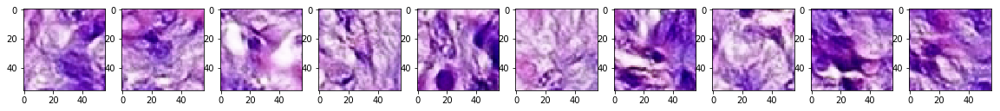

Epochs 2/5: Generator Loss: 3.5776. Discriminator Loss: 0.1111
Epochs 2/5: Generator Loss: -11.8255. Discriminator Loss: -0.0522
Epochs 2/5: Generator Loss: 7.4008. Discriminator Loss: -0.1499
Epochs 2/5: Generator Loss: -3.3811. Discriminator Loss: -0.0613
Epochs 2/5: Generator Loss: 8.9059. Discriminator Loss: -0.2363
Epochs 2/5: Generator Loss: 0.5503. Discriminator Loss: -0.0665
Epochs 2/5: Generator Loss: 2.4234. Discriminator Loss: 0.0823
Epochs 2/5: Generator Loss: -23.8355. Discriminator Loss: -0.2965
Epochs 2/5: Generator Loss: -5.4841. Discriminator Loss: -0.1479
Epochs 2/5: Generator Loss: 14.6256. Discriminator Loss: -0.2209


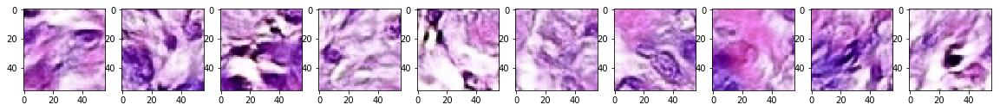

Epochs 2/5: Generator Loss: 1.4542. Discriminator Loss: -0.0783
Epochs 2/5: Generator Loss: 1.6184. Discriminator Loss: -0.1273
Epochs 2/5: Generator Loss: -2.6692. Discriminator Loss: 0.0069
Epochs 2/5: Generator Loss: -8.0353. Discriminator Loss: -0.1652
Epochs 2/5: Generator Loss: 6.3629. Discriminator Loss: -0.1094
Epochs 2/5: Generator Loss: -4.4566. Discriminator Loss: -0.1976
Epochs 2/5: Generator Loss: 5.5938. Discriminator Loss: -0.2512
Epochs 2/5: Generator Loss: 1.0541. Discriminator Loss: -0.1244
Epochs 2/5: Generator Loss: -5.5728. Discriminator Loss: -0.1915
Epochs 2/5: Generator Loss: 9.3006. Discriminator Loss: -0.1074


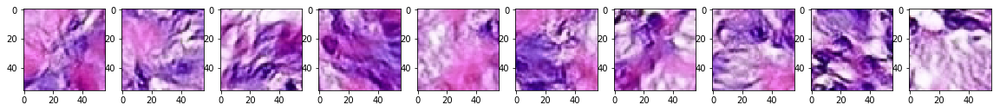

Epochs 2/5: Generator Loss: 2.9506. Discriminator Loss: -0.2129
Epochs 2/5: Generator Loss: -5.2717. Discriminator Loss: -0.151
Epochs 2/5: Generator Loss: 0.6611. Discriminator Loss: -0.1514
Epochs 2/5: Generator Loss: 3.0028. Discriminator Loss: -0.0896
Epochs 2/5: Generator Loss: 3.5212. Discriminator Loss: 0.0189
Epochs 2/5: Generator Loss: -0.8767. Discriminator Loss: -0.1028
Epochs 2/5: Generator Loss: -2.7837. Discriminator Loss: -0.1464
Epochs 2/5: Generator Loss: -2.7535. Discriminator Loss: -0.0973
Epochs 2/5: Generator Loss: 1.4876. Discriminator Loss: -0.1234
Epochs 2/5: Generator Loss: 7.9039. Discriminator Loss: -0.1202


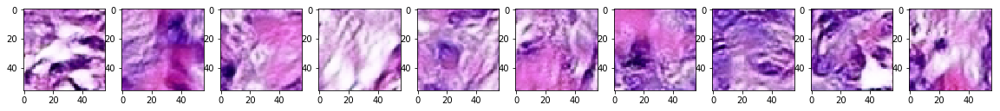

Epochs 2/5: Generator Loss: -2.882. Discriminator Loss: -0.209
Epochs 2/5: Generator Loss: 6.1272. Discriminator Loss: -0.0965
Epochs 2/5: Generator Loss: -19.3015. Discriminator Loss: -0.1876
Epochs 2/5: Generator Loss: 1.0708. Discriminator Loss: -0.1523
Epochs 3/5: Generator Loss: 11.1986. Discriminator Loss: -0.2314
Epochs 3/5: Generator Loss: -3.1135. Discriminator Loss: -0.0918
Epochs 3/5: Generator Loss: -2.2949. Discriminator Loss: -0.3036
Epochs 3/5: Generator Loss: -10.2943. Discriminator Loss: -0.0931
Epochs 3/5: Generator Loss: 25.4068. Discriminator Loss: -0.194
Epochs 3/5: Generator Loss: -0.0044. Discriminator Loss: -0.1357


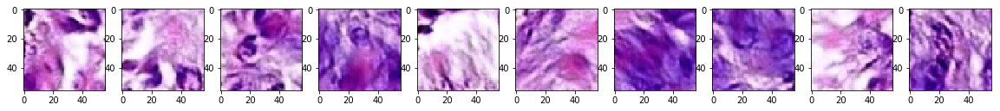

Epochs 3/5: Generator Loss: -9.4357. Discriminator Loss: -0.2867
Epochs 3/5: Generator Loss: -3.5378. Discriminator Loss: -0.2476
Epochs 3/5: Generator Loss: 3.9683. Discriminator Loss: -0.1647
Epochs 3/5: Generator Loss: 10.3951. Discriminator Loss: -0.1458
Epochs 3/5: Generator Loss: -5.9502. Discriminator Loss: -0.1025
Epochs 3/5: Generator Loss: -2.6784. Discriminator Loss: -0.1192
Epochs 3/5: Generator Loss: 5.4236. Discriminator Loss: -0.1666
Epochs 3/5: Generator Loss: 3.3441. Discriminator Loss: -0.1622
Epochs 3/5: Generator Loss: -2.7995. Discriminator Loss: -0.0773
Epochs 3/5: Generator Loss: 1.7522. Discriminator Loss: -0.1509


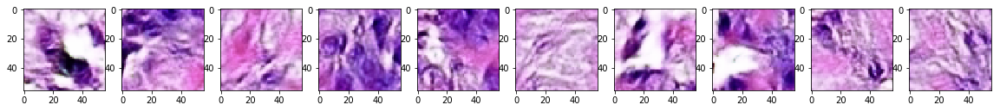

Epochs 3/5: Generator Loss: -3.7793. Discriminator Loss: -0.194
Epochs 3/5: Generator Loss: 12.1014. Discriminator Loss: -0.1983
Epochs 3/5: Generator Loss: 1.1206. Discriminator Loss: -0.1039
Epochs 3/5: Generator Loss: -4.7527. Discriminator Loss: -0.0969
Epochs 3/5: Generator Loss: -0.0162. Discriminator Loss: -0.2227
Epochs 3/5: Generator Loss: 5.5071. Discriminator Loss: -0.0999
Epochs 3/5: Generator Loss: 1.7414. Discriminator Loss: -0.1483
Epochs 3/5: Generator Loss: -3.2972. Discriminator Loss: -0.1399
Epochs 3/5: Generator Loss: -6.3077. Discriminator Loss: -0.1701
Epochs 3/5: Generator Loss: 5.0046. Discriminator Loss: -0.1258


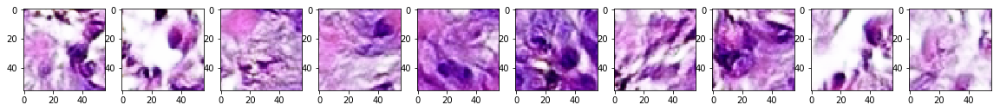

Epochs 3/5: Generator Loss: 10.8482. Discriminator Loss: -0.1469
Epochs 3/5: Generator Loss: 1.2786. Discriminator Loss: -0.0726
Epochs 3/5: Generator Loss: -9.2779. Discriminator Loss: -0.031
Epochs 3/5: Generator Loss: 13.5956. Discriminator Loss: -0.2119
Epochs 3/5: Generator Loss: 9.348. Discriminator Loss: -0.039
Epochs 3/5: Generator Loss: -3.4203. Discriminator Loss: -0.2226
Epochs 3/5: Generator Loss: -3.3628. Discriminator Loss: -0.072
Epochs 3/5: Generator Loss: 5.066. Discriminator Loss: -0.2023
Epochs 3/5: Generator Loss: 0.9611. Discriminator Loss: -0.3145
Epochs 3/5: Generator Loss: -5.5636. Discriminator Loss: -0.1637


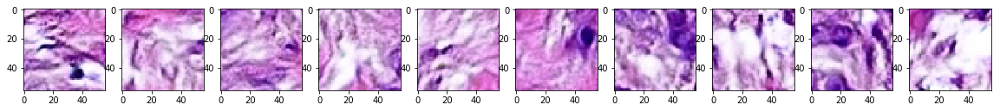

Epochs 3/5: Generator Loss: -6.9998. Discriminator Loss: -0.1458
Epochs 3/5: Generator Loss: 7.4653. Discriminator Loss: -0.2095
Epochs 3/5: Generator Loss: 3.6279. Discriminator Loss: -0.1527
Epochs 3/5: Generator Loss: -12.7921. Discriminator Loss: -0.1706
Epochs 3/5: Generator Loss: 12.6162. Discriminator Loss: -0.176
Epochs 3/5: Generator Loss: -0.3931. Discriminator Loss: -0.1236
Epochs 3/5: Generator Loss: -11.1973. Discriminator Loss: -0.0696
Epochs 3/5: Generator Loss: -5.9609. Discriminator Loss: -0.1711
Epochs 3/5: Generator Loss: 3.5508. Discriminator Loss: -0.1617
Epochs 3/5: Generator Loss: 3.3297. Discriminator Loss: -0.0737


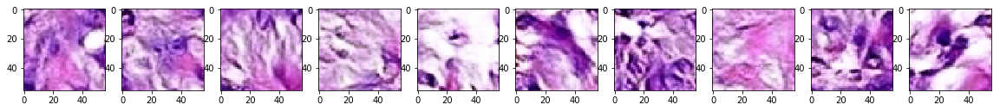

Epochs 3/5: Generator Loss: -0.6223. Discriminator Loss: -0.1529
Epochs 3/5: Generator Loss: -2.5188. Discriminator Loss: -0.0866
Epochs 3/5: Generator Loss: -3.3666. Discriminator Loss: -0.2148
Epochs 3/5: Generator Loss: 2.6531. Discriminator Loss: -0.1909
Epochs 3/5: Generator Loss: -0.8161. Discriminator Loss: -0.1243
Epochs 3/5: Generator Loss: -10.9896. Discriminator Loss: -0.1356
Epochs 3/5: Generator Loss: 5.8032. Discriminator Loss: -0.1368
Epochs 3/5: Generator Loss: -0.5517. Discriminator Loss: -0.0254
Epochs 3/5: Generator Loss: -5.7534. Discriminator Loss: -0.1231
Epochs 3/5: Generator Loss: 4.3846. Discriminator Loss: -0.0878


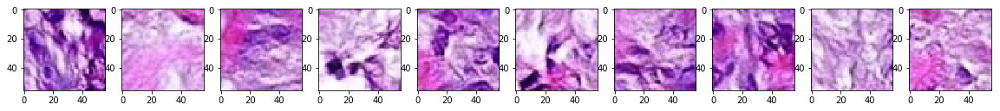

Epochs 3/5: Generator Loss: -4.2293. Discriminator Loss: -0.0758
Epochs 3/5: Generator Loss: 0.9765. Discriminator Loss: -0.1189
Epochs 3/5: Generator Loss: 4.6774. Discriminator Loss: -0.0848
Epochs 3/5: Generator Loss: -3.027. Discriminator Loss: -0.0587
Epochs 3/5: Generator Loss: -3.23. Discriminator Loss: -0.2634
Epochs 3/5: Generator Loss: 1.2541. Discriminator Loss: -0.0767
Epochs 3/5: Generator Loss: -0.6665. Discriminator Loss: -0.1193
Epochs 3/5: Generator Loss: 0.2935. Discriminator Loss: -0.126
Epochs 3/5: Generator Loss: -0.0151. Discriminator Loss: -0.1749
Epochs 3/5: Generator Loss: -5.277. Discriminator Loss: -0.2528


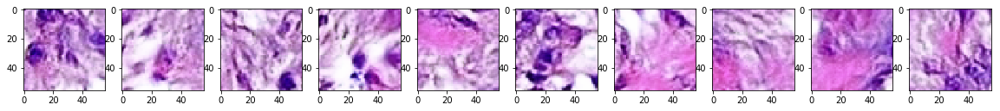

Epochs 3/5: Generator Loss: 4.8149. Discriminator Loss: -0.1474
Epochs 3/5: Generator Loss: -11.5038. Discriminator Loss: -0.1557
Epochs 3/5: Generator Loss: -3.4483. Discriminator Loss: -0.1127
Epochs 3/5: Generator Loss: 6.8422. Discriminator Loss: -0.0591
Epochs 3/5: Generator Loss: -3.1539. Discriminator Loss: -0.0653
Epochs 3/5: Generator Loss: -2.0875. Discriminator Loss: -0.2139
Epochs 3/5: Generator Loss: -0.5919. Discriminator Loss: -0.2018
Epochs 3/5: Generator Loss: 8.2212. Discriminator Loss: -0.1669
Epochs 3/5: Generator Loss: -4.3796. Discriminator Loss: -0.101
Epochs 3/5: Generator Loss: -7.2219. Discriminator Loss: -0.0971


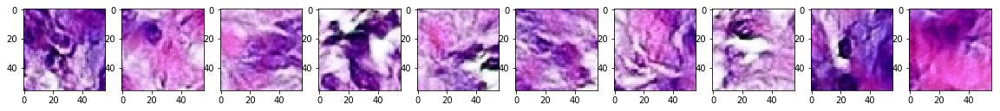

Epochs 3/5: Generator Loss: 8.5365. Discriminator Loss: -0.1785
Epochs 3/5: Generator Loss: -12.0511. Discriminator Loss: -0.148
Epochs 3/5: Generator Loss: 8.53. Discriminator Loss: -0.0407
Epochs 3/5: Generator Loss: -2.0434. Discriminator Loss: -0.132
Epochs 3/5: Generator Loss: -5.7842. Discriminator Loss: -0.1361
Epochs 3/5: Generator Loss: 2.6289. Discriminator Loss: -0.1433
Epochs 3/5: Generator Loss: 1.6883. Discriminator Loss: -0.077
Epochs 3/5: Generator Loss: -8.2405. Discriminator Loss: -0.2046
Epochs 3/5: Generator Loss: -2.5997. Discriminator Loss: -0.2185
Epochs 3/5: Generator Loss: 1.4668. Discriminator Loss: -0.071


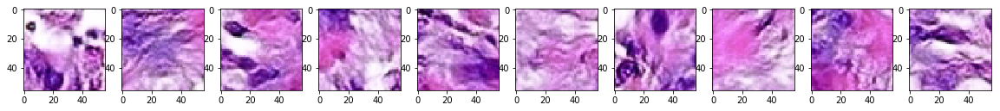

Epochs 3/5: Generator Loss: 12.6865. Discriminator Loss: -0.0829
Epochs 3/5: Generator Loss: -8.8668. Discriminator Loss: -0.0475
Epochs 3/5: Generator Loss: -6.0585. Discriminator Loss: -0.223
Epochs 3/5: Generator Loss: 8.7373. Discriminator Loss: -0.0728
Epochs 3/5: Generator Loss: 13.3468. Discriminator Loss: -0.1742
Epochs 3/5: Generator Loss: -17.1932. Discriminator Loss: -0.4233
Epochs 3/5: Generator Loss: 5.6917. Discriminator Loss: -0.0843
Epochs 3/5: Generator Loss: 11.2148. Discriminator Loss: -0.086
Epochs 3/5: Generator Loss: -1.9876. Discriminator Loss: -0.1041
Epochs 3/5: Generator Loss: 6.3535. Discriminator Loss: 0.0405


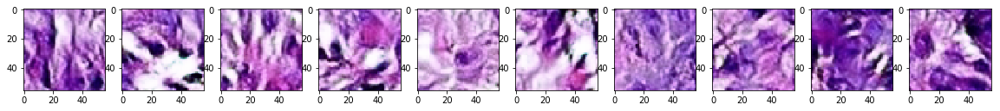

Epochs 3/5: Generator Loss: 4.4848. Discriminator Loss: -0.2271
Epochs 3/5: Generator Loss: 3.6445. Discriminator Loss: -0.2072
Epochs 3/5: Generator Loss: -6.6151. Discriminator Loss: -0.0674
Epochs 3/5: Generator Loss: -2.8516. Discriminator Loss: -0.1395
Epochs 3/5: Generator Loss: 11.0124. Discriminator Loss: -0.2043
Epochs 3/5: Generator Loss: 9.0964. Discriminator Loss: -0.1834
Epochs 3/5: Generator Loss: -8.6398. Discriminator Loss: -0.1039
Epochs 3/5: Generator Loss: -5.0768. Discriminator Loss: -0.1026
Epochs 3/5: Generator Loss: -14.8914. Discriminator Loss: -0.2401
Epochs 3/5: Generator Loss: 5.0672. Discriminator Loss: -0.0217


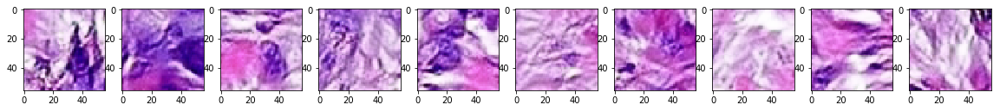

Epochs 3/5: Generator Loss: 6.1968. Discriminator Loss: -0.1098
Epochs 3/5: Generator Loss: 2.4979. Discriminator Loss: -0.0324
Epochs 3/5: Generator Loss: -8.6121. Discriminator Loss: -0.0691
Epochs 3/5: Generator Loss: 0.9831. Discriminator Loss: -0.144
Epochs 3/5: Generator Loss: 7.1336. Discriminator Loss: -0.1618
Epochs 3/5: Generator Loss: -4.165. Discriminator Loss: -0.1049
Epochs 3/5: Generator Loss: 3.4447. Discriminator Loss: -0.1338
Epochs 3/5: Generator Loss: -6.1601. Discriminator Loss: -0.0919
Epochs 3/5: Generator Loss: 4.3339. Discriminator Loss: -0.0704
Epochs 3/5: Generator Loss: 8.0418. Discriminator Loss: -0.1121


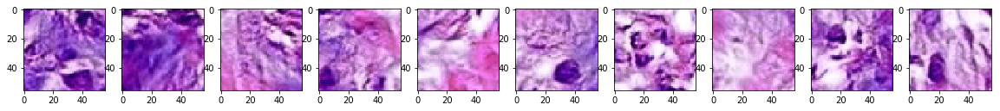

Epochs 3/5: Generator Loss: -6.9735. Discriminator Loss: -0.1714
Epochs 3/5: Generator Loss: -0.0838. Discriminator Loss: -0.0269
Epochs 3/5: Generator Loss: -0.6552. Discriminator Loss: -0.1264
Epochs 3/5: Generator Loss: -0.4756. Discriminator Loss: -0.1318
Epochs 3/5: Generator Loss: -4.7813. Discriminator Loss: -0.1847
Epochs 3/5: Generator Loss: -7.698. Discriminator Loss: -0.0416
Epochs 3/5: Generator Loss: 3.1105. Discriminator Loss: -0.1233
Epochs 3/5: Generator Loss: 11.2072. Discriminator Loss: -0.1034
Epochs 3/5: Generator Loss: 2.5848. Discriminator Loss: -0.1047
Epochs 3/5: Generator Loss: -5.9376. Discriminator Loss: -0.1097


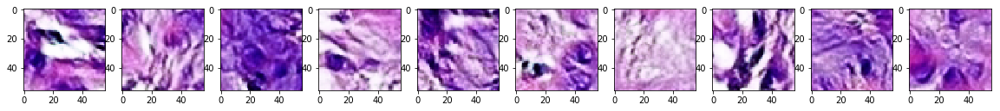

Epochs 3/5: Generator Loss: -3.8567. Discriminator Loss: -0.1296
Epochs 3/5: Generator Loss: 2.5661. Discriminator Loss: -0.0325
Epochs 3/5: Generator Loss: 11.4708. Discriminator Loss: -0.1724
Epochs 3/5: Generator Loss: 2.4788. Discriminator Loss: -0.1439
Epochs 3/5: Generator Loss: 1.7882. Discriminator Loss: -0.1437
Epochs 3/5: Generator Loss: 1.2652. Discriminator Loss: -0.1227
Epochs 3/5: Generator Loss: 2.4898. Discriminator Loss: -0.1757
Epochs 3/5: Generator Loss: -2.382. Discriminator Loss: -0.1037
Epochs 3/5: Generator Loss: -4.5029. Discriminator Loss: -0.1886
Epochs 3/5: Generator Loss: 9.0858. Discriminator Loss: -0.1766


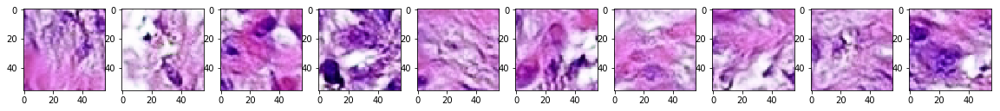

Epochs 3/5: Generator Loss: 1.9091. Discriminator Loss: -0.1399
Epochs 3/5: Generator Loss: -3.9854. Discriminator Loss: -0.2943
Epochs 3/5: Generator Loss: 1.8333. Discriminator Loss: -0.154
Epochs 3/5: Generator Loss: -2.1711. Discriminator Loss: -0.173
Epochs 3/5: Generator Loss: -0.9425. Discriminator Loss: -0.1768
Epochs 3/5: Generator Loss: 2.9008. Discriminator Loss: -0.2442
Epochs 3/5: Generator Loss: 0.4707. Discriminator Loss: -0.0135
Epochs 3/5: Generator Loss: -6.2212. Discriminator Loss: -0.0551
Epochs 3/5: Generator Loss: 12.9712. Discriminator Loss: -0.1845
Epochs 3/5: Generator Loss: -3.3126. Discriminator Loss: -0.1252


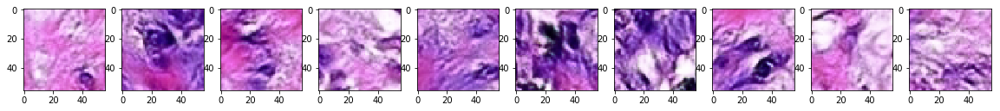

Epochs 3/5: Generator Loss: -6.7889. Discriminator Loss: -0.1619
Epochs 3/5: Generator Loss: 4.2639. Discriminator Loss: -0.1133
Epochs 3/5: Generator Loss: -0.7058. Discriminator Loss: -0.1323
Epochs 3/5: Generator Loss: -3.8477. Discriminator Loss: -0.0965
Epochs 3/5: Generator Loss: -1.3399. Discriminator Loss: -0.1221
Epochs 3/5: Generator Loss: -0.1721. Discriminator Loss: -0.0782
Epochs 3/5: Generator Loss: -2.4844. Discriminator Loss: -0.1821
Epochs 3/5: Generator Loss: -6.9546. Discriminator Loss: -0.0503
Epochs 3/5: Generator Loss: 3.9017. Discriminator Loss: -0.1621
Epochs 3/5: Generator Loss: 7.0549. Discriminator Loss: -0.1131


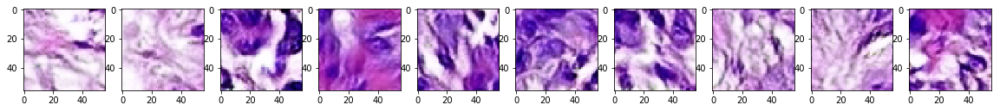

Epochs 3/5: Generator Loss: -1.542. Discriminator Loss: -0.128
Epochs 3/5: Generator Loss: -5.1504. Discriminator Loss: -0.1444
Epochs 3/5: Generator Loss: 9.8173. Discriminator Loss: -0.1899
Epochs 3/5: Generator Loss: -7.7701. Discriminator Loss: -0.1016
Epochs 3/5: Generator Loss: 8.9438. Discriminator Loss: -0.1062
Epochs 3/5: Generator Loss: 8.4073. Discriminator Loss: -0.1453
Epochs 3/5: Generator Loss: 0.5608. Discriminator Loss: -0.0841
Epochs 3/5: Generator Loss: -2.6223. Discriminator Loss: -0.1399
Epochs 3/5: Generator Loss: 3.0969. Discriminator Loss: -0.1295
Epochs 3/5: Generator Loss: 5.7043. Discriminator Loss: -0.2329


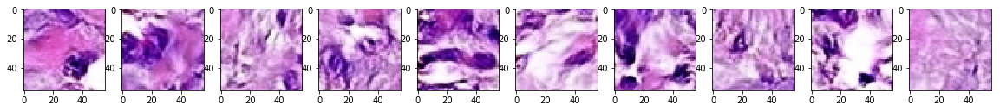

Epochs 3/5: Generator Loss: 4.3555. Discriminator Loss: -0.137
Epochs 3/5: Generator Loss: 9.4118. Discriminator Loss: -0.036
Epochs 3/5: Generator Loss: -4.0409. Discriminator Loss: -0.1134
Epochs 3/5: Generator Loss: -0.8099. Discriminator Loss: -0.0914
Epochs 3/5: Generator Loss: 1.0656. Discriminator Loss: -0.1173
Epochs 3/5: Generator Loss: 2.0537. Discriminator Loss: -0.0711
Epochs 3/5: Generator Loss: 2.2574. Discriminator Loss: -0.0887
Epochs 3/5: Generator Loss: -13.882. Discriminator Loss: -0.3976
Epochs 3/5: Generator Loss: 2.5605. Discriminator Loss: -0.114
Epochs 3/5: Generator Loss: 2.2405. Discriminator Loss: -0.1506


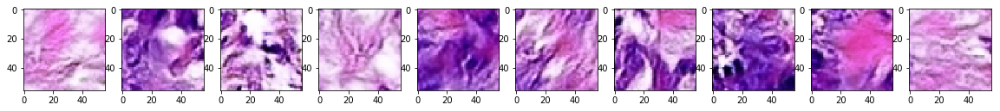

Epochs 3/5: Generator Loss: -6.7239. Discriminator Loss: -0.1609
Epochs 3/5: Generator Loss: 0.1909. Discriminator Loss: -0.0369
Epochs 3/5: Generator Loss: -5.381. Discriminator Loss: -0.2221
Epochs 3/5: Generator Loss: 15.3311. Discriminator Loss: -0.1694
Epochs 3/5: Generator Loss: -31.3193. Discriminator Loss: -0.5277
Epochs 3/5: Generator Loss: -2.1939. Discriminator Loss: -0.0356
Epochs 3/5: Generator Loss: 9.747. Discriminator Loss: -0.0667
Epochs 3/5: Generator Loss: 5.1518. Discriminator Loss: -0.0199
Epochs 3/5: Generator Loss: 12.9761. Discriminator Loss: -0.4613
Epochs 3/5: Generator Loss: -10.2149. Discriminator Loss: -0.1779


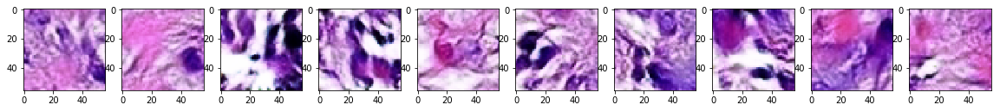

Epochs 3/5: Generator Loss: -8.3641. Discriminator Loss: -0.2545
Epochs 3/5: Generator Loss: 4.7085. Discriminator Loss: -0.029
Epochs 3/5: Generator Loss: -5.0271. Discriminator Loss: -0.1447
Epochs 3/5: Generator Loss: 26.4964. Discriminator Loss: -0.1323
Epochs 3/5: Generator Loss: -13.6768. Discriminator Loss: -0.2207
Epochs 3/5: Generator Loss: -13.24. Discriminator Loss: -0.0898
Epochs 3/5: Generator Loss: 7.8513. Discriminator Loss: 0.0591
Epochs 3/5: Generator Loss: -2.3464. Discriminator Loss: -0.1378
Epochs 3/5: Generator Loss: 16.9036. Discriminator Loss: -0.0883
Epochs 3/5: Generator Loss: -5.8785. Discriminator Loss: -0.1321


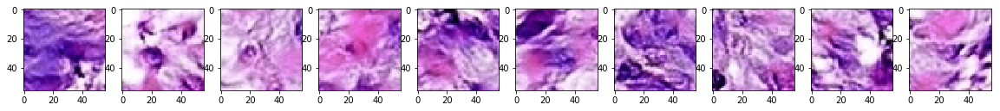

Epochs 3/5: Generator Loss: 2.6171. Discriminator Loss: -0.2559
Epochs 3/5: Generator Loss: 3.3366. Discriminator Loss: -0.0807
Epochs 3/5: Generator Loss: -10.0127. Discriminator Loss: -0.2662
Epochs 3/5: Generator Loss: 17.4073. Discriminator Loss: -0.2199
Epochs 3/5: Generator Loss: 1.8646. Discriminator Loss: -0.0501
Epochs 3/5: Generator Loss: -4.2443. Discriminator Loss: -0.1186
Epochs 3/5: Generator Loss: 3.9163. Discriminator Loss: -0.0997
Epochs 3/5: Generator Loss: 4.8831. Discriminator Loss: -0.1104
Epochs 3/5: Generator Loss: 6.6705. Discriminator Loss: -0.0765
Epochs 3/5: Generator Loss: -6.1642. Discriminator Loss: -0.1447


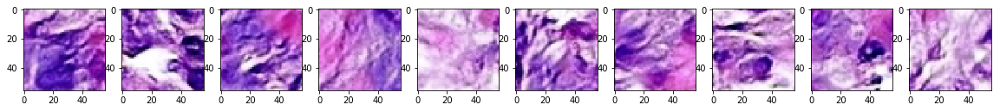

Epochs 3/5: Generator Loss: 0.7942. Discriminator Loss: -0.0795
Epochs 3/5: Generator Loss: 8.5688. Discriminator Loss: -0.1393
Epochs 3/5: Generator Loss: 5.3741. Discriminator Loss: -0.1721
Epochs 3/5: Generator Loss: 4.2058. Discriminator Loss: -0.0692
Epochs 3/5: Generator Loss: 3.3331. Discriminator Loss: -0.0636
Epochs 3/5: Generator Loss: -12.6171. Discriminator Loss: -0.1044
Epochs 3/5: Generator Loss: -0.3782. Discriminator Loss: -0.1006
Epochs 3/5: Generator Loss: 0.1623. Discriminator Loss: -0.1199
Epochs 3/5: Generator Loss: -7.7682. Discriminator Loss: -0.0655
Epochs 3/5: Generator Loss: 12.623. Discriminator Loss: -0.2569


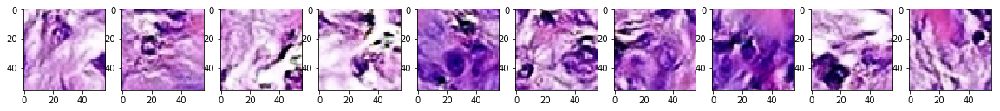

Epochs 3/5: Generator Loss: 3.0192. Discriminator Loss: -0.117
Epochs 3/5: Generator Loss: -4.8051. Discriminator Loss: -0.033
Epochs 3/5: Generator Loss: -4.383. Discriminator Loss: -0.1021
Epochs 3/5: Generator Loss: 11.1544. Discriminator Loss: -0.0523
Epochs 3/5: Generator Loss: 4.7038. Discriminator Loss: -0.1044
Epochs 3/5: Generator Loss: 2.0378. Discriminator Loss: -0.0409
Epochs 3/5: Generator Loss: -9.8803. Discriminator Loss: -0.0901
Epochs 3/5: Generator Loss: -1.0899. Discriminator Loss: -0.1126
Epochs 3/5: Generator Loss: 10.9245. Discriminator Loss: 0.0003
Epochs 3/5: Generator Loss: -2.5035. Discriminator Loss: -0.2774


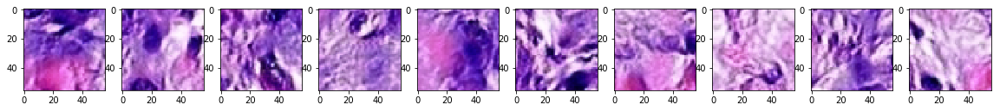

Epochs 3/5: Generator Loss: -5.7342. Discriminator Loss: -0.0942
Epochs 3/5: Generator Loss: -5.6532. Discriminator Loss: -0.1099
Epochs 3/5: Generator Loss: -4.2766. Discriminator Loss: -0.1272
Epochs 3/5: Generator Loss: 6.9137. Discriminator Loss: -0.0487
Epochs 3/5: Generator Loss: -8.3492. Discriminator Loss: -0.0126
Epochs 3/5: Generator Loss: -6.7895. Discriminator Loss: -0.0833
Epochs 3/5: Generator Loss: 2.5762. Discriminator Loss: -0.212
Epochs 3/5: Generator Loss: 4.0423. Discriminator Loss: -0.1381
Epochs 3/5: Generator Loss: -1.3649. Discriminator Loss: -0.0466
Epochs 3/5: Generator Loss: -3.9552. Discriminator Loss: -0.081


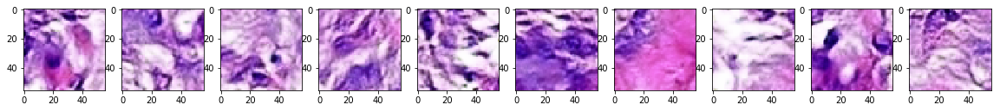

Epochs 3/5: Generator Loss: 2.0694. Discriminator Loss: -0.1579
Epochs 3/5: Generator Loss: 4.6571. Discriminator Loss: -0.1602
Epochs 3/5: Generator Loss: -0.4592. Discriminator Loss: -0.101
Epochs 3/5: Generator Loss: 0.3467. Discriminator Loss: -0.1353
Epochs 3/5: Generator Loss: 2.9868. Discriminator Loss: -0.1248
Epochs 3/5: Generator Loss: -2.4849. Discriminator Loss: -0.0322
Epochs 3/5: Generator Loss: 0.9662. Discriminator Loss: -0.1704
Epochs 3/5: Generator Loss: 6.5581. Discriminator Loss: -0.1389
Epochs 3/5: Generator Loss: -3.9162. Discriminator Loss: -0.061
Epochs 3/5: Generator Loss: -4.6529. Discriminator Loss: 0.1646


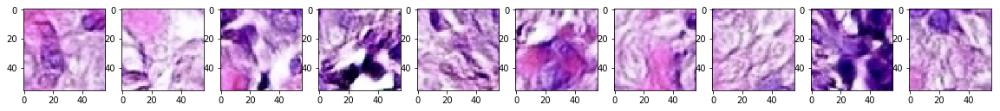

Epochs 3/5: Generator Loss: 1.0921. Discriminator Loss: -0.1424
Epochs 3/5: Generator Loss: -2.083. Discriminator Loss: 0.0842
Epochs 3/5: Generator Loss: 10.6552. Discriminator Loss: -0.1693
Epochs 3/5: Generator Loss: -4.6057. Discriminator Loss: -0.0453
Epochs 3/5: Generator Loss: -6.8209. Discriminator Loss: -0.1602
Epochs 3/5: Generator Loss: 2.1165. Discriminator Loss: -0.2146
Epochs 3/5: Generator Loss: 6.6396. Discriminator Loss: -0.2373
Epochs 3/5: Generator Loss: -4.8549. Discriminator Loss: -0.093
Epochs 3/5: Generator Loss: -5.6661. Discriminator Loss: -0.0768
Epochs 3/5: Generator Loss: 8.8559. Discriminator Loss: -0.157


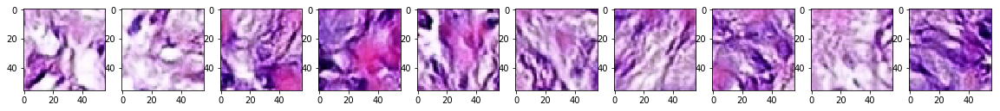

Epochs 3/5: Generator Loss: 7.8413. Discriminator Loss: -0.1358
Epochs 3/5: Generator Loss: 8.3876. Discriminator Loss: -0.0529
Epochs 3/5: Generator Loss: -16.2145. Discriminator Loss: -0.1457
Epochs 3/5: Generator Loss: -0.1359. Discriminator Loss: -0.1433
Epochs 3/5: Generator Loss: 10.3338. Discriminator Loss: -0.1971
Epochs 3/5: Generator Loss: -5.8535. Discriminator Loss: -0.1993
Epochs 3/5: Generator Loss: -5.5595. Discriminator Loss: -0.0955
Epochs 3/5: Generator Loss: -4.6911. Discriminator Loss: -0.0718
Epochs 3/5: Generator Loss: 5.3274. Discriminator Loss: -0.0738
Epochs 3/5: Generator Loss: 3.1563. Discriminator Loss: -0.0574


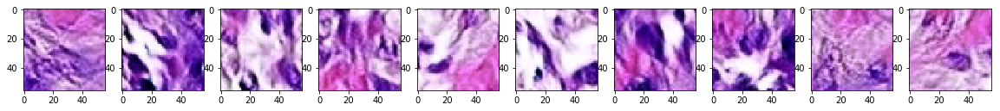

Epochs 3/5: Generator Loss: -4.642. Discriminator Loss: -0.0292
Epochs 3/5: Generator Loss: 3.4821. Discriminator Loss: -0.1182
Epochs 3/5: Generator Loss: -3.7076. Discriminator Loss: -0.107
Epochs 3/5: Generator Loss: 2.5051. Discriminator Loss: -0.0967
Epochs 3/5: Generator Loss: -1.2434. Discriminator Loss: -0.0969
Epochs 3/5: Generator Loss: 2.0684. Discriminator Loss: -0.1147
Epochs 3/5: Generator Loss: -0.2899. Discriminator Loss: -0.0306
Epochs 3/5: Generator Loss: -5.1193. Discriminator Loss: -0.1943
Epochs 3/5: Generator Loss: 7.6461. Discriminator Loss: -0.1984
Epochs 3/5: Generator Loss: -5.4324. Discriminator Loss: -0.3642


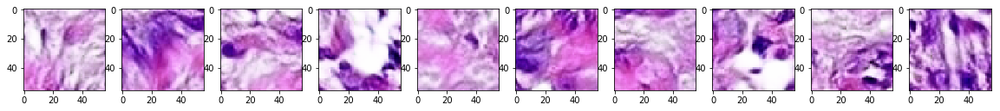

Epochs 3/5: Generator Loss: -2.8574. Discriminator Loss: 0.0279
Epochs 3/5: Generator Loss: 1.3515. Discriminator Loss: -0.1067
Epochs 3/5: Generator Loss: 3.5254. Discriminator Loss: -0.1584
Epochs 3/5: Generator Loss: 2.6568. Discriminator Loss: -0.0879
Epochs 3/5: Generator Loss: 0.3235. Discriminator Loss: -0.0215
Epochs 3/5: Generator Loss: -4.8118. Discriminator Loss: -0.0524
Epochs 3/5: Generator Loss: 2.3362. Discriminator Loss: -0.1202
Epochs 3/5: Generator Loss: 2.1722. Discriminator Loss: -0.2059
Epochs 3/5: Generator Loss: -4.3342. Discriminator Loss: -0.3162
Epochs 3/5: Generator Loss: -1.4269. Discriminator Loss: -0.2123


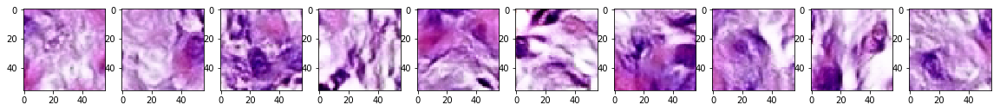

Epochs 3/5: Generator Loss: -5.0518. Discriminator Loss: -0.0847
Epochs 3/5: Generator Loss: 12.5646. Discriminator Loss: -0.0859
Epochs 3/5: Generator Loss: 6.2698. Discriminator Loss: -0.0915
Epochs 3/5: Generator Loss: -1.9387. Discriminator Loss: -0.1749
Epochs 3/5: Generator Loss: -2.1647. Discriminator Loss: -0.1786
Epochs 3/5: Generator Loss: -0.9869. Discriminator Loss: -0.0315
Epochs 3/5: Generator Loss: 4.3724. Discriminator Loss: -0.1163
Epochs 3/5: Generator Loss: 1.8637. Discriminator Loss: -0.1528
Epochs 3/5: Generator Loss: -6.7583. Discriminator Loss: -0.1069
Epochs 3/5: Generator Loss: -4.0069. Discriminator Loss: -0.0934


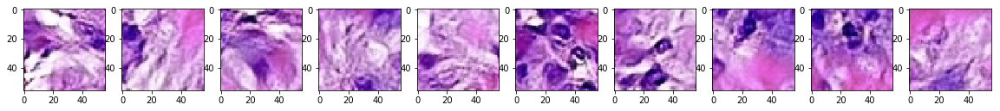

Epochs 3/5: Generator Loss: -0.5297. Discriminator Loss: 0.007
Epochs 3/5: Generator Loss: 4.0965. Discriminator Loss: -0.1285
Epochs 3/5: Generator Loss: 5.5912. Discriminator Loss: -0.122
Epochs 3/5: Generator Loss: 3.7228. Discriminator Loss: -0.0572
Epochs 3/5: Generator Loss: -1.6089. Discriminator Loss: -0.1633
Epochs 3/5: Generator Loss: -2.1624. Discriminator Loss: -0.1099
Epochs 3/5: Generator Loss: -6.0948. Discriminator Loss: -0.0812
Epochs 3/5: Generator Loss: 3.0582. Discriminator Loss: -0.1228
Epochs 3/5: Generator Loss: 0.9203. Discriminator Loss: -0.1349
Epochs 3/5: Generator Loss: -1.313. Discriminator Loss: -0.0796


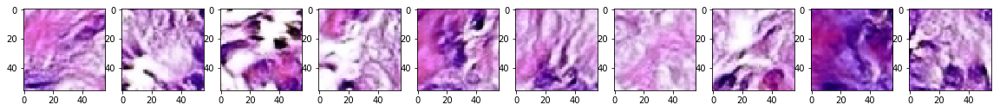

Epochs 3/5: Generator Loss: 3.4978. Discriminator Loss: -0.0688
Epochs 3/5: Generator Loss: 3.9335. Discriminator Loss: -0.1286
Epochs 3/5: Generator Loss: -12.1904. Discriminator Loss: -0.1379
Epochs 3/5: Generator Loss: -0.7765. Discriminator Loss: -0.1876
Epochs 3/5: Generator Loss: 5.6772. Discriminator Loss: -0.1089
Epochs 3/5: Generator Loss: -0.5396. Discriminator Loss: -0.1046
Epochs 3/5: Generator Loss: 2.2834. Discriminator Loss: -0.0983
Epochs 3/5: Generator Loss: -7.6204. Discriminator Loss: -0.0809
Epochs 3/5: Generator Loss: -4.2559. Discriminator Loss: -0.0542
Epochs 3/5: Generator Loss: 8.5001. Discriminator Loss: -0.1588


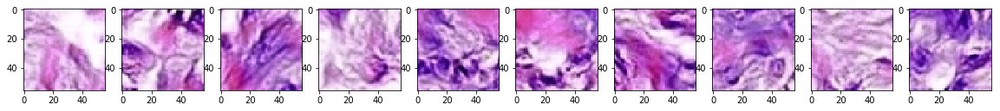

Epochs 3/5: Generator Loss: 0.8213. Discriminator Loss: -0.2195
Epochs 3/5: Generator Loss: -3.5881. Discriminator Loss: 0.0297
Epochs 3/5: Generator Loss: -5.7851. Discriminator Loss: -0.0704
Epochs 3/5: Generator Loss: -4.887. Discriminator Loss: -0.0582
Epochs 3/5: Generator Loss: 9.2813. Discriminator Loss: -0.1411
Epochs 3/5: Generator Loss: 1.0142. Discriminator Loss: -0.0877
Epochs 3/5: Generator Loss: -3.3133. Discriminator Loss: -0.0614
Epochs 3/5: Generator Loss: -1.9502. Discriminator Loss: -0.0815
Epochs 3/5: Generator Loss: 0.6196. Discriminator Loss: -0.1332
Epochs 3/5: Generator Loss: -0.7925. Discriminator Loss: -0.2908


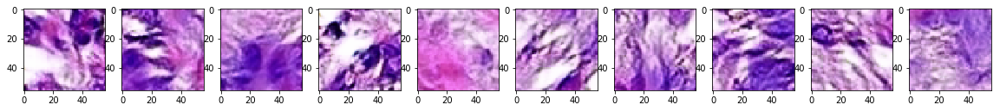

Epochs 3/5: Generator Loss: -2.9166. Discriminator Loss: -0.2408
Epochs 3/5: Generator Loss: 2.8138. Discriminator Loss: -0.1395
Epochs 3/5: Generator Loss: 4.4327. Discriminator Loss: -0.1394
Epochs 3/5: Generator Loss: -9.9265. Discriminator Loss: -0.231
Epochs 3/5: Generator Loss: -2.8798. Discriminator Loss: -0.0472
Epochs 3/5: Generator Loss: 0.4483. Discriminator Loss: -0.1175
Epochs 3/5: Generator Loss: 0.9268. Discriminator Loss: -0.1043
Epochs 3/5: Generator Loss: 5.0369. Discriminator Loss: -0.2515
Epochs 3/5: Generator Loss: 1.7096. Discriminator Loss: -0.1378
Epochs 3/5: Generator Loss: 8.9175. Discriminator Loss: -0.3185


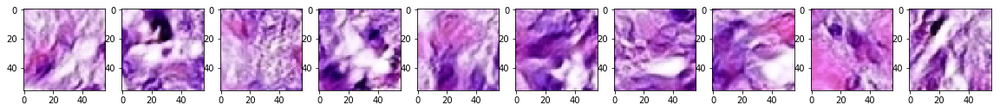

Epochs 3/5: Generator Loss: -10.0286. Discriminator Loss: -0.0887
Epochs 3/5: Generator Loss: 5.4593. Discriminator Loss: -0.1052
Epochs 3/5: Generator Loss: 0.7371. Discriminator Loss: -0.1231
Epochs 3/5: Generator Loss: 5.8749. Discriminator Loss: -0.1375
Epochs 3/5: Generator Loss: 2.0116. Discriminator Loss: -0.1306
Epochs 3/5: Generator Loss: -4.5599. Discriminator Loss: -0.1219
Epochs 3/5: Generator Loss: -1.424. Discriminator Loss: -0.1497
Epochs 3/5: Generator Loss: 0.2656. Discriminator Loss: -0.0628
Epochs 3/5: Generator Loss: 8.6611. Discriminator Loss: -0.044
Epochs 3/5: Generator Loss: 9.5702. Discriminator Loss: -0.144


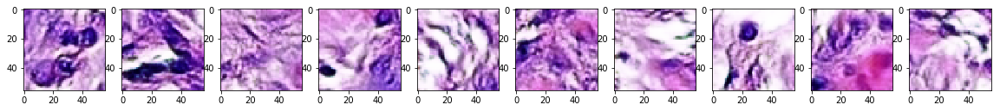

Epochs 3/5: Generator Loss: -15.9526. Discriminator Loss: -0.0665
Epochs 3/5: Generator Loss: -6.3054. Discriminator Loss: -0.0681
Epochs 3/5: Generator Loss: 9.1999. Discriminator Loss: -0.1326
Epochs 3/5: Generator Loss: 5.778. Discriminator Loss: -0.0796
Epochs 3/5: Generator Loss: -9.9149. Discriminator Loss: -0.0849
Epochs 3/5: Generator Loss: -3.1588. Discriminator Loss: -0.1951
Epochs 3/5: Generator Loss: 6.6469. Discriminator Loss: -0.2923
Epochs 3/5: Generator Loss: -2.517. Discriminator Loss: -0.0868
Epochs 3/5: Generator Loss: -3.212. Discriminator Loss: -0.0941
Epochs 3/5: Generator Loss: 2.0907. Discriminator Loss: -0.1218


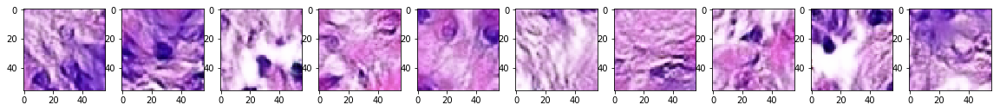

Epochs 3/5: Generator Loss: 1.4499. Discriminator Loss: -0.0501
Epochs 3/5: Generator Loss: -4.2929. Discriminator Loss: -0.0624
Epochs 3/5: Generator Loss: -6.0915. Discriminator Loss: -0.0348
Epochs 3/5: Generator Loss: 8.9628. Discriminator Loss: 0.0119
Epochs 3/5: Generator Loss: 6.2444. Discriminator Loss: -0.1081
Epochs 3/5: Generator Loss: 9.9932. Discriminator Loss: -0.1193
Epochs 3/5: Generator Loss: -12.5558. Discriminator Loss: -0.0836
Epochs 3/5: Generator Loss: -8.8207. Discriminator Loss: -0.1051
Epochs 3/5: Generator Loss: 6.3502. Discriminator Loss: -0.0859
Epochs 3/5: Generator Loss: 0.0127. Discriminator Loss: -0.1047


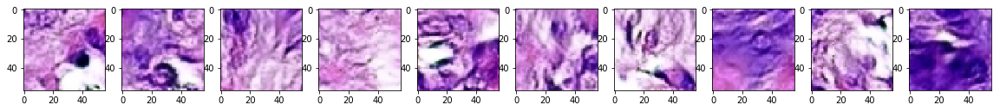

Epochs 3/5: Generator Loss: 4.3598. Discriminator Loss: -0.2369
Epochs 3/5: Generator Loss: -3.6814. Discriminator Loss: 0.0331
Epochs 3/5: Generator Loss: -1.6. Discriminator Loss: -0.0717
Epochs 3/5: Generator Loss: 1.3962. Discriminator Loss: -0.0671
Epochs 3/5: Generator Loss: -8.9451. Discriminator Loss: -0.1295
Epochs 3/5: Generator Loss: 0.2274. Discriminator Loss: -0.1025
Epochs 3/5: Generator Loss: 6.4768. Discriminator Loss: -0.1325
Epochs 3/5: Generator Loss: 1.6563. Discriminator Loss: -0.1404
Epochs 3/5: Generator Loss: -5.5628. Discriminator Loss: -0.1356
Epochs 3/5: Generator Loss: -3.2755. Discriminator Loss: -0.0126


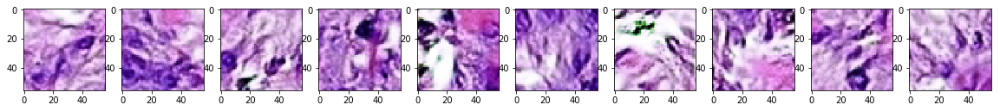

Epochs 3/5: Generator Loss: 6.4546. Discriminator Loss: -0.0525
Epochs 3/5: Generator Loss: 4.123. Discriminator Loss: -0.1161
Epochs 3/5: Generator Loss: 0.2369. Discriminator Loss: -0.192
Epochs 3/5: Generator Loss: 0.054. Discriminator Loss: -0.174
Epochs 3/5: Generator Loss: -2.0082. Discriminator Loss: -0.1586
Epochs 3/5: Generator Loss: 1.3638. Discriminator Loss: -0.1004
Epochs 3/5: Generator Loss: 5.9714. Discriminator Loss: -0.1211
Epochs 3/5: Generator Loss: 16.5118. Discriminator Loss: -0.1763
Epochs 3/5: Generator Loss: -15.8704. Discriminator Loss: -0.1345
Epochs 3/5: Generator Loss: 1.1946. Discriminator Loss: -0.1684


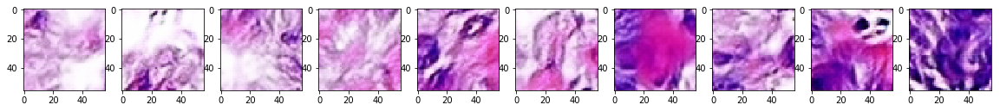

Epochs 3/5: Generator Loss: -1.1736. Discriminator Loss: -0.1292
Epochs 3/5: Generator Loss: 5.5803. Discriminator Loss: -0.0729
Epochs 3/5: Generator Loss: 0.1013. Discriminator Loss: -0.1399
Epochs 3/5: Generator Loss: -2.1695. Discriminator Loss: -0.0043
Epochs 3/5: Generator Loss: 8.5904. Discriminator Loss: -0.2734
Epochs 3/5: Generator Loss: -9.6498. Discriminator Loss: -0.0696
Epochs 3/5: Generator Loss: -6.0813. Discriminator Loss: -0.1608
Epochs 3/5: Generator Loss: -1.0281. Discriminator Loss: -0.0843
Epochs 3/5: Generator Loss: 5.5181. Discriminator Loss: -0.0992
Epochs 3/5: Generator Loss: 7.0106. Discriminator Loss: -0.0521


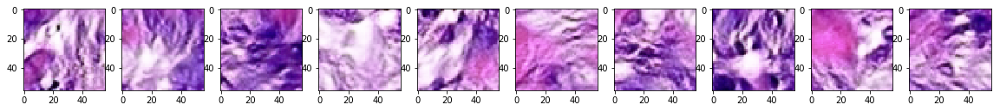

Epochs 3/5: Generator Loss: -2.3859. Discriminator Loss: -0.1151
Epochs 3/5: Generator Loss: -10.0926. Discriminator Loss: -0.1078
Epochs 3/5: Generator Loss: 0.3041. Discriminator Loss: -0.1333
Epochs 3/5: Generator Loss: 3.9696. Discriminator Loss: -0.1988
Epochs 3/5: Generator Loss: 1.7282. Discriminator Loss: -0.1953
Epochs 3/5: Generator Loss: -2.6784. Discriminator Loss: -0.0939
Epochs 3/5: Generator Loss: -3.0433. Discriminator Loss: -0.0574
Epochs 3/5: Generator Loss: -0.3547. Discriminator Loss: -0.0757
Epochs 3/5: Generator Loss: 2.9652. Discriminator Loss: -0.1306
Epochs 3/5: Generator Loss: -0.2488. Discriminator Loss: -0.0983


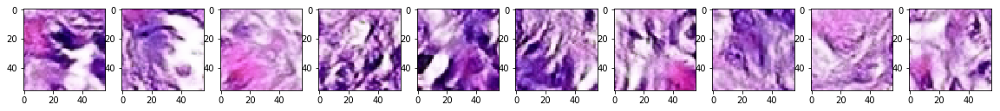

Epochs 3/5: Generator Loss: -1.7261. Discriminator Loss: -0.1695
Epochs 3/5: Generator Loss: 7.3484. Discriminator Loss: -0.1012
Epochs 3/5: Generator Loss: 3.2477. Discriminator Loss: -0.0779
Epochs 3/5: Generator Loss: 12.7168. Discriminator Loss: -0.1443
Epochs 3/5: Generator Loss: -4.1098. Discriminator Loss: -0.0593
Epochs 3/5: Generator Loss: -1.1821. Discriminator Loss: -0.0459
Epochs 3/5: Generator Loss: 4.7932. Discriminator Loss: -0.0151
Epochs 3/5: Generator Loss: -1.2944. Discriminator Loss: -0.047
Epochs 3/5: Generator Loss: -7.6981. Discriminator Loss: -0.1498
Epochs 3/5: Generator Loss: -0.7041. Discriminator Loss: -0.0531


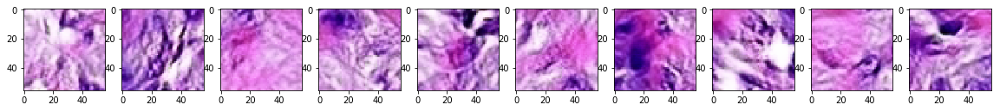

Epochs 3/5: Generator Loss: 3.828. Discriminator Loss: -0.0895
Epochs 3/5: Generator Loss: -0.8905. Discriminator Loss: -0.1619
Epochs 3/5: Generator Loss: -4.726. Discriminator Loss: -0.057
Epochs 3/5: Generator Loss: 4.7481. Discriminator Loss: -0.0833
Epochs 3/5: Generator Loss: 3.4895. Discriminator Loss: -0.3756
Epochs 3/5: Generator Loss: 1.1136. Discriminator Loss: -0.0908
Epochs 3/5: Generator Loss: -11.3195. Discriminator Loss: -0.0548
Epochs 3/5: Generator Loss: 3.4279. Discriminator Loss: -0.0468
Epochs 3/5: Generator Loss: 4.9168. Discriminator Loss: -0.1063
Epochs 3/5: Generator Loss: 8.8447. Discriminator Loss: -0.0223


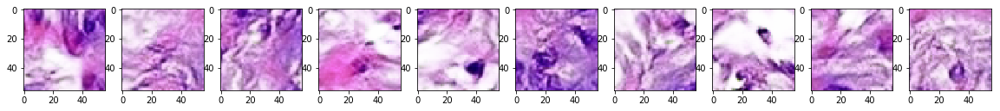

Epochs 3/5: Generator Loss: -1.6541. Discriminator Loss: -0.0778
Epochs 3/5: Generator Loss: 1.7262. Discriminator Loss: -0.0195
Epochs 3/5: Generator Loss: -6.998. Discriminator Loss: -0.0942
Epochs 3/5: Generator Loss: 2.0786. Discriminator Loss: -0.1903
Epochs 3/5: Generator Loss: 2.0327. Discriminator Loss: -0.1202
Epochs 3/5: Generator Loss: 1.8063. Discriminator Loss: -0.0188
Epochs 3/5: Generator Loss: 4.0628. Discriminator Loss: -0.0459
Epochs 3/5: Generator Loss: -6.1052. Discriminator Loss: -0.1345
Epochs 3/5: Generator Loss: -9.6092. Discriminator Loss: -0.1432
Epochs 3/5: Generator Loss: 8.7573. Discriminator Loss: -0.1741


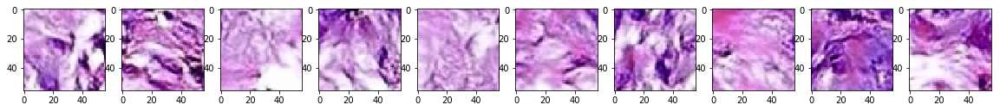

Epochs 3/5: Generator Loss: 13.7023. Discriminator Loss: -0.1395
Epochs 3/5: Generator Loss: -6.4695. Discriminator Loss: -0.1093
Epochs 3/5: Generator Loss: 0.8623. Discriminator Loss: -0.0955
Epochs 3/5: Generator Loss: 10.3442. Discriminator Loss: -0.0615
Epochs 3/5: Generator Loss: -3.3439. Discriminator Loss: -0.068
Epochs 3/5: Generator Loss: -3.3153. Discriminator Loss: -0.0499
Epochs 3/5: Generator Loss: 4.9647. Discriminator Loss: -0.0366
Epochs 3/5: Generator Loss: -5.3789. Discriminator Loss: 0.0693
Epochs 3/5: Generator Loss: -0.8331. Discriminator Loss: -0.1262
Epochs 3/5: Generator Loss: 1.8897. Discriminator Loss: -0.0851


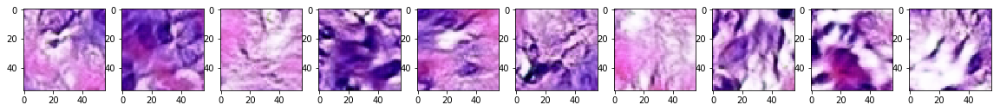

Epochs 3/5: Generator Loss: -2.0159. Discriminator Loss: -0.1831
Epochs 3/5: Generator Loss: 2.8577. Discriminator Loss: -0.0823
Epochs 3/5: Generator Loss: 8.5027. Discriminator Loss: -0.057
Epochs 3/5: Generator Loss: 0.9664. Discriminator Loss: -0.1443
Epochs 3/5: Generator Loss: -6.6879. Discriminator Loss: -0.2811
Epochs 3/5: Generator Loss: 6.4133. Discriminator Loss: -0.1393
Epochs 3/5: Generator Loss: 0.3107. Discriminator Loss: -0.1029
Epochs 3/5: Generator Loss: -10.3205. Discriminator Loss: -0.1025
Epochs 3/5: Generator Loss: 14.0498. Discriminator Loss: -0.1893
Epochs 3/5: Generator Loss: 7.1146. Discriminator Loss: -0.0289


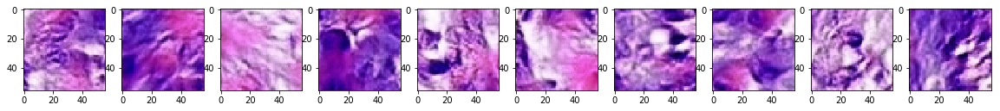

Epochs 3/5: Generator Loss: -3.2654. Discriminator Loss: -0.0623
Epochs 3/5: Generator Loss: -10.4381. Discriminator Loss: -0.1186
Epochs 3/5: Generator Loss: 0.4946. Discriminator Loss: -0.0543
Epochs 3/5: Generator Loss: 10.3626. Discriminator Loss: -0.0647
Epochs 3/5: Generator Loss: 9.0741. Discriminator Loss: -0.063
Epochs 3/5: Generator Loss: -7.1981. Discriminator Loss: -0.1386
Epochs 3/5: Generator Loss: 1.8575. Discriminator Loss: -0.2757
Epochs 3/5: Generator Loss: -5.8933. Discriminator Loss: -0.0791
Epochs 3/5: Generator Loss: -4.2846. Discriminator Loss: 0.1344
Epochs 3/5: Generator Loss: -15.0791. Discriminator Loss: -0.1943


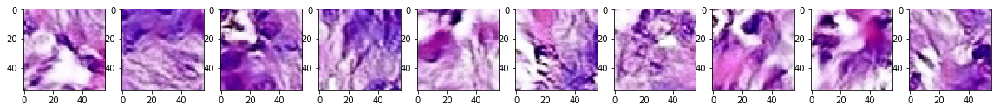

Epochs 3/5: Generator Loss: 21.2852. Discriminator Loss: -0.0592
Epochs 3/5: Generator Loss: 5.0423. Discriminator Loss: -0.0674
Epochs 3/5: Generator Loss: 2.5881. Discriminator Loss: -0.2841
Epochs 3/5: Generator Loss: -6.4043. Discriminator Loss: -0.1378
Epochs 3/5: Generator Loss: 2.3452. Discriminator Loss: -0.0665
Epochs 3/5: Generator Loss: 7.7101. Discriminator Loss: -0.1647
Epochs 3/5: Generator Loss: 1.7745. Discriminator Loss: -0.1565
Epochs 3/5: Generator Loss: -14.8948. Discriminator Loss: -0.0989
Epochs 3/5: Generator Loss: -5.2206. Discriminator Loss: -0.0624
Epochs 3/5: Generator Loss: 3.4454. Discriminator Loss: -0.0487


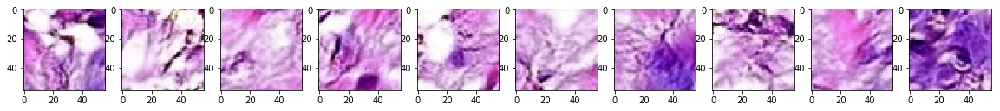

Epochs 3/5: Generator Loss: -3.1518. Discriminator Loss: -0.0789
Epochs 3/5: Generator Loss: 10.9562. Discriminator Loss: -0.1564
Epochs 3/5: Generator Loss: -15.3088. Discriminator Loss: -0.189
Epochs 3/5: Generator Loss: -6.9318. Discriminator Loss: -0.1589
Epochs 3/5: Generator Loss: -1.0537. Discriminator Loss: -0.0649
Epochs 3/5: Generator Loss: 2.5961. Discriminator Loss: 0.1169
Epochs 3/5: Generator Loss: 0.7604. Discriminator Loss: -0.0901
Epochs 3/5: Generator Loss: 4.1375. Discriminator Loss: -0.0625
Epochs 3/5: Generator Loss: 1.0017. Discriminator Loss: -0.1398
Epochs 3/5: Generator Loss: -4.0495. Discriminator Loss: -0.0866


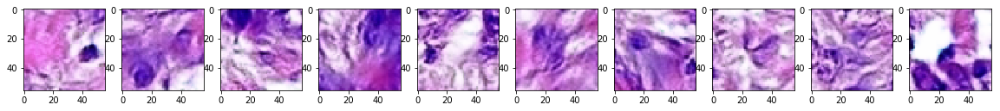

Epochs 3/5: Generator Loss: -8.3862. Discriminator Loss: -0.4288
Epochs 3/5: Generator Loss: 7.3247. Discriminator Loss: -0.1841
Epochs 3/5: Generator Loss: 3.7527. Discriminator Loss: -0.128
Epochs 3/5: Generator Loss: 2.0272. Discriminator Loss: -0.0825
Epochs 3/5: Generator Loss: 4.2499. Discriminator Loss: -0.0642
Epochs 3/5: Generator Loss: -14.6082. Discriminator Loss: -0.1989
Epochs 3/5: Generator Loss: 12.7058. Discriminator Loss: -0.1277
Epochs 3/5: Generator Loss: 4.9416. Discriminator Loss: -0.1077
Epochs 3/5: Generator Loss: -3.7847. Discriminator Loss: -0.1147
Epochs 3/5: Generator Loss: 5.9602. Discriminator Loss: -0.1135


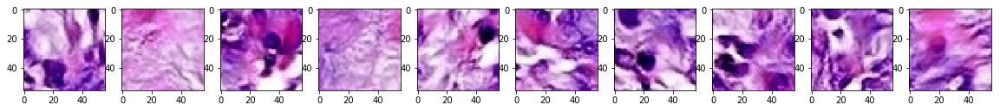

Epochs 3/5: Generator Loss: 3.1681. Discriminator Loss: -0.1813
Epochs 3/5: Generator Loss: -1.655. Discriminator Loss: -0.1569
Epochs 3/5: Generator Loss: -8.1006. Discriminator Loss: -0.1731
Epochs 3/5: Generator Loss: 4.3616. Discriminator Loss: -0.2003
Epochs 3/5: Generator Loss: 16.4915. Discriminator Loss: -0.0864
Epochs 3/5: Generator Loss: -8.5946. Discriminator Loss: 0.0745
Epochs 3/5: Generator Loss: 1.7562. Discriminator Loss: -0.0418
Epochs 3/5: Generator Loss: 5.9869. Discriminator Loss: -0.1225
Epochs 3/5: Generator Loss: 0.8448. Discriminator Loss: -0.1072
Epochs 3/5: Generator Loss: -9.3511. Discriminator Loss: -0.0813


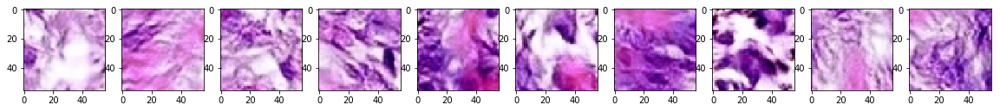

Epochs 3/5: Generator Loss: -4.9201. Discriminator Loss: -0.1824
Epochs 3/5: Generator Loss: 5.6362. Discriminator Loss: -0.0399
Epochs 3/5: Generator Loss: -4.8702. Discriminator Loss: -0.1225
Epochs 3/5: Generator Loss: 8.2167. Discriminator Loss: -0.1522
Epochs 3/5: Generator Loss: 4.5155. Discriminator Loss: -0.0792
Epochs 3/5: Generator Loss: 0.3041. Discriminator Loss: -0.1523
Epochs 3/5: Generator Loss: -1.1539. Discriminator Loss: -0.0882
Epochs 3/5: Generator Loss: 9.2852. Discriminator Loss: -0.2971
Epochs 3/5: Generator Loss: 0.0504. Discriminator Loss: 0.0176
Epochs 3/5: Generator Loss: -13.1649. Discriminator Loss: -0.0956


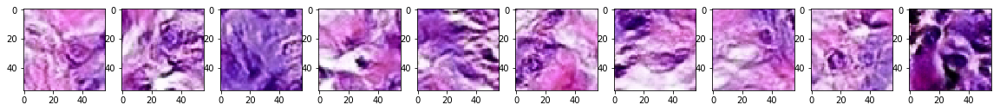

Epochs 3/5: Generator Loss: 2.8707. Discriminator Loss: -0.2576
Epochs 3/5: Generator Loss: 13.0223. Discriminator Loss: -0.1434
Epochs 3/5: Generator Loss: -1.2639. Discriminator Loss: -0.0787
Epochs 3/5: Generator Loss: -7.0358. Discriminator Loss: -0.0718
Epochs 3/5: Generator Loss: -6.8817. Discriminator Loss: -0.0979
Epochs 3/5: Generator Loss: 2.1923. Discriminator Loss: -0.1935
Epochs 3/5: Generator Loss: 5.5109. Discriminator Loss: -0.1232
Epochs 3/5: Generator Loss: 3.7074. Discriminator Loss: -0.0557
Epochs 3/5: Generator Loss: 3.0217. Discriminator Loss: -0.1469
Epochs 3/5: Generator Loss: -10.0918. Discriminator Loss: -0.2005


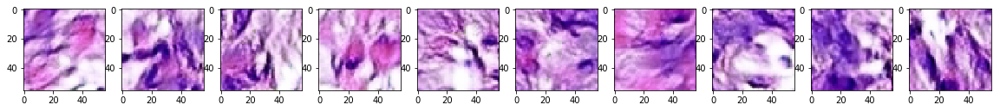

Epochs 3/5: Generator Loss: 1.1655. Discriminator Loss: -0.0147
Epochs 3/5: Generator Loss: 6.3086. Discriminator Loss: -0.0735
Epochs 3/5: Generator Loss: -1.9845. Discriminator Loss: -0.2226
Epochs 3/5: Generator Loss: 0.751. Discriminator Loss: -0.1175
Epochs 3/5: Generator Loss: -1.7308. Discriminator Loss: -0.0975
Epochs 3/5: Generator Loss: 3.1255. Discriminator Loss: -0.2227
Epochs 3/5: Generator Loss: 3.3089. Discriminator Loss: -0.1179
Epochs 3/5: Generator Loss: 0.0194. Discriminator Loss: -0.1157
Epochs 3/5: Generator Loss: 2.0668. Discriminator Loss: -0.1227
Epochs 3/5: Generator Loss: 0.7455. Discriminator Loss: -0.0355


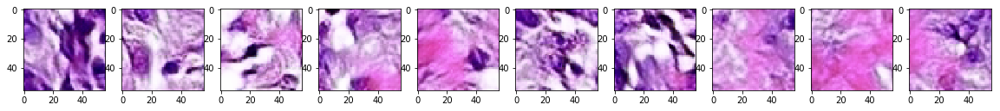

Epochs 3/5: Generator Loss: -7.2584. Discriminator Loss: -0.0795
Epochs 3/5: Generator Loss: 0.6374. Discriminator Loss: -0.1898
Epochs 3/5: Generator Loss: 6.6104. Discriminator Loss: -0.1272
Epochs 3/5: Generator Loss: 3.0904. Discriminator Loss: -0.1151
Epochs 3/5: Generator Loss: -9.3443. Discriminator Loss: -0.1412
Epochs 3/5: Generator Loss: -11.1835. Discriminator Loss: -0.0804
Epochs 3/5: Generator Loss: 1.7808. Discriminator Loss: 0.0997
Epochs 3/5: Generator Loss: 2.8169. Discriminator Loss: -0.1042
Epochs 3/5: Generator Loss: -4.3832. Discriminator Loss: -0.1185
Epochs 3/5: Generator Loss: 1.0368. Discriminator Loss: -0.1279


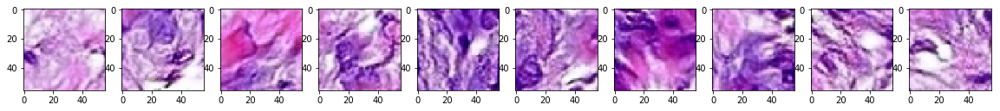

Epochs 3/5: Generator Loss: -1.9137. Discriminator Loss: -0.1258
Epochs 3/5: Generator Loss: 3.5604. Discriminator Loss: -0.135
Epochs 3/5: Generator Loss: 5.1169. Discriminator Loss: -0.1049
Epochs 3/5: Generator Loss: 7.5197. Discriminator Loss: -0.1175
Epochs 3/5: Generator Loss: -4.8111. Discriminator Loss: -0.1315
Epochs 3/5: Generator Loss: -0.1758. Discriminator Loss: -0.1298
Epochs 3/5: Generator Loss: 6.4035. Discriminator Loss: -0.0
Epochs 3/5: Generator Loss: -1.1992. Discriminator Loss: -0.0657
Epochs 3/5: Generator Loss: -4.7335. Discriminator Loss: -0.0735
Epochs 3/5: Generator Loss: -3.4706. Discriminator Loss: -0.0856


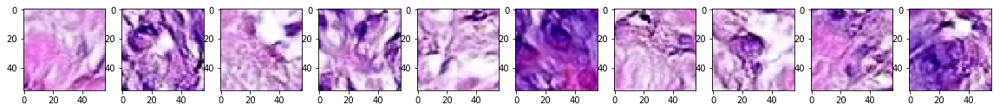

Epochs 3/5: Generator Loss: -1.6792. Discriminator Loss: -0.1209
Epochs 3/5: Generator Loss: -1.0889. Discriminator Loss: -0.1145
Epochs 3/5: Generator Loss: 6.9201. Discriminator Loss: -0.0246
Epochs 3/5: Generator Loss: 1.0024. Discriminator Loss: -0.1564
Epochs 3/5: Generator Loss: 1.0312. Discriminator Loss: -0.2388
Epochs 3/5: Generator Loss: 6.3414. Discriminator Loss: -0.1043
Epochs 3/5: Generator Loss: -17.1917. Discriminator Loss: -0.3186
Epochs 3/5: Generator Loss: -6.3854. Discriminator Loss: -0.0279
Epochs 3/5: Generator Loss: 10.494. Discriminator Loss: -0.3716
Epochs 3/5: Generator Loss: 13.0311. Discriminator Loss: -0.1313


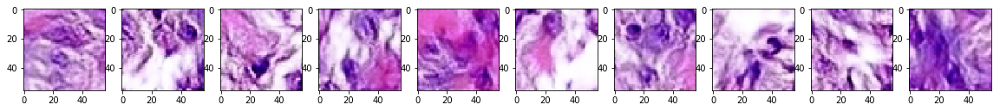

Epochs 3/5: Generator Loss: -3.5186. Discriminator Loss: -0.0092
Epochs 3/5: Generator Loss: -3.6627. Discriminator Loss: -0.0968
Epochs 3/5: Generator Loss: -3.5606. Discriminator Loss: -0.1658
Epochs 3/5: Generator Loss: 9.6346. Discriminator Loss: -0.0224
Epochs 3/5: Generator Loss: 9.0823. Discriminator Loss: -0.2042
Epochs 3/5: Generator Loss: -21.4567. Discriminator Loss: -0.2891
Epochs 3/5: Generator Loss: 5.2179. Discriminator Loss: -0.2179
Epochs 3/5: Generator Loss: 3.2129. Discriminator Loss: -0.0514
Epochs 3/5: Generator Loss: -2.9597. Discriminator Loss: -0.0625
Epochs 3/5: Generator Loss: 9.0218. Discriminator Loss: -0.1798


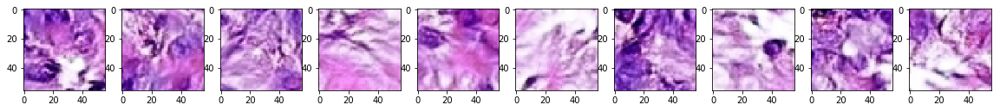

Epochs 3/5: Generator Loss: -14.0198. Discriminator Loss: -0.0631
Epochs 3/5: Generator Loss: 14.6546. Discriminator Loss: -0.0345
Epochs 3/5: Generator Loss: 3.7464. Discriminator Loss: -0.0696
Epochs 3/5: Generator Loss: 4.2496. Discriminator Loss: -0.0718
Epochs 3/5: Generator Loss: 6.5738. Discriminator Loss: -0.1302
Epochs 3/5: Generator Loss: -0.7222. Discriminator Loss: -0.0728
Epochs 3/5: Generator Loss: 2.3575. Discriminator Loss: -0.0483
Epochs 3/5: Generator Loss: -1.9536. Discriminator Loss: -0.1145
Epochs 3/5: Generator Loss: -2.4549. Discriminator Loss: -0.1004
Epochs 3/5: Generator Loss: 10.0586. Discriminator Loss: -0.1313


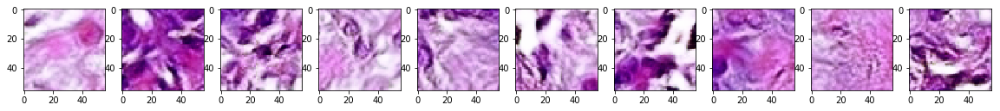

Epochs 3/5: Generator Loss: 0.7405. Discriminator Loss: -0.097
Epochs 3/5: Generator Loss: -2.1987. Discriminator Loss: -0.1357
Epochs 3/5: Generator Loss: 0.9104. Discriminator Loss: -0.3734
Epochs 3/5: Generator Loss: 3.3088. Discriminator Loss: 0.0094
Epochs 3/5: Generator Loss: 8.1762. Discriminator Loss: -0.166
Epochs 3/5: Generator Loss: -18.0412. Discriminator Loss: -0.1262
Epochs 3/5: Generator Loss: -5.4143. Discriminator Loss: -0.0661
Epochs 3/5: Generator Loss: 6.6198. Discriminator Loss: -0.1458
Epochs 3/5: Generator Loss: -6.752. Discriminator Loss: -0.0911
Epochs 3/5: Generator Loss: -5.6612. Discriminator Loss: -0.041


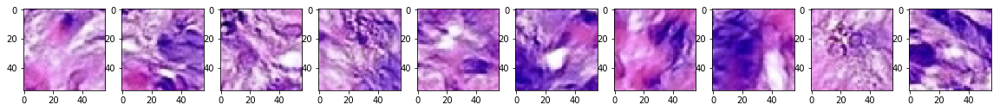

Epochs 3/5: Generator Loss: 0.3347. Discriminator Loss: -0.1274
Epochs 3/5: Generator Loss: 4.833. Discriminator Loss: -0.1173
Epochs 3/5: Generator Loss: 0.4532. Discriminator Loss: -0.1106
Epochs 3/5: Generator Loss: -7.6481. Discriminator Loss: -0.06
Epochs 3/5: Generator Loss: -4.6962. Discriminator Loss: -0.1261
Epochs 3/5: Generator Loss: 12.0299. Discriminator Loss: -0.1569
Epochs 3/5: Generator Loss: 0.9196. Discriminator Loss: -0.1075
Epochs 3/5: Generator Loss: -10.6334. Discriminator Loss: -0.2705
Epochs 3/5: Generator Loss: -2.9821. Discriminator Loss: -0.1837
Epochs 3/5: Generator Loss: 12.4669. Discriminator Loss: -0.149


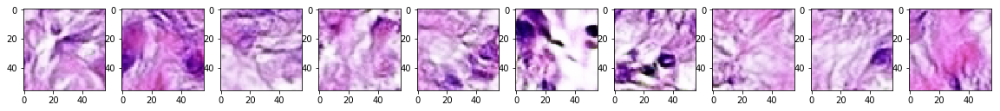

Epochs 3/5: Generator Loss: -1.7551. Discriminator Loss: -0.0998
Epochs 3/5: Generator Loss: -4.0747. Discriminator Loss: -0.0492
Epochs 3/5: Generator Loss: -5.2301. Discriminator Loss: -0.0435
Epochs 3/5: Generator Loss: -0.8916. Discriminator Loss: -0.242
Epochs 3/5: Generator Loss: 10.7914. Discriminator Loss: -0.197
Epochs 3/5: Generator Loss: -10.3264. Discriminator Loss: -0.1392
Epochs 3/5: Generator Loss: -6.5445. Discriminator Loss: -0.1066
Epochs 3/5: Generator Loss: 8.0786. Discriminator Loss: -0.0998
Epochs 3/5: Generator Loss: 9.3909. Discriminator Loss: -0.161
Epochs 3/5: Generator Loss: 1.7485. Discriminator Loss: -0.1319


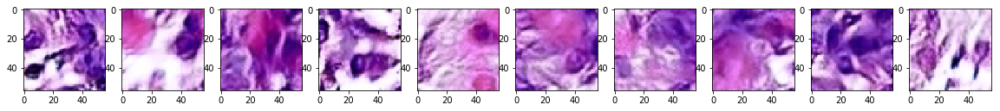

Epochs 3/5: Generator Loss: -2.9097. Discriminator Loss: -0.12
Epochs 3/5: Generator Loss: 6.8311. Discriminator Loss: -0.1144
Epochs 3/5: Generator Loss: -13.9141. Discriminator Loss: -0.1983
Epochs 3/5: Generator Loss: 12.9076. Discriminator Loss: -0.119
Epochs 3/5: Generator Loss: -3.2497. Discriminator Loss: -0.121
Epochs 3/5: Generator Loss: -4.1109. Discriminator Loss: -0.13
Epochs 3/5: Generator Loss: 2.3029. Discriminator Loss: -0.1061
Epochs 3/5: Generator Loss: 1.2412. Discriminator Loss: -0.1511
Epochs 3/5: Generator Loss: 4.3992. Discriminator Loss: -0.1183
Epochs 3/5: Generator Loss: 1.6154. Discriminator Loss: -0.1211


KeyboardInterrupt: 

In [15]:
main_path = '/Users/adalbertoclaudioquiros/Documents/Code/UofG/PhD/Cancer_TMA_Generative/data model output/WGAN-GP/'
 
# Dataset information.
image_width = 56
image_height = 56
image_channels = 3
dataset='nki'
marker='he'
name_run = 'h%s_w%s_n%s' % (image_height, image_width, image_channels)
data_out_path = '%s/%s' % (main_path, name_run)


# Hyperparameters.
epochs = 5
batch_size = 64
z_dim = 100
learning_rate = 1e-4
alpha = 0.2
beta_1 = 0.5
beta_2 = 0.9

# WGAN specific parameters
# Gradient clipping value and number of updates in critic per generator.
n_critic = 5
gp_coeff = .5
use_bn = False


global losses 
global samples
data = Data(dataset, marker, image_height, image_width, image_channels, batch_size)

with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, data, alpha, image_width, image_height, image_channels, data_out_path, beta_1, beta_2, n_critic, gp_coeff, use_bn)

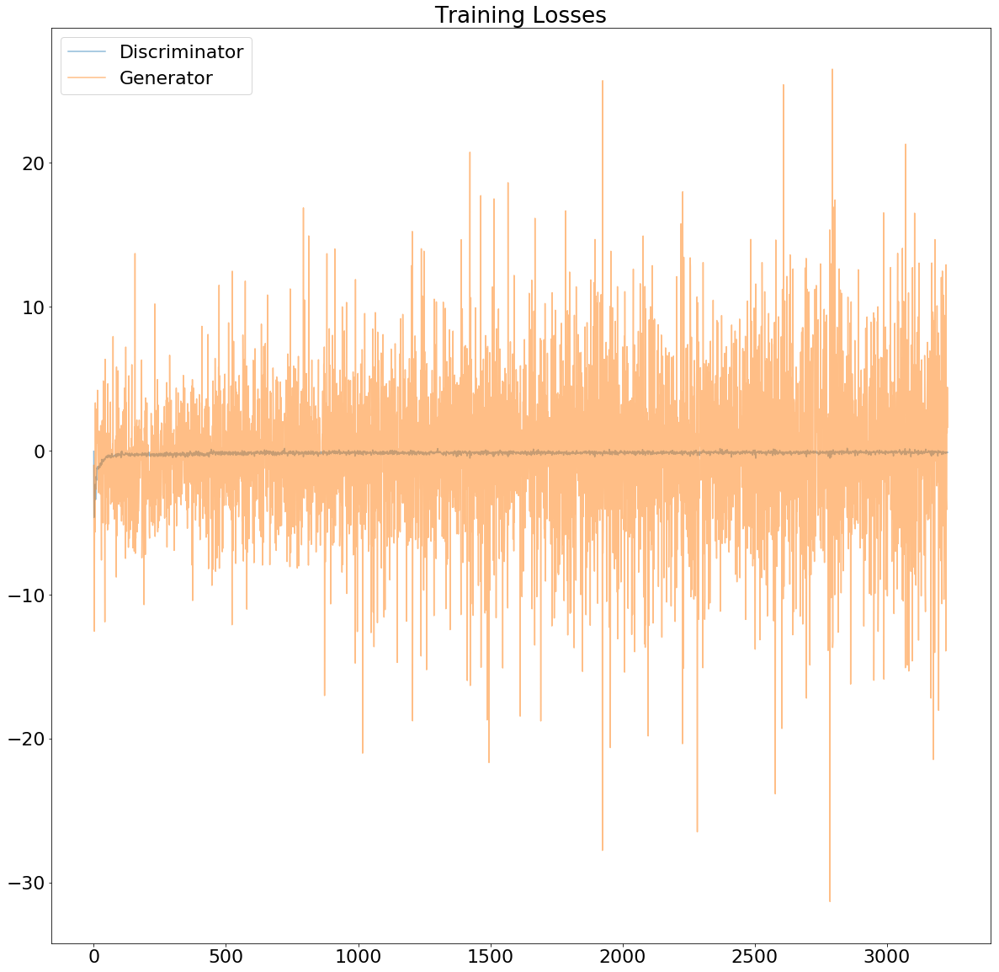

In [16]:
save_loss(losses, data_out_path, dim=20)